### Monkey Goose all data: 1st series, 1st and 2nd series (below)

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
from torch import nn
import torch.nn.functional as F
from scipy.io import loadmat
import os
from os import listdir
import pandas as pd
from skimage import io
from PIL import Image
from sklearn.metrics import confusion_matrix
import seaborn as sn
import pickle
import pdb

from utils import *

## Goose 1st series only

In [3]:
CH = 23
device = torch.device('cuda')
val_dates = ['180327','180329']
test_dates = ['180330','180331']
bad_dates = ['180326', '180328', '171019', '180715', '180716', '180717']
load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/'
save_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/Goose_ANN_models'
model_name = 'MLP_1_ch_Drop_03'


train_files, val_files, test_files = create_files(load_path, val_dates, test_dates, bad_dates)
train_loader, val_loader, test_loader = create_dataloaders(train_files, val_files, test_files, load_path, batch_size=256,CH=CH)

In [4]:
len(train_loader), len(val_loader), len(test_loader)

(78, 25, 25)

In [5]:
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader): # check shapes
    print(data.shape)
    print(label.shape)
    print(len(date))
    print(len(rec))
    print(len(time))
    break

torch.Size([256, 1, 100, 10])
torch.Size([256, 1])
256
256
256


date:180324, rec:009, time:810.0, label:0.0


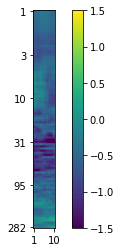

date:180324, rec:005, time:550.0, label:1.0
date:180322, rec:007, time:4980.0, label:0.0


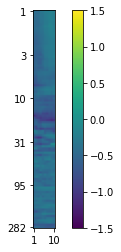

date:180322, rec:007, time:4570.0, label:0.0


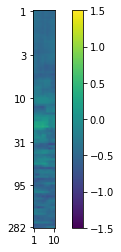

date:180324, rec:006, time:1022.0, label:1.0
date:180324, rec:001, time:6927.0, label:1.0
date:180322, rec:004, time:5586.0, label:1.0
date:180324, rec:006, time:7093.0, label:0.0


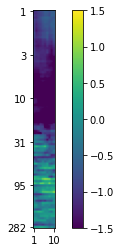

date:180323, rec:005, time:4118.0, label:1.0
date:180323, rec:002, time:4786.0, label:1.0
date:180325, rec:001, time:5126.0, label:1.0
date:180322, rec:007, time:3599.0, label:0.0


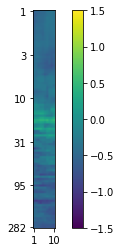

date:180323, rec:002, time:1827.0, label:1.0
date:180325, rec:006, time:4915.0, label:1.0
date:180401, rec:001, time:2349.0, label:1.0
date:180325, rec:001, time:5542.0, label:1.0
date:180325, rec:009, time:4839.0, label:0.0


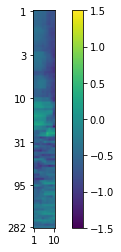

date:180324, rec:008, time:2918.0, label:0.0


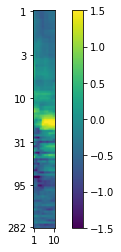

date:180325, rec:009, time:3266.0, label:1.0
date:180325, rec:007, time:3176.0, label:0.0


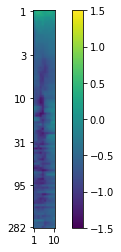

date:180323, rec:005, time:4571.0, label:1.0
date:180325, rec:006, time:3733.0, label:1.0
date:180325, rec:006, time:7166.0, label:1.0
date:180401, rec:002, time:2366.0, label:1.0
date:180325, rec:009, time:600.0, label:0.0


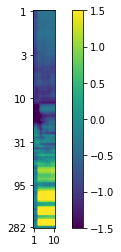

date:180325, rec:003, time:30.0, label:1.0
date:180401, rec:002, time:1299.0, label:1.0
date:180324, rec:008, time:2718.0, label:0.0


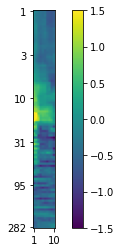

date:180322, rec:007, time:4040.0, label:0.0


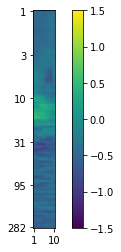

date:180323, rec:007, time:6141.0, label:0.0


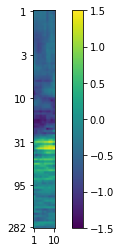

date:180323, rec:003, time:5281.0, label:1.0
date:180323, rec:007, time:6911.0, label:0.0


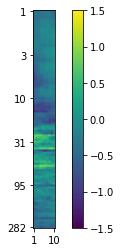

date:180325, rec:001, time:1520.0, label:0.0


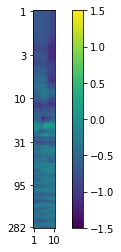

date:180324, rec:009, time:110.0, label:0.0


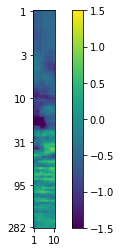

date:180325, rec:007, time:5943.0, label:0.0


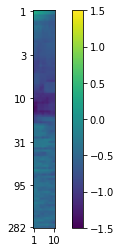

date:180323, rec:002, time:5856.0, label:1.0
date:180325, rec:007, time:4533.0, label:0.0


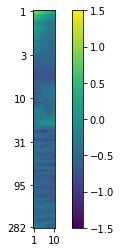

date:180325, rec:007, time:3166.0, label:0.0


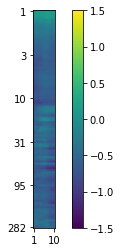

date:180325, rec:001, time:1700.0, label:0.0


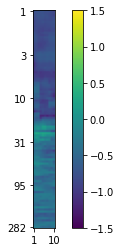

date:180401, rec:001, time:5287.0, label:0.0


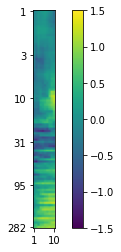

date:180323, rec:003, time:1397.0, label:1.0
date:180323, rec:003, time:1427.0, label:1.0
date:180325, rec:006, time:2442.0, label:1.0
date:180323, rec:001, time:6326.0, label:1.0
date:180325, rec:002, time:1942.0, label:1.0
date:180325, rec:007, time:3176.0, label:0.0


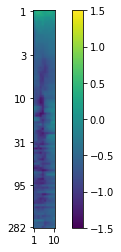

date:180325, rec:009, time:4829.0, label:0.0


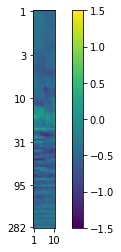

date:180322, rec:007, time:4010.0, label:0.0


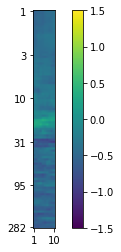

date:180323, rec:005, time:2027.0, label:1.0
date:180325, rec:007, time:4713.0, label:0.0


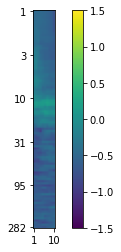

date:180325, rec:003, time:3552.0, label:1.0
date:180324, rec:008, time:151.0, label:1.0
date:180322, rec:007, time:215.0, label:0.0


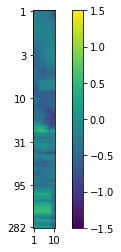

date:180325, rec:009, time:7163.0, label:0.0


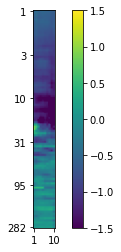

date:180322, rec:007, time:1567.0, label:0.0


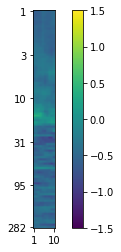

date:180324, rec:008, time:1621.0, label:0.0


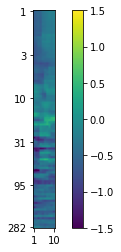

date:180322, rec:003, time:1113.0, label:1.0
date:180325, rec:009, time:3096.0, label:1.0
date:180401, rec:002, time:5652.0, label:1.0
date:180324, rec:004, time:6242.0, label:1.0
date:180325, rec:009, time:540.0, label:0.0


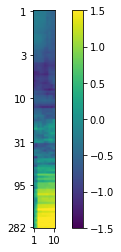

date:180324, rec:008, time:3990.0, label:1.0
date:180325, rec:006, time:3453.0, label:1.0
date:180323, rec:003, time:5091.0, label:1.0
date:180322, rec:005, time:7129.0, label:1.0
date:180325, rec:002, time:4538.0, label:1.0
date:180322, rec:003, time:983.0, label:1.0
date:180325, rec:004, time:4010.0, label:1.0
date:180324, rec:001, time:1662.0, label:1.0
date:180325, rec:009, time:4459.0, label:0.0


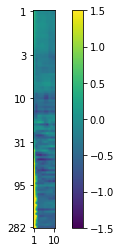

date:180325, rec:002, time:2222.0, label:1.0
date:180323, rec:001, time:6703.0, label:1.0
date:180323, rec:005, time:2147.0, label:1.0
date:180324, rec:008, time:1821.0, label:0.0


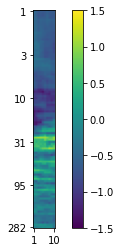

date:180323, rec:007, time:2825.0, label:0.0


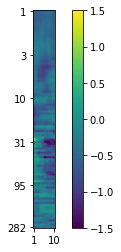

date:180322, rec:005, time:230.0, label:1.0
date:180323, rec:007, time:6841.0, label:0.0


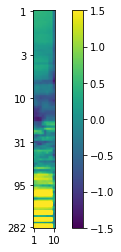

date:180324, rec:006, time:442.0, label:1.0
date:180325, rec:009, time:610.0, label:0.0


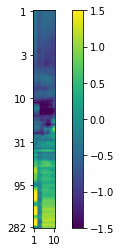

date:180325, rec:007, time:420.0, label:1.0
date:180325, rec:009, time:5649.0, label:1.0
date:180324, rec:008, time:6034.0, label:0.0


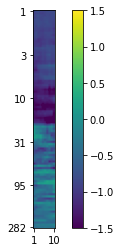

date:180401, rec:002, time:2946.0, label:1.0
date:180323, rec:003, time:1645.0, label:1.0
date:180323, rec:001, time:1140.0, label:0.0


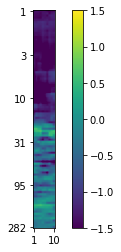

date:180325, rec:001, time:640.0, label:0.0


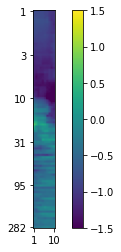

date:180323, rec:003, time:5721.0, label:1.0
date:180325, rec:004, time:4894.0, label:1.0
date:180401, rec:003, time:110.0, label:1.0
date:180324, rec:009, time:1147.0, label:0.0


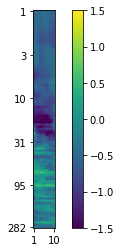

date:180324, rec:006, time:682.0, label:1.0
date:180322, rec:007, time:3279.0, label:0.0


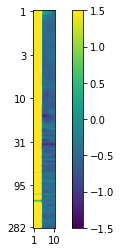

date:180322, rec:007, time:4120.0, label:0.0


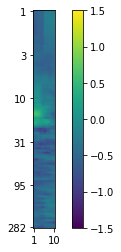

date:180323, rec:003, time:5111.0, label:1.0
date:180401, rec:001, time:1140.0, label:0.0


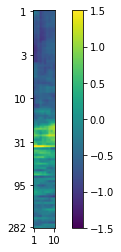

date:180325, rec:005, time:2074.0, label:1.0
date:180325, rec:003, time:2705.0, label:1.0
date:180324, rec:008, time:2264.0, label:1.0
date:180325, rec:003, time:2165.0, label:1.0
date:180325, rec:007, time:6213.0, label:0.0


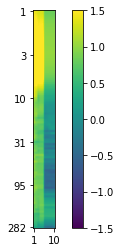

date:180324, rec:009, time:220.0, label:0.0


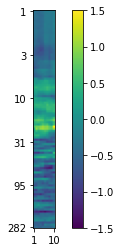

date:180324, rec:006, time:3199.0, label:1.0
date:180322, rec:004, time:7003.0, label:1.0
date:180325, rec:009, time:990.0, label:0.0


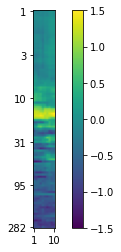

date:180322, rec:004, time:4679.0, label:1.0
date:180324, rec:008, time:501.0, label:1.0
date:180325, rec:006, time:7136.0, label:1.0
date:180323, rec:007, time:4692.0, label:0.0


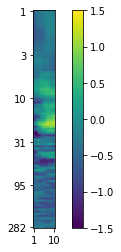

date:180401, rec:001, time:1020.0, label:0.0


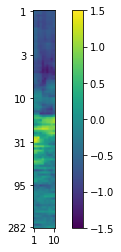

date:180325, rec:007, time:2666.0, label:0.0


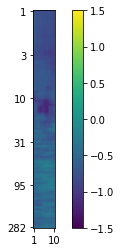

date:180325, rec:006, time:5418.0, label:1.0
date:180325, rec:006, time:1129.0, label:1.0
date:180325, rec:007, time:1538.0, label:0.0


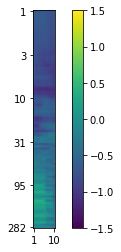

date:180325, rec:007, time:5033.0, label:0.0


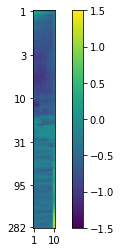

date:180324, rec:008, time:1141.0, label:0.0


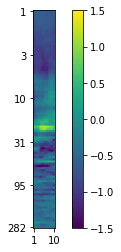

date:180322, rec:005, time:2971.0, label:1.0
date:180323, rec:003, time:4297.0, label:1.0
date:180324, rec:006, time:4418.0, label:1.0
date:180325, rec:007, time:1404.0, label:1.0
date:180325, rec:001, time:4090.0, label:1.0
date:180324, rec:006, time:4339.0, label:1.0
date:180325, rec:001, time:2120.0, label:0.0


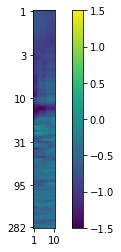

date:180323, rec:007, time:2825.0, label:0.0


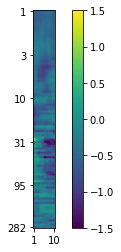

date:180325, rec:009, time:4368.0, label:0.0


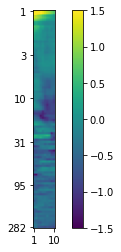

date:180322, rec:007, time:2113.0, label:0.0


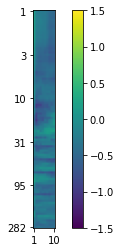

date:180322, rec:005, time:2831.0, label:1.0
date:180324, rec:008, time:6154.0, label:0.0


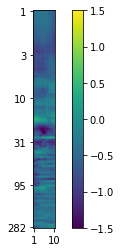

date:180322, rec:003, time:5443.0, label:1.0


In [6]:
# movement labelled 0; non-movement labelled 1
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader):
    for i in range(128):
        print('date:{}, rec:{}, time:{}, label:{}'.format(date[i], rec[i], time[i], label[i][0].numpy()))
        if label[i][0].numpy() == 0.0:
            data_sub = data[i][0]
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, 9], labels=[1, 10])
            plt.imshow(data_sub)
            plt.clim(-1.5, 1.5)
            plt.colorbar()
            plt.show()
    break

In [7]:
class MLP(nn.Module): # add dropo
    def __init__(self, input_dim=100*10*62, output_dim=1, embed_dim=256,drop_prob=0.):
        super(MLP, self).__init__()
        self.linear1 = nn.Linear(input_dim, embed_dim)
        self.linear2 = nn.Linear(embed_dim, output_dim)
        self.dropout = nn.Dropout(drop_prob)
        
    def forward(self, x):
        
        x = x.reshape([x.shape[0], 1, -1]).float()
        x = self.dropout(F.relu(self.linear1(x)))
        outputs = self.linear2(x)
        
        return outputs

### Define parameters

In [1]:
device = torch.device('cuda')

tol = 0.01
learning_rate = 0.001
num_epochs = 51
alpha = 0
model_type = 'MLP'
loss_type = 'bce'
reg_type = 'none'
input_dim = 1*10*100
embed_dim = 256
dropout_all = [0.1,0.3,0.5,0.7,0.9,1] # different dropout values




NameError: name 'torch' is not defined

### Train and validate for different dropout values 

In [9]:
# Iterate the model over different values of dropout
for d in range(0,len(dropout_all)):
    dropout = dropout_all[d]
    model = MLP(input_dim=input_dim, embed_dim=embed_dim,drop_prob = dropout).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    (data, labels, _, _, _) = next(iter(train_loader))
    data = data.to(device)
    output = model(data)
    print('dropout: ', dropout)
    output.shape

    epochs, training_losses, training_acc, val_losses, validation_acc = [], [], [], [], []

    for epoch in range(num_epochs):
        # train function 
        train_loss, train_acc = train(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                      reg_type=reg_type, collect_result=False, device=device)
        print('Train loss for epoch {}: {}'.format(epoch, train_loss))
        # validation function 
        val_loss, val_acc = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                     reg_type=reg_type, collect_result=False, device=device)
        print('Val loss for epoch {}: {}'.format(epoch, val_loss))
        
        # save the model at epoch 0
        if epoch == 0:
            torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))

        if val_losses:
            # save the model everytime it performs better than before 
            if val_loss < min(val_losses):
                best_epoch = epoch
                print(epoch)
                torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))
        epochs.append(epoch)
        training_losses.append(train_loss)
        training_acc.append(train_acc)
        val_losses.append(val_loss)
        validation_acc.append(val_acc)

        if train_loss < tol:
            break
    plot_loss_acc(training_losses, val_losses, training_acc, validation_acc, model_type) # embed_dim=64

dropout:  0.1
Train loss for epoch 0: 0.4111815392971039
Val loss for epoch 0: 0.2570887804031372


FileNotFoundError: [Errno 2] No such file or directory: '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.1_EMBED256_EPOCH0_MODEL_MLP_1_ch_Drop_03.pt'

In [ ]:
model_MLP = os.listdir(save_path)
results = []
for x in range(0,len(model_MLP)):
    result = model_MLP[x].split('_') 
    channel = [i for i,item in enumerate(np.array(result)) if "CH23" in item]
    if not(channel):
        continue
    else:
        model_dropout = [i for i,item in enumerate(np.array(result)) if "DO" in item]
        if not(model_dropout):
            continue
        else:
            dropout = [int(i) for i in result[model_dropout[0]] if i.isdigit()]
            if len(dropout) ==2:
                dropout = dropout[1]/10
            else:
                dropout = dropout[0]
            epoch_name = [i for i,item in enumerate(np.array(result)) if "EPOCH" in item]
            res = [int(i) for i in result[epoch_name[0]] if i.isdigit()]
            if len(res) > 1:
                epoch_result = res[0]*10+res[1]
            else:
                epoch_result = res[0]
            results.append([dropout, epoch_result])

results = pd.DataFrame(np.array(results), columns=['dropout', 'epoch'])
best_results = results.groupby('dropout').max('epoch')
print(best_results)

In [ ]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    
    # Print Shape
    w1 = model.linear1.weight.view(256,10,100)
    w2 = model.linear2.weight
    print(w1.shape, w2.shape)
    w1 = w1.detach().cpu().numpy()
    w2 = w2.detach().cpu().numpy()
    w1[0].shape
    type(w1)
    
    # Print one feature
    print('One feature')
    plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
    plt.xticks(ticks=[0, 9], labels=[1, 10])
    plt.imshow(w1[1].transpose(),origin='lower')
    # plt.clim(-1.5, 1.5)
    plt.colorbar()
    plt.show()
    
    # All features
    timewindow = 10
    plt.figure(figsize=(20,20))
    ylabels_list = [0,32,64,96,128,160,192,224,256] 
    for i in range(256):
        weights_sub = w1[i]
        plt.subplot(8,32,i+1)
        if i in ylabels_list:
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, timewindow-1], labels=[1, timewindow])
        else:
            plt.axis('off')
    #     plt.imshow(weights_sub)
        plt.imshow(w1[i].transpose(),origin='lower')
        plt.title(str(i+1))
    plt.show()
    
    
    ## Calculate accuracy and validation loss
    val_loss, val_acc, val_preds, val_preds_probs, val_labels,_,_,_, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('validation loss:{} accuracy:{}'.format(val_loss, val_acc))

    ## Calculate test accuracy and test loss
    test_loss, test_acc, test_preds, test_preds_probs, test_labels,_,_,_, cases_wrong_2 = evaluate(model, optimizer, test_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('test loss:{} accuracy:{}'.format(test_loss, test_acc))
    print(np.mean(np.concatenate(test_labels)))
    
    ## Confusion matrix - Validation
    predictions_val = np.concatenate(val_preds)
    labels_val = np.concatenate(val_labels)

    df_val = pd.DataFrame({'predictions': predictions_val, 'labels': labels_val})

    cm_val = confusion_matrix(labels_val, predictions_val)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_val.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_val, annot=labels, fmt='', center = 2000)
    ax.set_title('Validation Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Confusion matrix-test
    predictions_test = np.concatenate(test_preds)
    labels_test = np.concatenate(test_labels)

    df_test = pd.DataFrame({'predictions': predictions_test, 'labels': labels_test})

    cm_test = confusion_matrix(labels_test, predictions_test)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_test.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_test, annot=labels, fmt='', center = 2000)
    ax.set_title('Test Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

In [ ]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

# Goose 1st + 2nd series

In [2]:
CH = 23
device = torch.device('cuda')
val_dates = ['180409','180412','180414']
test_dates = ['180411', '180413']
bad_dates = ['180326', '180328', '171019', '180715', '180716', '180717']
#load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/'
load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/'
# save_path = '/mnt/pesaranlab/People/Capstone_students/Yue/model/model_Goose_1st_2_upsample'
save_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models'
model_name = 'MLP_1_ch_Drop_03'


train_files, val_files, test_files = create_files(load_path, val_dates, test_dates, bad_dates)
train_loader, val_loader, test_loader = create_dataloaders(train_files, val_files, test_files, load_path, batch_size=256,CH=CH)

In [3]:
len(train_loader), len(val_loader), len(test_loader)

(173, 26, 24)

In [4]:
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader): # check shapes
    print(data.shape)
    print(label.shape)
    print(len(date))
    print(len(rec))
    print(len(time))
    break

torch.Size([256, 1, 100, 10])
torch.Size([256, 1])
256
256
256


date:180323, rec:007, time:6361.0, label:0.0


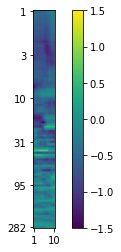

date:180323, rec:002, time:4316.0, label:1.0
date:180327, rec:006, time:5398.0, label:1.0
date:180330, rec:008, time:5705.0, label:0.0


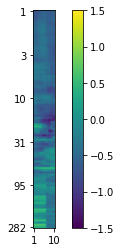

date:180330, rec:007, time:7064.0, label:1.0
date:180323, rec:005, time:4088.0, label:1.0
date:180410, rec:004, time:4408.0, label:1.0
date:180325, rec:009, time:6510.0, label:0.0


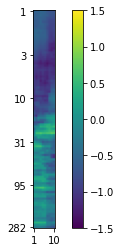

date:180331, rec:004, time:6037.0, label:1.0
date:180324, rec:006, time:1092.0, label:1.0
date:180327, rec:001, time:1200.0, label:0.0


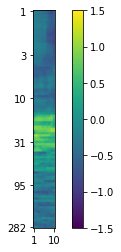

date:180331, rec:005, time:170.0, label:1.0
date:180323, rec:007, time:2825.0, label:0.0


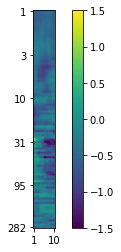

date:180324, rec:001, time:760.0, label:0.0


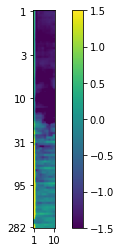

date:180323, rec:003, time:5981.0, label:1.0
date:180325, rec:004, time:7130.0, label:1.0
date:180327, rec:007, time:4541.0, label:0.0


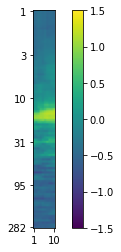

date:180325, rec:007, time:500.0, label:1.0
date:180410, rec:005, time:2357.0, label:1.0
date:180325, rec:009, time:400.0, label:0.0


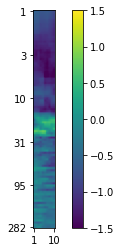

date:180327, rec:008, time:3302.0, label:0.0


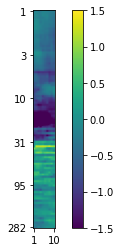

date:180324, rec:008, time:2221.0, label:0.0


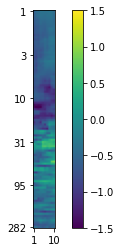

date:180327, rec:005, time:7145.0, label:1.0
date:180329, rec:004, time:6966.0, label:1.0
date:180324, rec:008, time:5794.0, label:0.0


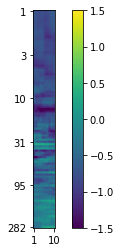

date:180410, rec:005, time:6292.0, label:1.0
date:180331, rec:003, time:5868.0, label:1.0
date:180329, rec:006, time:2224.0, label:1.0
date:180325, rec:009, time:1590.0, label:0.0


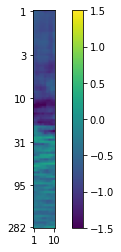

date:180322, rec:005, time:3161.0, label:1.0
date:180324, rec:009, time:610.0, label:0.0


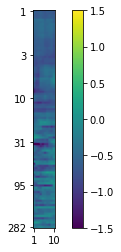

date:180325, rec:001, time:750.0, label:0.0


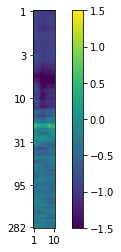

date:180324, rec:001, time:6607.0, label:1.0
date:180330, rec:008, time:2666.0, label:0.0


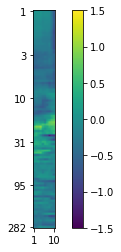

date:180325, rec:009, time:4769.0, label:0.0


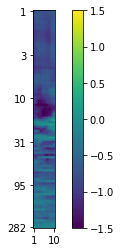

date:180323, rec:002, time:2366.0, label:1.0
date:180327, rec:008, time:3882.0, label:0.0


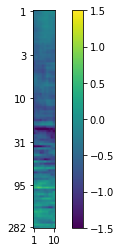

date:180331, rec:001, time:810.0, label:0.0


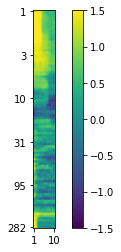

date:180329, rec:001, time:1000.0, label:0.0


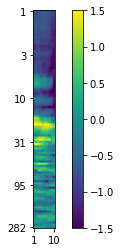

date:180330, rec:003, time:2797.0, label:1.0
date:180329, rec:005, time:1485.0, label:1.0
date:180324, rec:008, time:5594.0, label:0.0


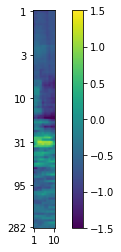

date:180325, rec:007, time:2986.0, label:0.0


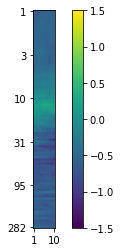

date:180324, rec:008, time:2588.0, label:0.0


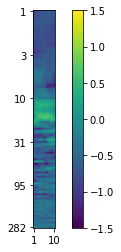

date:180322, rec:005, time:1008.0, label:1.0
date:180330, rec:008, time:4707.0, label:0.0


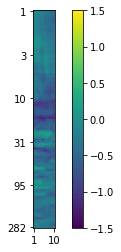

date:180322, rec:003, time:4947.0, label:1.0
date:180330, rec:009, time:6731.0, label:0.0


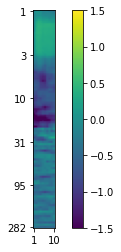

date:180330, rec:008, time:1884.0, label:1.0
date:180329, rec:004, time:5431.0, label:1.0
date:180331, rec:003, time:5968.0, label:1.0
date:180325, rec:009, time:3256.0, label:1.0
date:180327, rec:008, time:1387.0, label:1.0
date:180331, rec:004, time:6067.0, label:1.0
date:180325, rec:007, time:3086.0, label:0.0


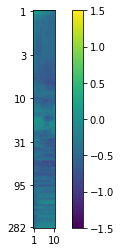

date:180331, rec:007, time:6848.0, label:0.0


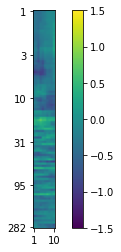

date:180327, rec:001, time:310.0, label:0.0


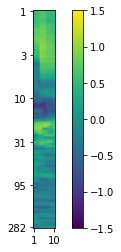

date:180329, rec:003, time:6676.0, label:1.0
date:180323, rec:006, time:4669.0, label:1.0
date:180322, rec:003, time:1013.0, label:1.0
date:180330, rec:008, time:4227.0, label:0.0


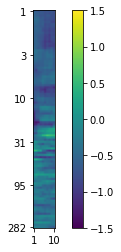

date:180325, rec:005, time:6874.0, label:1.0
date:180327, rec:008, time:2622.0, label:0.0


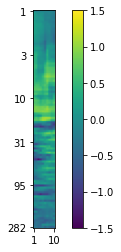

date:180327, rec:005, time:5518.0, label:0.0


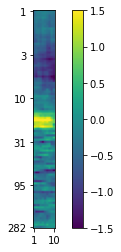

date:180331, rec:007, time:5317.0, label:0.0


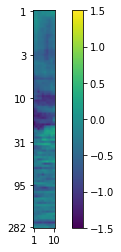

date:180324, rec:008, time:481.0, label:1.0
date:180322, rec:005, time:2801.0, label:1.0
date:180330, rec:007, time:3890.0, label:1.0
date:180327, rec:007, time:3840.0, label:0.0


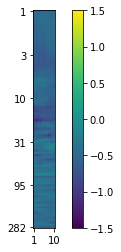

date:180330, rec:008, time:4757.0, label:0.0


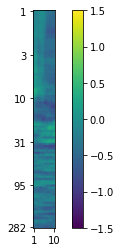

date:180330, rec:001, time:260.0, label:0.0


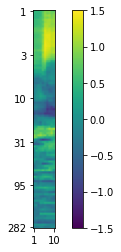

date:180325, rec:009, time:4749.0, label:0.0


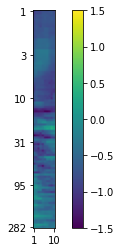

date:180324, rec:008, time:1291.0, label:0.0


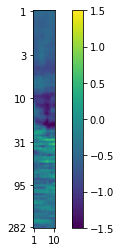

date:180324, rec:006, time:5626.0, label:1.0
date:180330, rec:009, time:5221.0, label:0.0


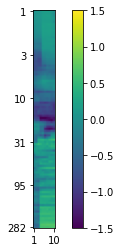

date:180327, rec:002, time:2290.0, label:1.0
date:180327, rec:001, time:1460.0, label:0.0


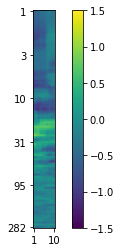

date:180331, rec:006, time:5209.0, label:1.0
date:180329, rec:001, time:760.0, label:0.0


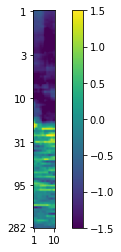

date:180327, rec:007, time:7171.0, label:0.0


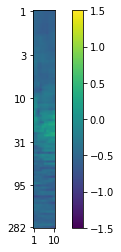

date:180322, rec:005, time:6144.0, label:1.0
date:180401, rec:001, time:4677.0, label:1.0
date:180330, rec:004, time:460.0, label:1.0
date:180329, rec:001, time:6361.0, label:1.0
date:180330, rec:008, time:4727.0, label:0.0


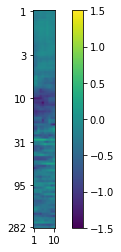

date:180329, rec:004, time:720.0, label:1.0
date:180329, rec:001, time:1430.0, label:0.0


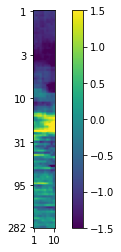

date:180330, rec:009, time:4601.0, label:0.0


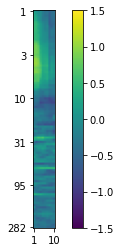

date:180323, rec:005, time:4278.0, label:1.0
date:180331, rec:001, time:1130.0, label:0.0


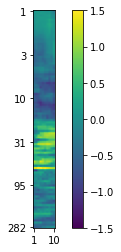

date:180330, rec:008, time:261.0, label:0.0


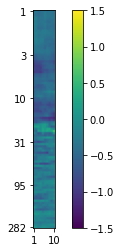

date:180329, rec:002, time:3512.0, label:1.0
date:180327, rec:001, time:2010.0, label:0.0


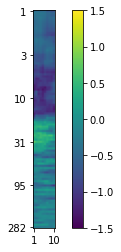

date:180330, rec:009, time:1324.0, label:0.0


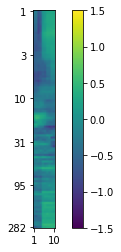

date:180327, rec:001, time:150.0, label:0.0


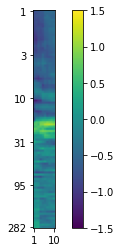

date:180327, rec:005, time:6592.0, label:0.0


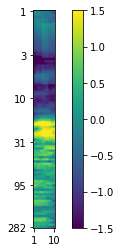

date:180325, rec:002, time:4938.0, label:1.0
date:180327, rec:001, time:1210.0, label:0.0


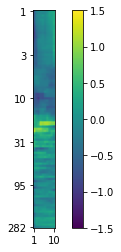

date:180401, rec:001, time:6273.0, label:1.0
date:180331, rec:007, time:6168.0, label:0.0


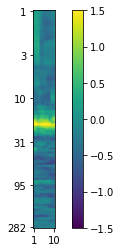

date:180325, rec:005, time:6794.0, label:1.0
date:180331, rec:005, time:2392.0, label:1.0
date:180325, rec:003, time:5757.0, label:1.0
date:180324, rec:009, time:460.0, label:0.0


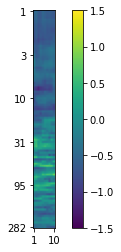

date:180410, rec:005, time:6572.0, label:1.0
date:180331, rec:001, time:1880.0, label:0.0


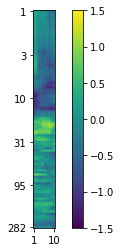

date:180330, rec:005, time:1456.0, label:1.0
date:180329, rec:004, time:1940.0, label:0.0


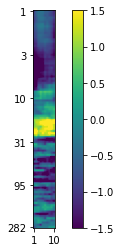

date:180330, rec:008, time:301.0, label:0.0


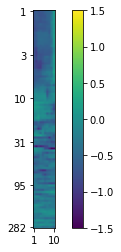

date:180330, rec:008, time:1771.0, label:0.0


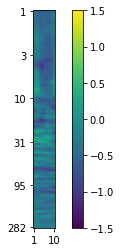

date:180401, rec:001, time:260.0, label:0.0


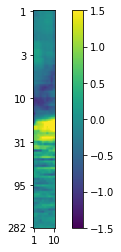

date:180329, rec:002, time:1406.0, label:1.0
date:180330, rec:006, time:1224.0, label:1.0
date:180325, rec:002, time:4558.0, label:1.0
date:180323, rec:007, time:124.0, label:0.0


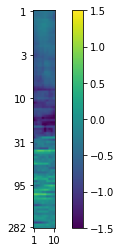

date:180331, rec:007, time:4637.0, label:0.0


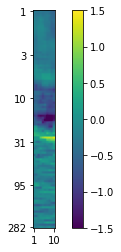

date:180324, rec:006, time:3829.0, label:1.0
date:180324, rec:009, time:1007.0, label:0.0


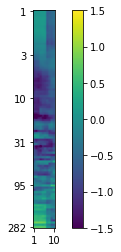

date:180327, rec:004, time:530.0, label:1.0
date:180327, rec:007, time:1180.0, label:0.0


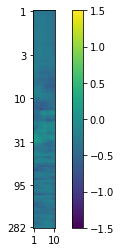

date:180325, rec:003, time:290.0, label:1.0
date:180325, rec:007, time:6793.0, label:0.0


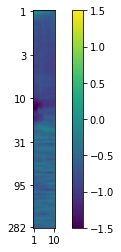

date:180327, rec:008, time:1612.0, label:0.0


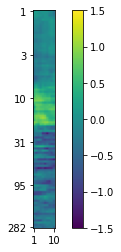

date:180331, rec:005, time:4057.0, label:0.0


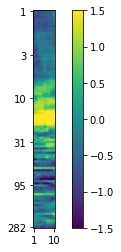

date:180331, rec:007, time:4527.0, label:0.0


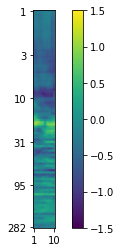

date:180410, rec:006, time:2206.0, label:1.0
date:180327, rec:008, time:4893.0, label:0.0


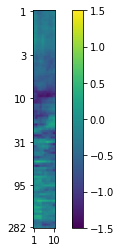

date:180325, rec:009, time:4469.0, label:0.0


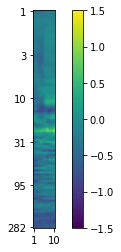

In [5]:
# movement labelled 0; non-movement labelled 1
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader):
    for i in range(128):
        print('date:{}, rec:{}, time:{}, label:{}'.format(date[i], rec[i], time[i], label[i][0].numpy()))
        if label[i][0].numpy() == 0.0:
            data_sub = data[i][0]
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, 9], labels=[1, 10])
            plt.imshow(data_sub)
            plt.clim(-1.5, 1.5)
            plt.colorbar()
            plt.show()
    break

In [6]:
class MLP(nn.Module): # add dropo
    def __init__(self, input_dim=100*10*62, output_dim=1, embed_dim=256,drop_prob=0.):
        super(MLP, self).__init__()
        self.linear1 = nn.Linear(input_dim, embed_dim)
        self.linear2 = nn.Linear(embed_dim, output_dim)
        self.dropout = nn.Dropout(drop_prob)
        
    def forward(self, x):
        
        x = x.reshape([x.shape[0], 1, -1]).float()
        x = self.dropout(F.relu(self.linear1(x)))
        outputs = self.linear2(x)
        
        return outputs

In [14]:
device = torch.device('cuda')

tol = 0.01
learning_rate = 0.001
num_epochs = 51
alpha = 0
model_type = 'MLP'
loss_type = 'bce'
reg_type = 'none'
input_dim = 1*10*100
embed_dim = 256
dropout_all = [0.1,0.3,0.5,0.7,0.9,1]




dropout:  0.1
Train loss for epoch 0: 0.34281590580940247
Val loss for epoch 0: 0.2787000834941864
Train loss for epoch 1: 0.2344484031200409
Val loss for epoch 1: 0.288552463054657
Train loss for epoch 2: 0.1982542723417282
Val loss for epoch 2: 0.2964707314968109
Train loss for epoch 3: 0.17439241707324982
Val loss for epoch 3: 0.31730225682258606
Train loss for epoch 4: 0.1586615890264511
Val loss for epoch 4: 0.3239644467830658
Train loss for epoch 5: 0.14446189999580383
Val loss for epoch 5: 0.31426331400871277
Train loss for epoch 6: 0.13515865802764893
Val loss for epoch 6: 0.394182950258255
Train loss for epoch 7: 0.13441532850265503
Val loss for epoch 7: 0.3296968340873718
Train loss for epoch 8: 0.12642911076545715
Val loss for epoch 8: 0.38254520297050476
Train loss for epoch 9: 0.10596092790365219
Val loss for epoch 9: 0.4238676428794861
Train loss for epoch 10: 0.10981818288564682
Val loss for epoch 10: 0.4068177342414856
Train loss for epoch 11: 0.11295367032289505
Val lo

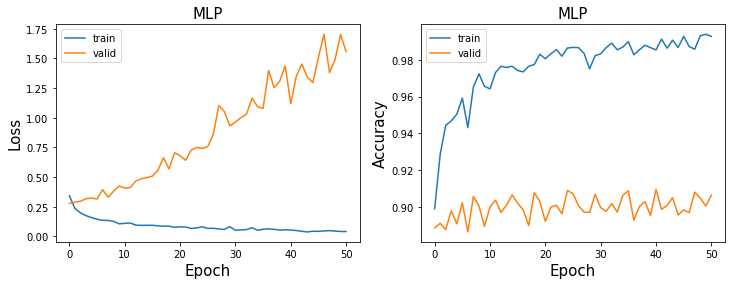

dropout:  0.3
Train loss for epoch 0: 0.36953872442245483
Val loss for epoch 0: 0.31582385301589966
Train loss for epoch 1: 0.27276334166526794
Val loss for epoch 1: 0.31624260544776917
Train loss for epoch 2: 0.23138576745986938
Val loss for epoch 2: 0.28806599974632263
2
Train loss for epoch 3: 0.22319847345352173
Val loss for epoch 3: 0.28227150440216064
3
Train loss for epoch 4: 0.19213862717151642
Val loss for epoch 4: 0.290407657623291
Train loss for epoch 5: 0.18250280618667603
Val loss for epoch 5: 0.29597094655036926
Train loss for epoch 6: 0.17153921723365784
Val loss for epoch 6: 0.3340047001838684
Train loss for epoch 7: 0.17217479646205902
Val loss for epoch 7: 0.3039514720439911
Train loss for epoch 8: 0.15792615711688995
Val loss for epoch 8: 0.3097515106201172
Train loss for epoch 9: 0.1552661657333374
Val loss for epoch 9: 0.3036574125289917
Train loss for epoch 10: 0.1477034091949463
Val loss for epoch 10: 0.31215178966522217
Train loss for epoch 11: 0.145773008465766

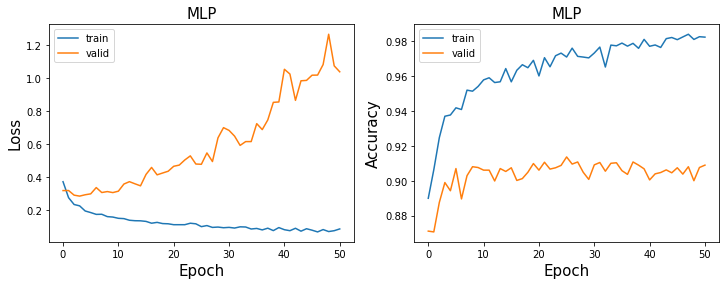

dropout:  0.5
Train loss for epoch 0: 0.38826417922973633
Val loss for epoch 0: 0.34781497716903687
Train loss for epoch 1: 0.306262731552124
Val loss for epoch 1: 0.28928443789482117
1
Train loss for epoch 2: 0.2740726172924042
Val loss for epoch 2: 0.29107770323753357
Train loss for epoch 3: 0.25209325551986694
Val loss for epoch 3: 0.26195597648620605
3
Train loss for epoch 4: 0.2377704232931137
Val loss for epoch 4: 0.2589702010154724
4
Train loss for epoch 5: 0.22721748054027557
Val loss for epoch 5: 0.2692064046859741
Train loss for epoch 6: 0.21967142820358276
Val loss for epoch 6: 0.284463495016098
Train loss for epoch 7: 0.20359554886817932
Val loss for epoch 7: 0.2949066460132599
Train loss for epoch 8: 0.19661517441272736
Val loss for epoch 8: 0.2596575915813446
Train loss for epoch 9: 0.19446665048599243
Val loss for epoch 9: 0.2813016474246979
Train loss for epoch 10: 0.18608985841274261
Val loss for epoch 10: 0.26746854186058044
Train loss for epoch 11: 0.1780909299850464

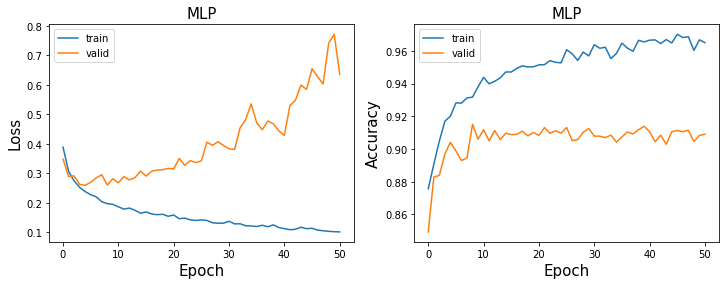

dropout:  0.7
Train loss for epoch 0: 0.4282852113246918
Val loss for epoch 0: 0.3496866226196289
Train loss for epoch 1: 0.36495134234428406
Val loss for epoch 1: 0.3071572482585907
1
Train loss for epoch 2: 0.3390060067176819
Val loss for epoch 2: 0.29953545331954956
2
Train loss for epoch 3: 0.31707996129989624
Val loss for epoch 3: 0.28413793444633484
3
Train loss for epoch 4: 0.301297664642334
Val loss for epoch 4: 0.29042670130729675
Train loss for epoch 5: 0.29396912455558777
Val loss for epoch 5: 0.2677317261695862
5
Train loss for epoch 6: 0.27634620666503906
Val loss for epoch 6: 0.2768457233905792
Train loss for epoch 7: 0.2736678123474121
Val loss for epoch 7: 0.26107725501060486
7
Train loss for epoch 8: 0.2629781663417816
Val loss for epoch 8: 0.24946752190589905
8
Train loss for epoch 9: 0.2571695148944855
Val loss for epoch 9: 0.2572158873081207
Train loss for epoch 10: 0.2504761219024658
Val loss for epoch 10: 0.2483082115650177
10
Train loss for epoch 11: 0.2473760098

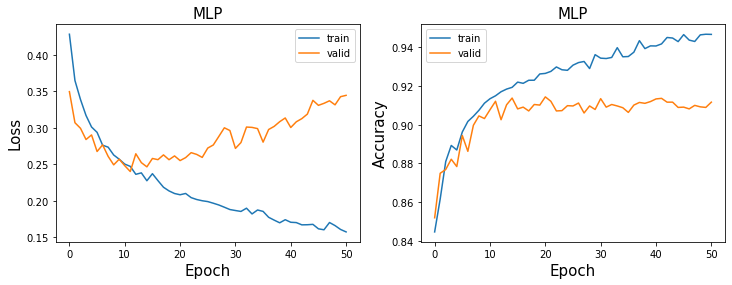

dropout:  0.9
Train loss for epoch 0: 0.5040687918663025
Val loss for epoch 0: 0.45985665917396545
Train loss for epoch 1: 0.4655873775482178
Val loss for epoch 1: 0.438922256231308
1
Train loss for epoch 2: 0.4517093896865845
Val loss for epoch 2: 0.3823639452457428
2
Train loss for epoch 3: 0.44256797432899475
Val loss for epoch 3: 0.37689515948295593
3
Train loss for epoch 4: 0.4321069121360779
Val loss for epoch 4: 0.3703621029853821
4
Train loss for epoch 5: 0.42829081416130066
Val loss for epoch 5: 0.32404136657714844
5
Train loss for epoch 6: 0.4218331277370453
Val loss for epoch 6: 0.35490238666534424
Train loss for epoch 7: 0.41495272517204285
Val loss for epoch 7: 0.33550137281417847
Train loss for epoch 8: 0.40728452801704407
Val loss for epoch 8: 0.3355637788772583
Train loss for epoch 9: 0.40224722027778625
Val loss for epoch 9: 0.33384355902671814
Train loss for epoch 10: 0.3995177149772644
Val loss for epoch 10: 0.3824215829372406
Train loss for epoch 11: 0.3944539427757

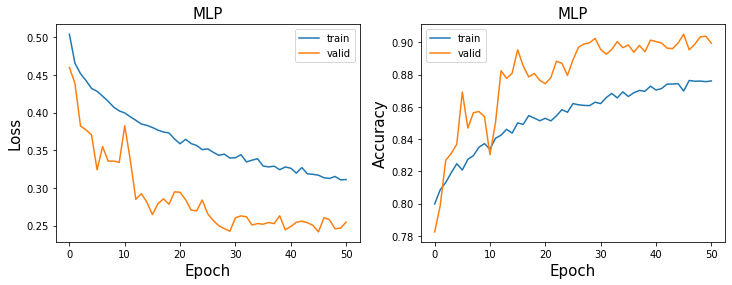

dropout:  1
Train loss for epoch 0: 0.6856540441513062
Val loss for epoch 0: 0.7940808534622192
Train loss for epoch 1: 0.6838292479515076
Val loss for epoch 1: 0.808368980884552
Train loss for epoch 2: 0.6837865710258484
Val loss for epoch 2: 0.8081523180007935
Train loss for epoch 3: 0.6837851405143738
Val loss for epoch 3: 0.8133434653282166
Train loss for epoch 4: 0.6837892532348633
Val loss for epoch 4: 0.812093198299408
Train loss for epoch 5: 0.6837979555130005
Val loss for epoch 5: 0.8101344704627991
Train loss for epoch 6: 0.683789074420929
Val loss for epoch 6: 0.8105877041816711
Train loss for epoch 7: 0.6837913990020752
Val loss for epoch 7: 0.8087476491928101
Train loss for epoch 8: 0.6837934255599976
Val loss for epoch 8: 0.8106309175491333
Train loss for epoch 9: 0.6837856769561768
Val loss for epoch 9: 0.8122179508209229
Train loss for epoch 10: 0.6837854385375977
Val loss for epoch 10: 0.8125029802322388
Train loss for epoch 11: 0.68379145860672
Val loss for epoch 11: 

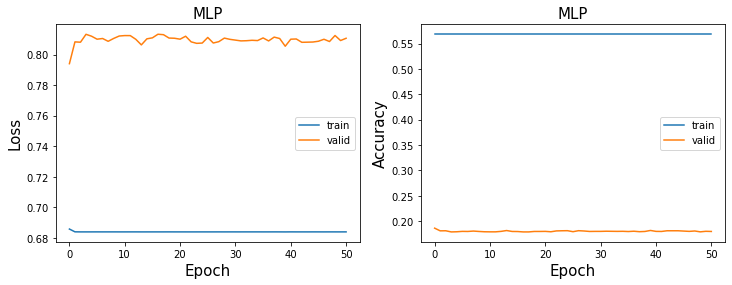

In [39]:

for d in range(0,len(dropout_all)):
    dropout = dropout_all[d]
    model = MLP(input_dim=input_dim, embed_dim=embed_dim,drop_prob = dropout).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    (data, labels, _, _, _) = next(iter(train_loader))
    data = data.to(device)
    output = model(data)
    print('dropout: ', dropout)
    output.shape

    epochs, training_losses, training_acc, val_losses, validation_acc = [], [], [], [], []

    for epoch in range(num_epochs):
        train_loss, train_acc = train(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                      reg_type=reg_type, collect_result=False, device=device)
        print('Train loss for epoch {}: {}'.format(epoch, train_loss))
        val_loss, val_acc = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                     reg_type=reg_type, collect_result=False, device=device)
        print('Val loss for epoch {}: {}'.format(epoch, val_loss))
        if epoch == 0:
            torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))

        if val_losses:
            
            if val_loss < min(val_losses):
                best_epoch = epoch
                print(epoch)
                torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))
        epochs.append(epoch)
        training_losses.append(train_loss)
        training_acc.append(train_acc)
        val_losses.append(val_loss)
        validation_acc.append(val_acc)

        if train_loss < tol:
            break
    plot_loss_acc(training_losses, val_losses, training_acc, validation_acc, model_type) # embed_dim=64

In [15]:
model_MLP = os.listdir(save_path)
results = []
for x in range(0,len(model_MLP)):
    result = model_MLP[x].split('_') 
    channel = [i for i,item in enumerate(np.array(result)) if "CH23" in item]
    if not(channel):
        continue
    else:
        model_dropout = [i for i,item in enumerate(np.array(result)) if "DO" in item]
        if not(model_dropout):
            continue
        else:
            dropout = [int(i) for i in result[model_dropout[0]] if i.isdigit()]
            if len(dropout) ==2:
                dropout = dropout[1]/10
            else:
                dropout = dropout[0]
            epoch_name = [i for i,item in enumerate(np.array(result)) if "EPOCH" in item]
            res = [int(i) for i in result[epoch_name[0]] if i.isdigit()]
            if len(res) > 1:
                epoch_result = res[0]*10+res[1]
            else:
                epoch_result = res[0]
            results.append([dropout, epoch_result])

results = pd.DataFrame(np.array(results), columns=['dropout', 'epoch'])
best_results = results.groupby('dropout').max('epoch')
print(best_results)

         epoch
dropout       
0.1        4.0
0.3        3.0
0.5        4.0
0.7       11.0
0.9       45.0
1.0        0.0


/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.1_EPOCH4.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


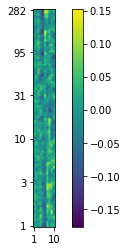

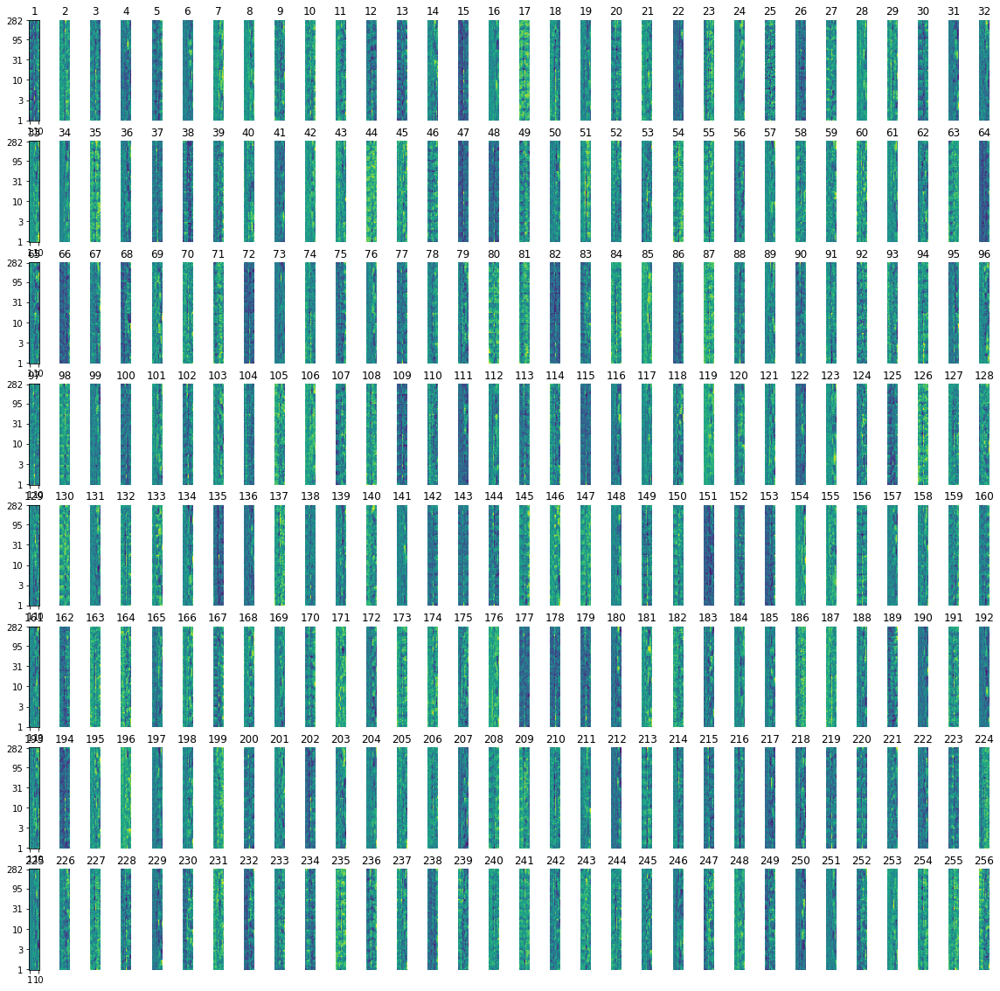

validation loss:0.2958032488822937 accuracy:0.9013595166163142
test loss:0.3295649588108063 accuracy:0.9056080860776002
0.74029994


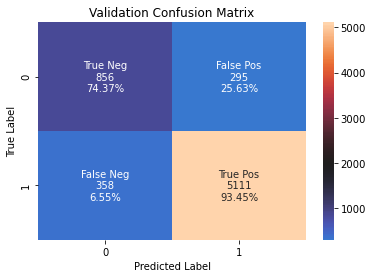

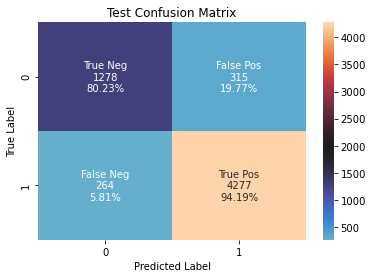

val loss:0.2958032488822937, val accuracy:0.9013595166163142, val percentage postive:0.8261329531669617


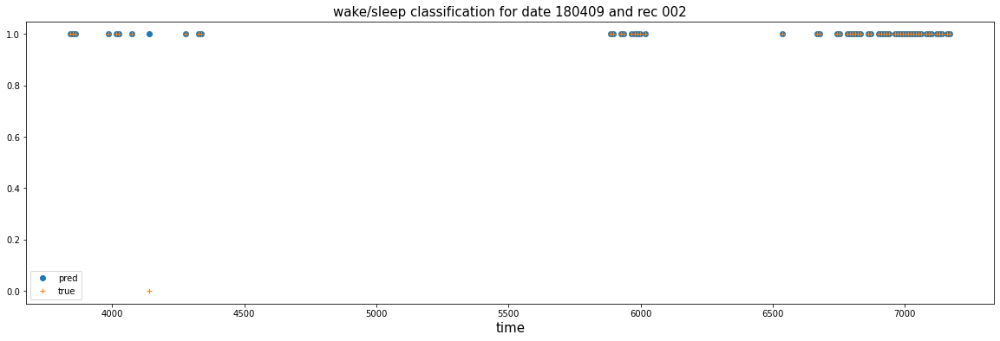

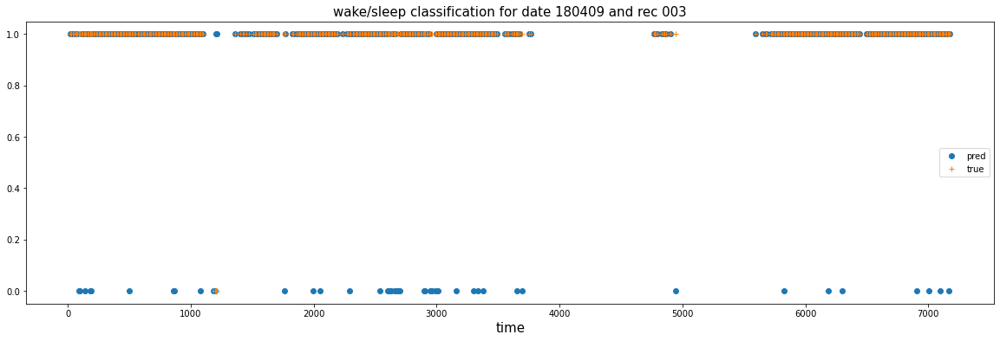

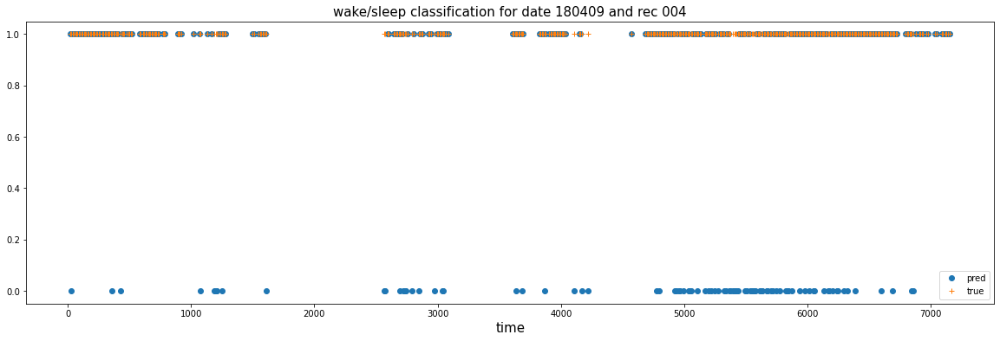

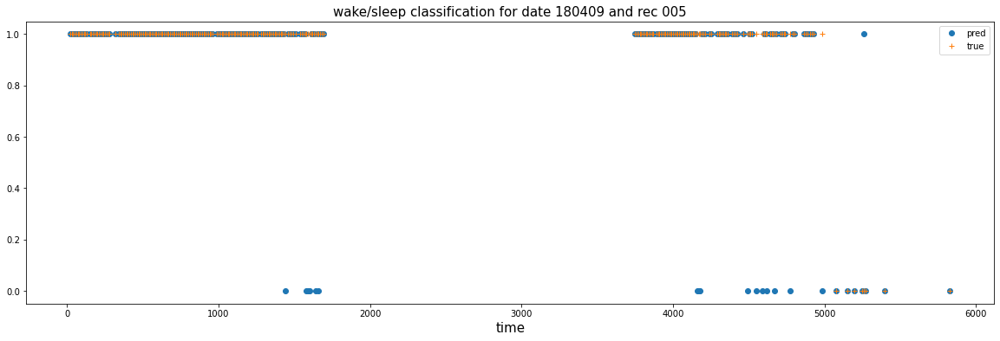

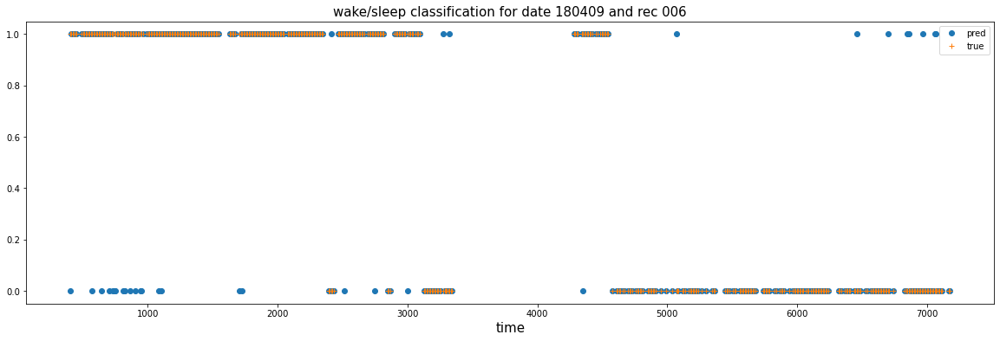

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.3_EPOCH3.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


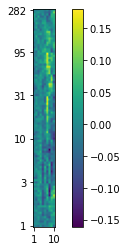

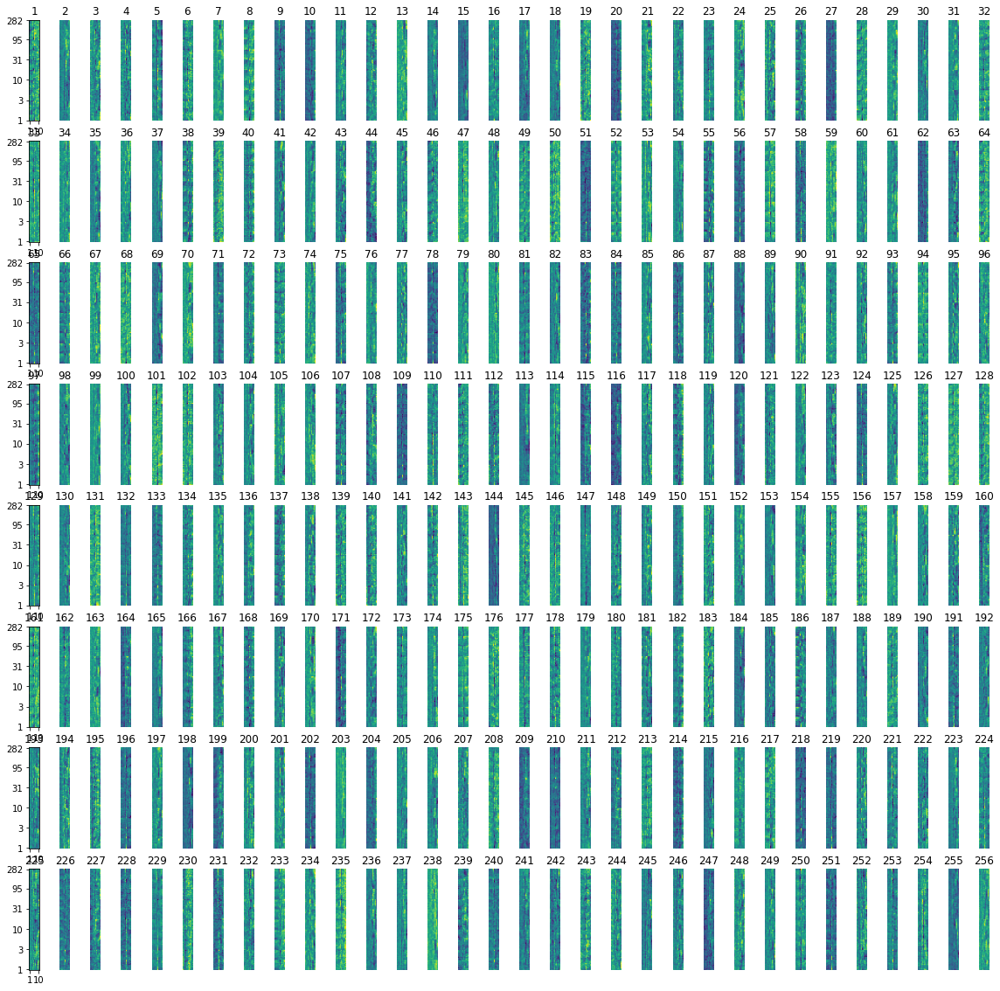

validation loss:0.28227150440216064 accuracy:0.8989425981873111
test loss:0.32422682642936707 accuracy:0.8969677208999022
0.74029994


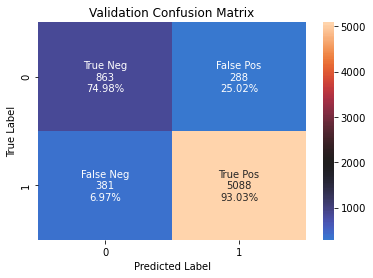

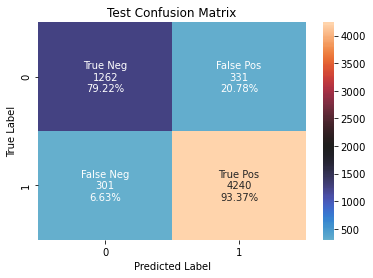

val loss:0.28227150440216064, val accuracy:0.8989425981873111, val percentage postive:0.8261329531669617


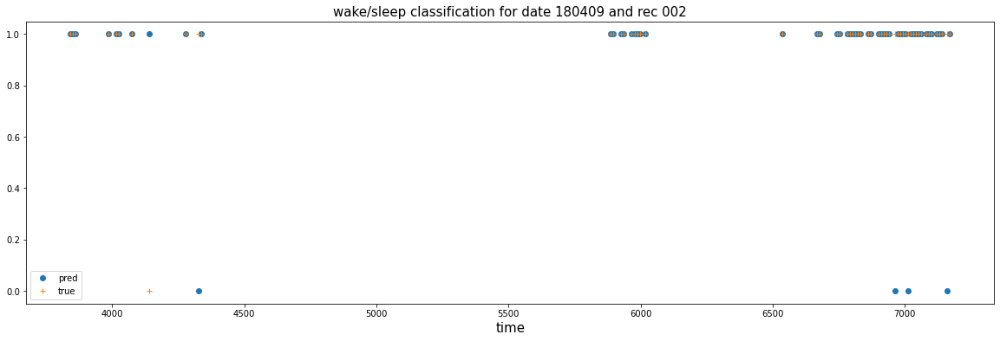

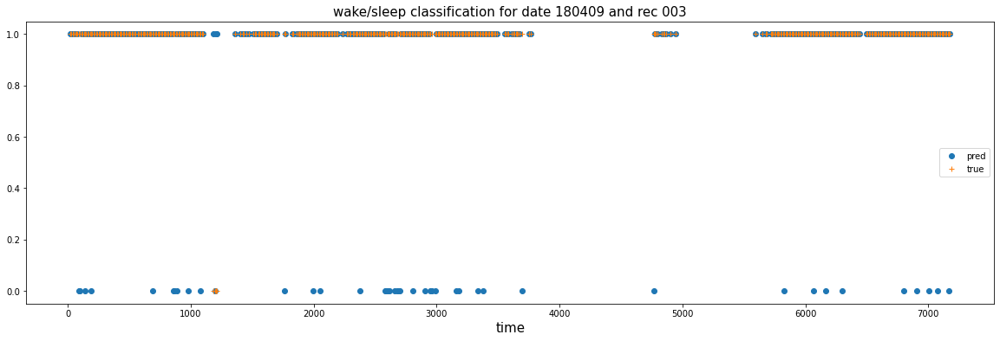

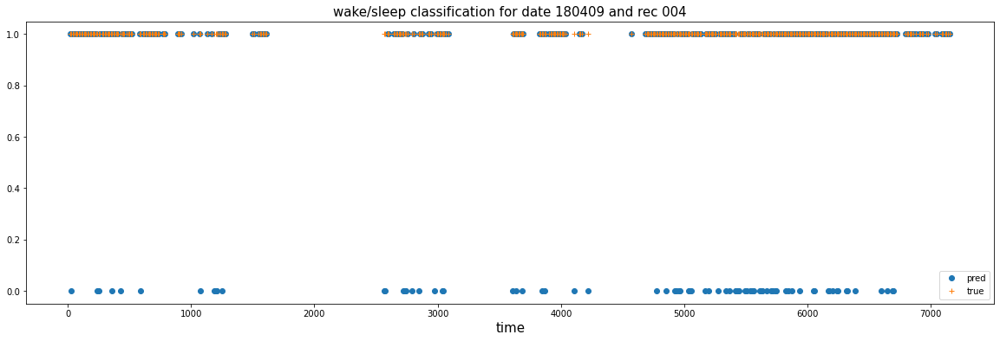

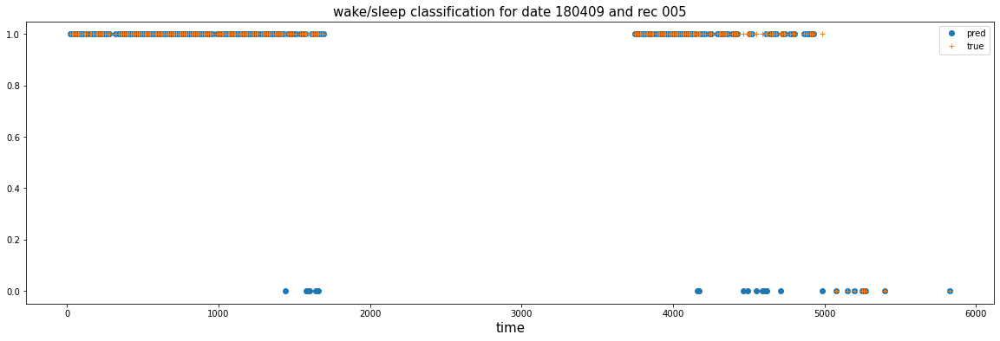

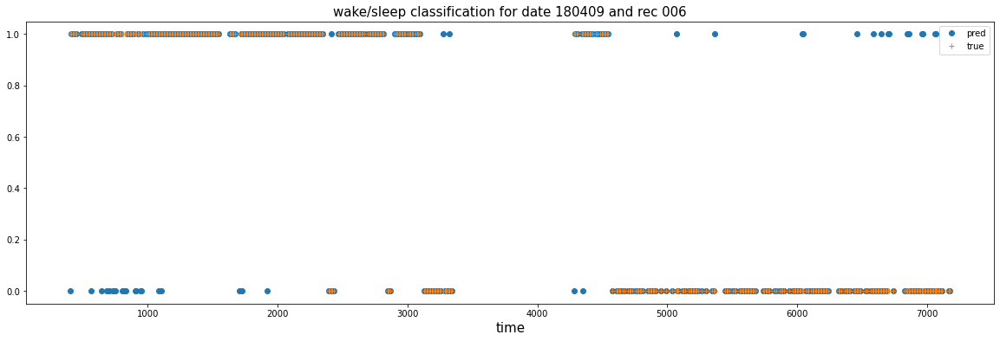

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.5_EPOCH4.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


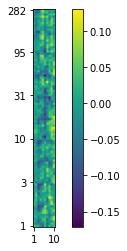

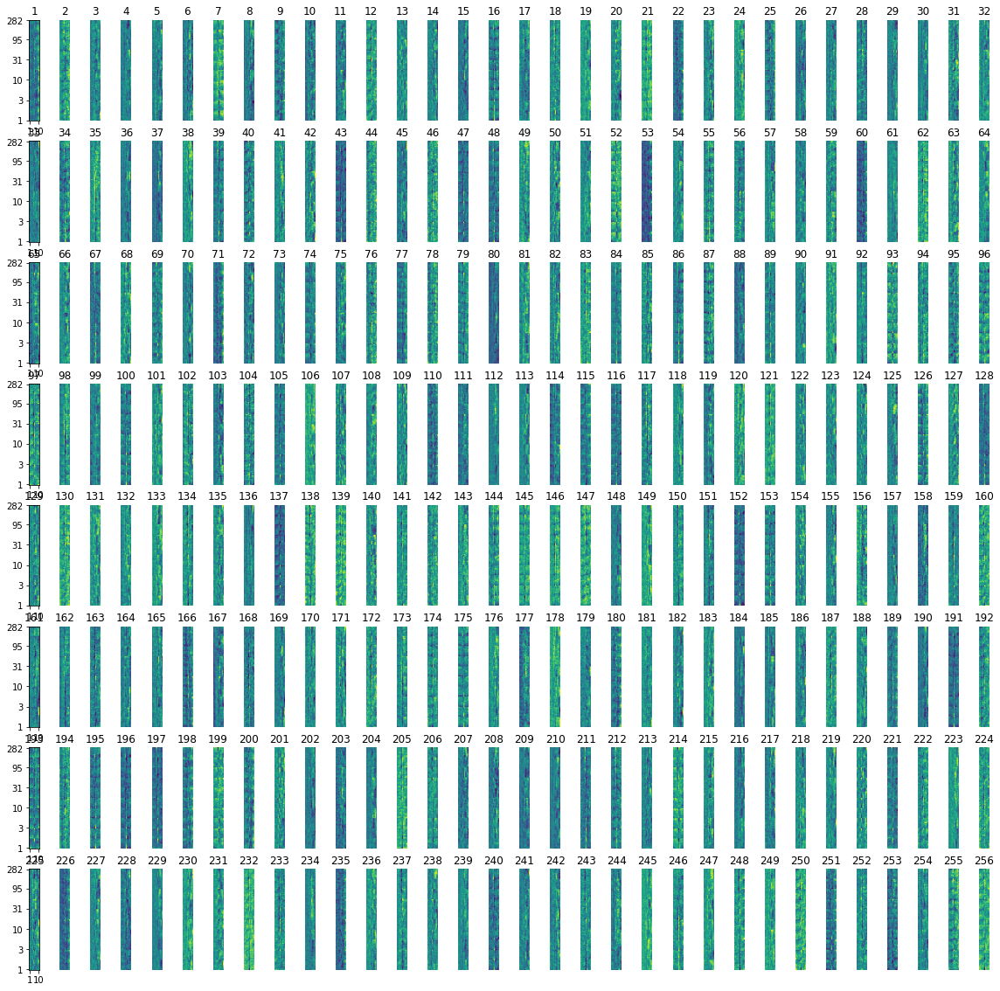

validation loss:0.2589702010154724 accuracy:0.9040785498489426
test loss:0.32005468010902405 accuracy:0.8883273557222041
0.74029994


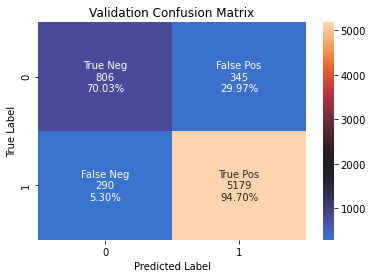

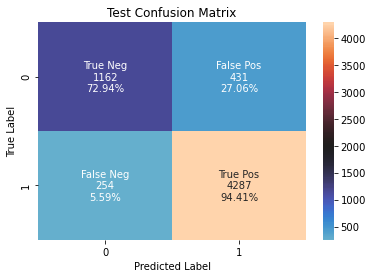

val loss:0.2589702010154724, val accuracy:0.9040785498489426, val percentage postive:0.8261329531669617


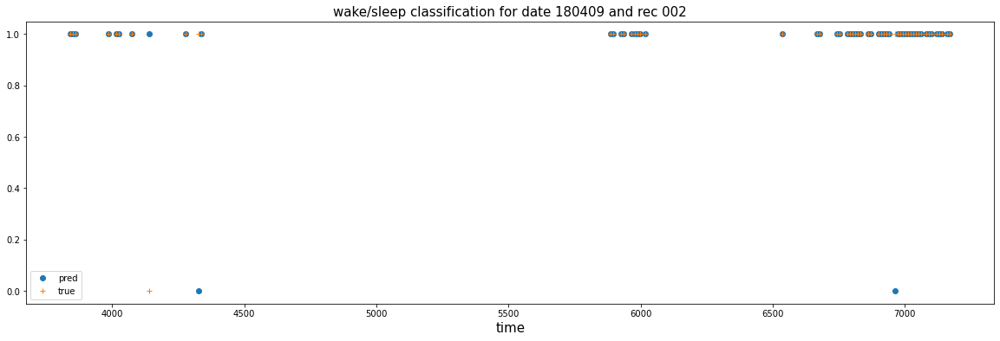

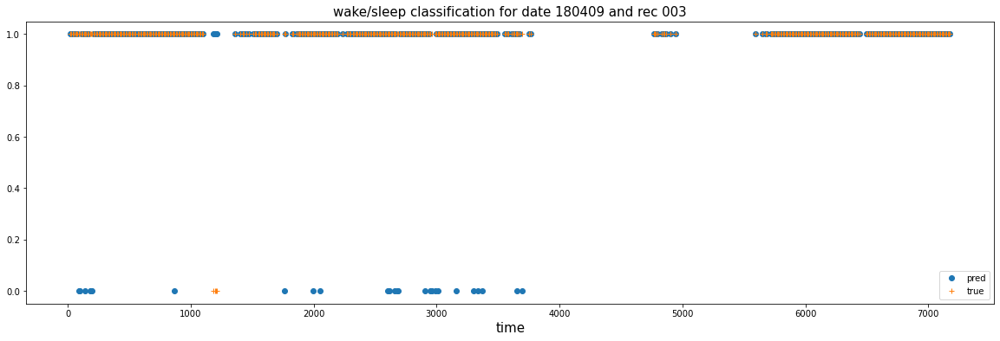

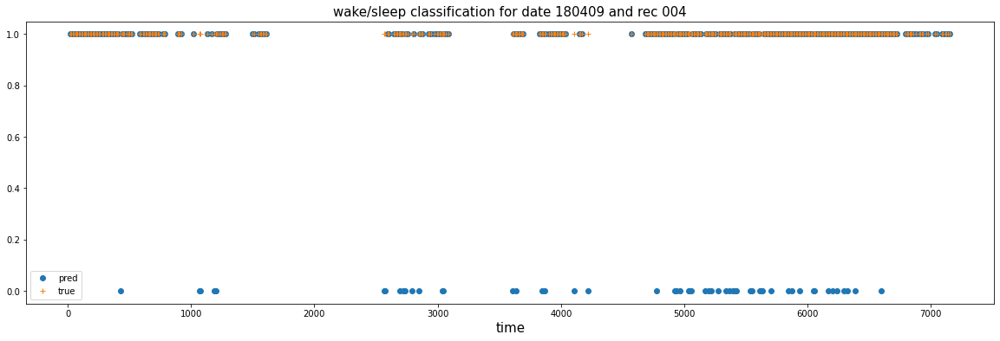

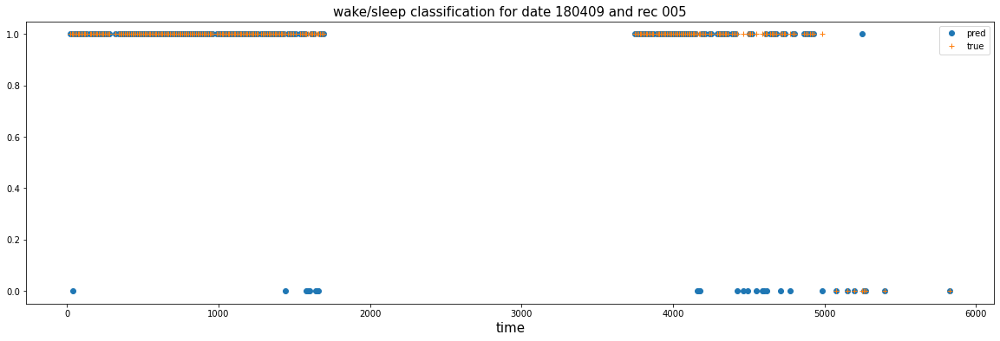

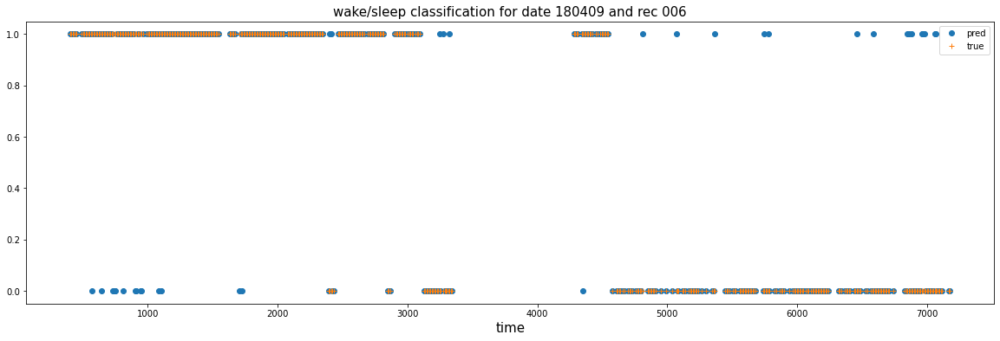

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.7_EPOCH11.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


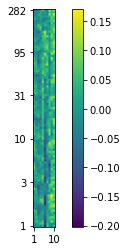

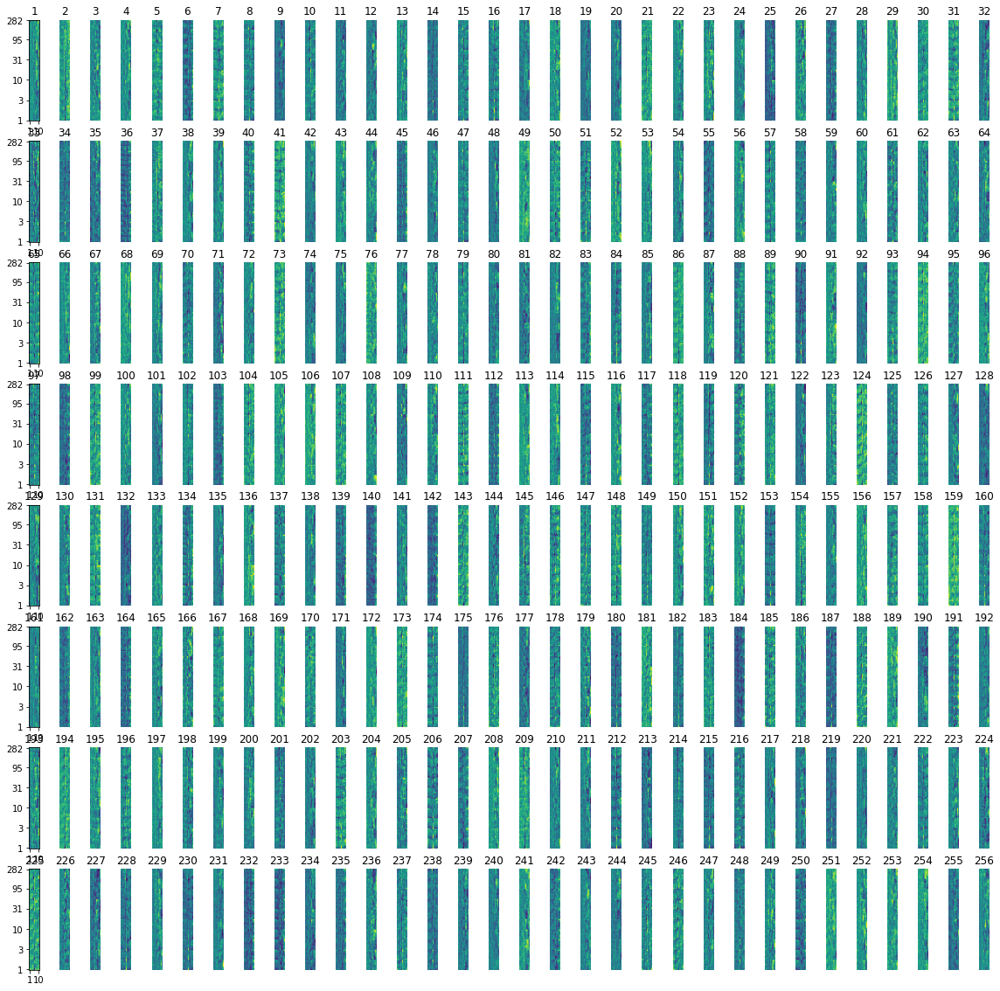

validation loss:0.24030375480651855 accuracy:0.9120845921450151
test loss:0.291565477848053 accuracy:0.9041408542549723
0.74029994


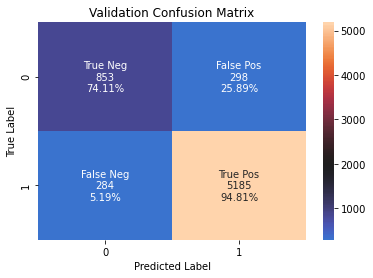

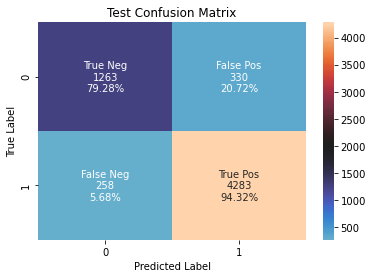

val loss:0.24030375480651855, val accuracy:0.9120845921450151, val percentage postive:0.8261329531669617


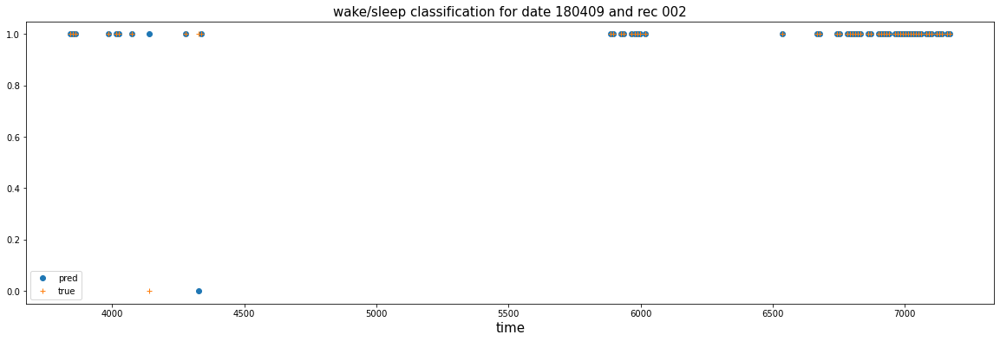

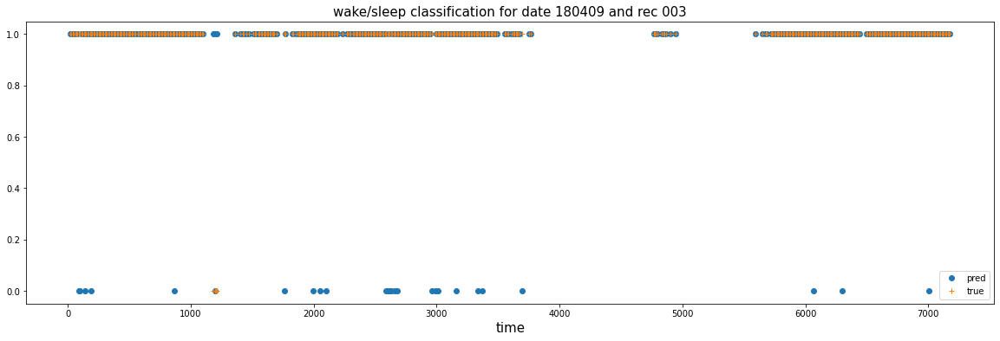

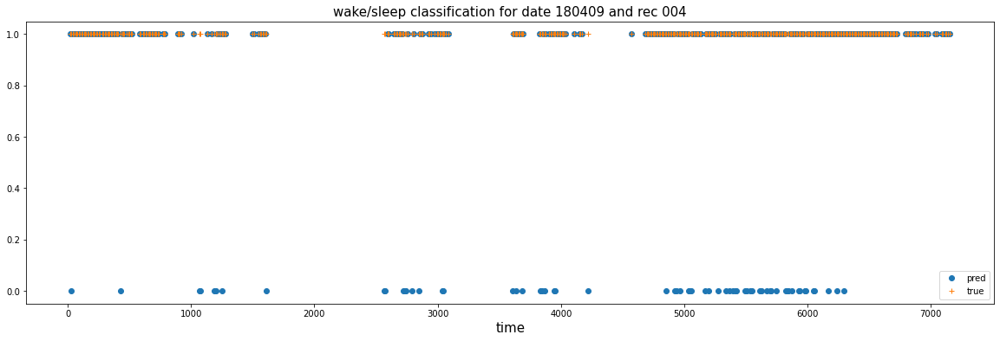

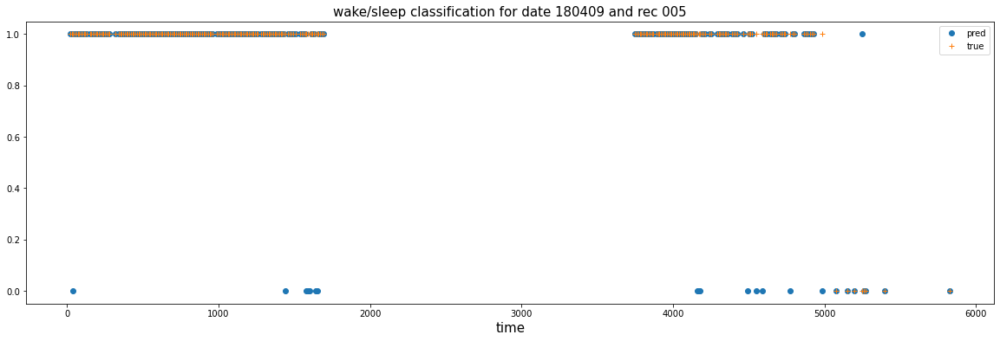

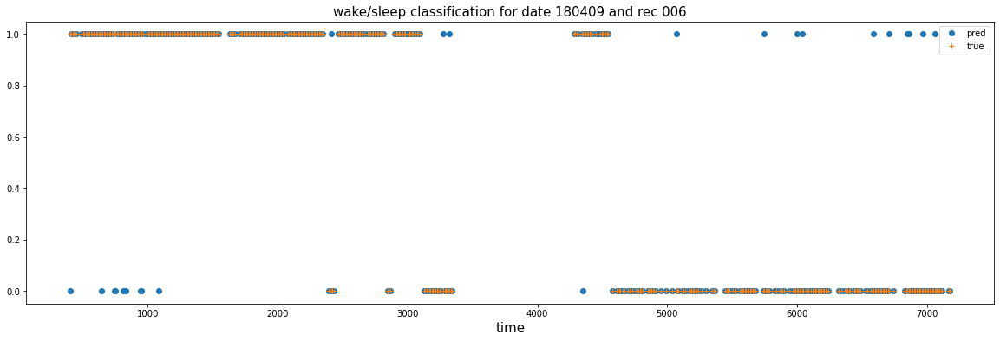

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.9_EPOCH45.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


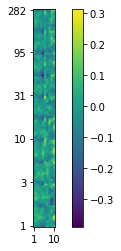

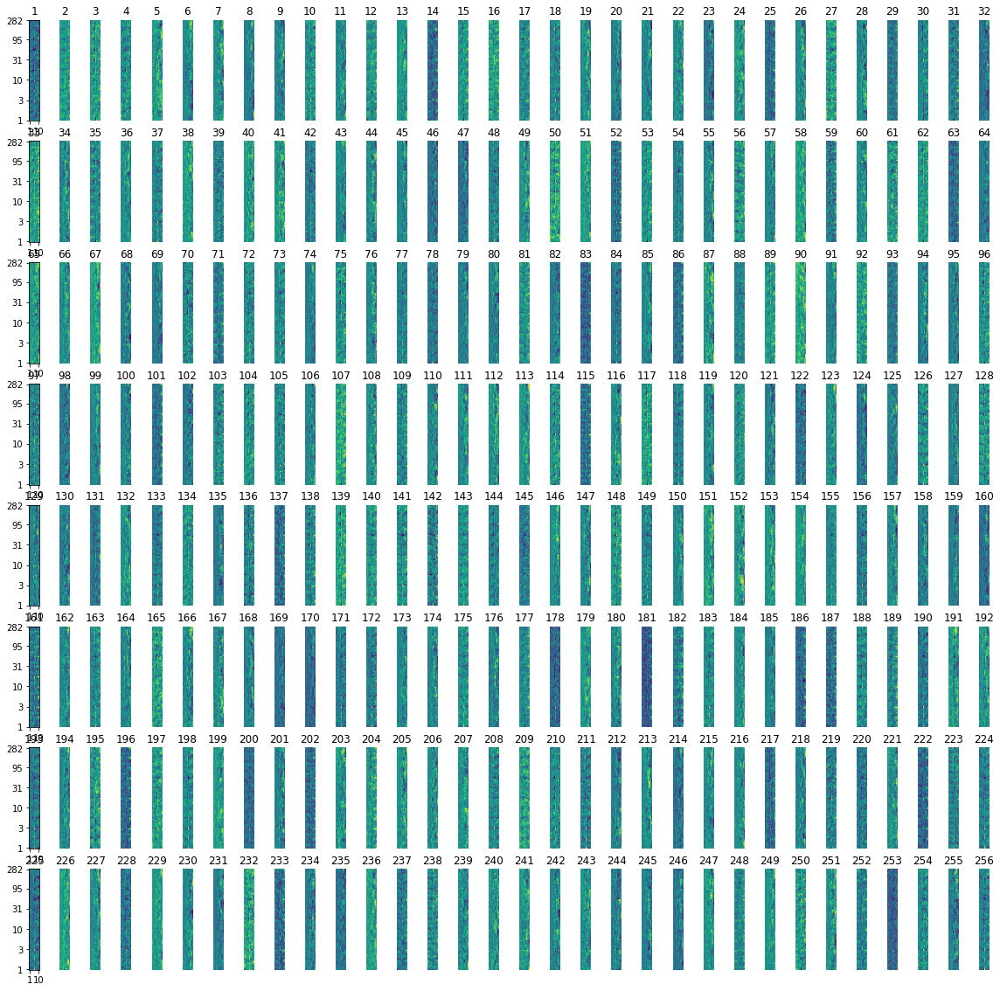

validation loss:0.2414856255054474 accuracy:0.9049848942598188
test loss:0.2851131558418274 accuracy:0.8976198239321813
0.74029994


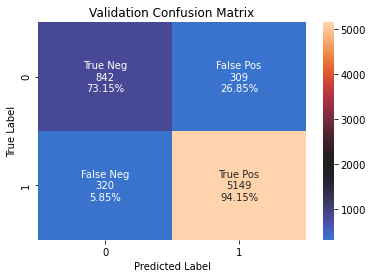

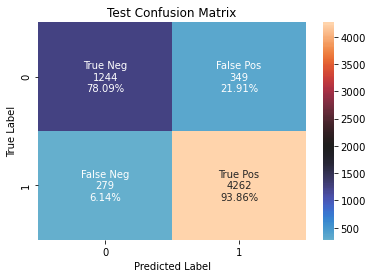

val loss:0.2414856255054474, val accuracy:0.9049848942598188, val percentage postive:0.8261329531669617


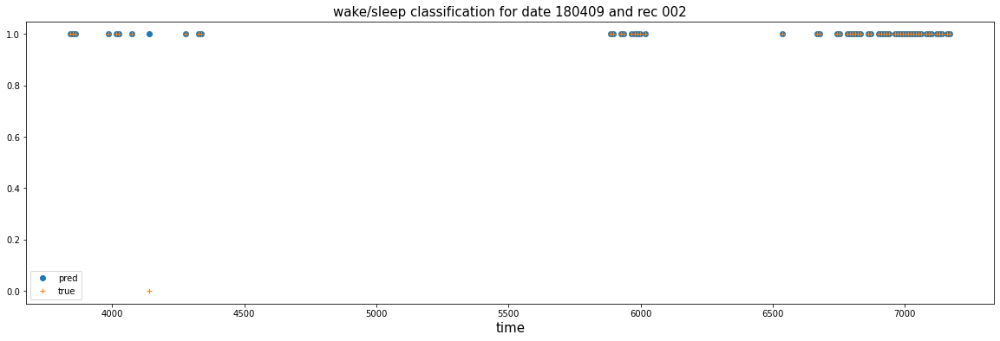

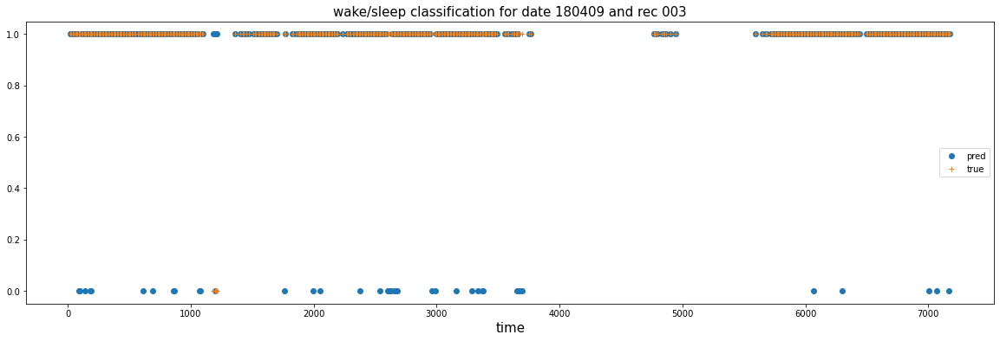

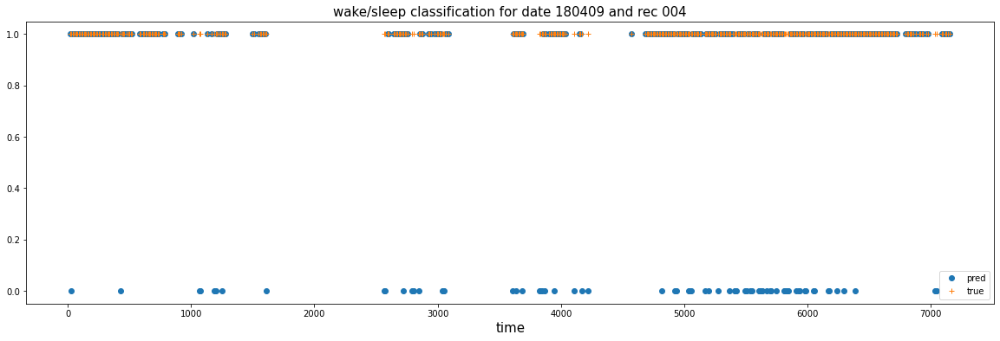

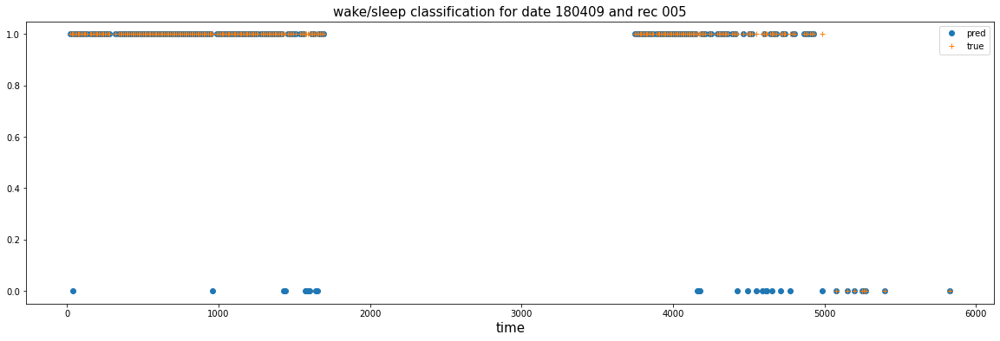

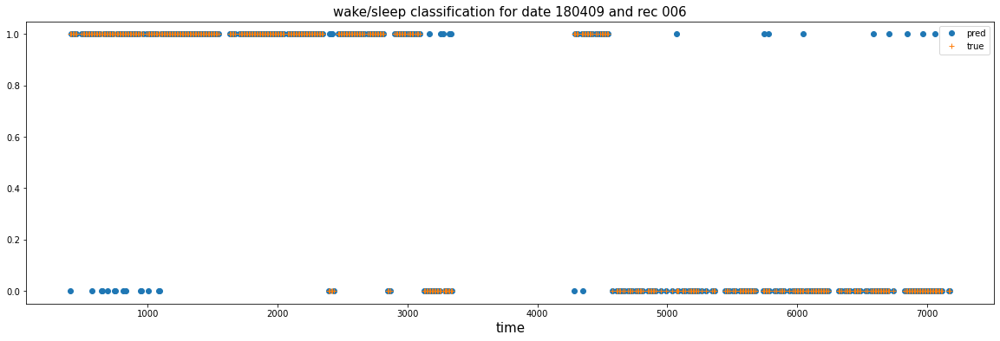

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO1_EPOCH0.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


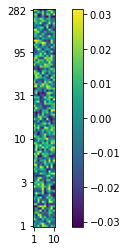

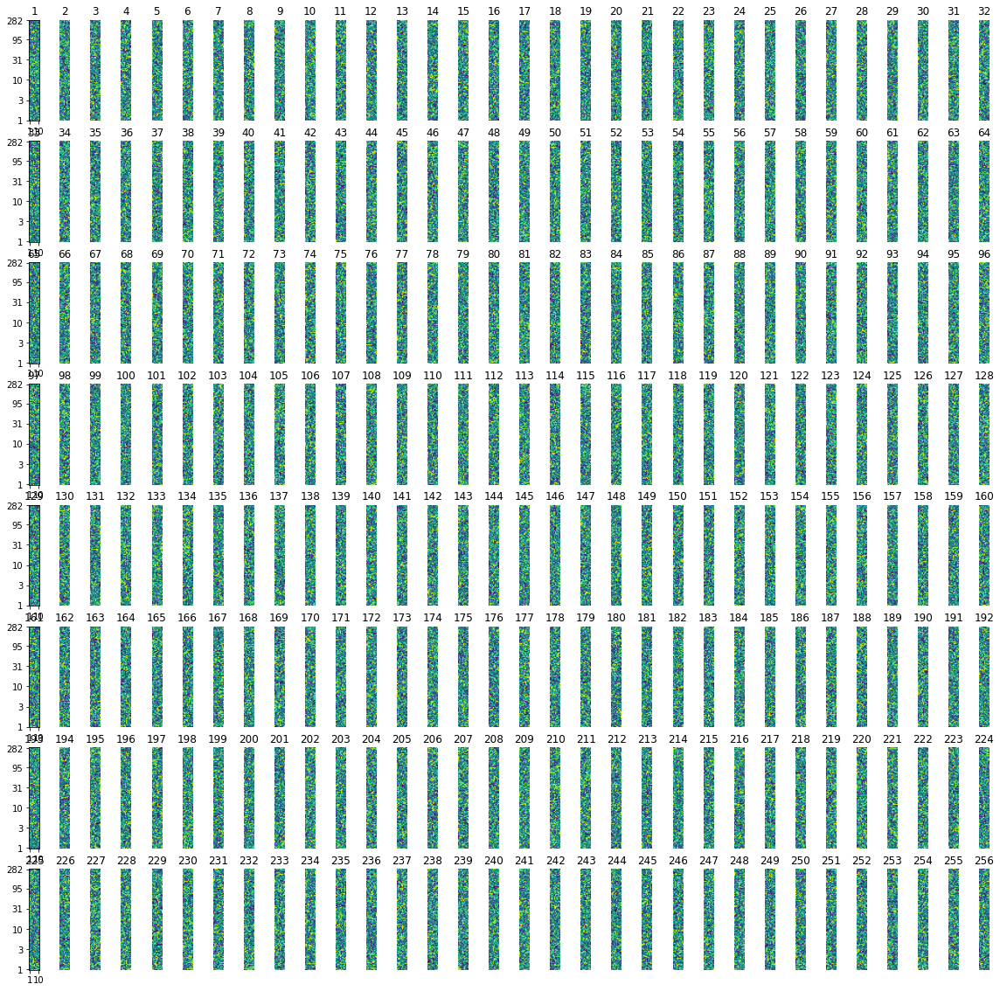

validation loss:0.7940806150436401 accuracy:0.18610271903323264
test loss:0.7716144323348999 accuracy:0.2764916856863384
0.74029994


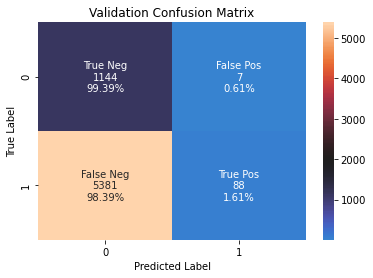

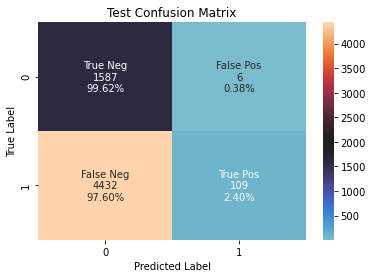

val loss:0.7940806150436401, val accuracy:0.18610271903323264, val percentage postive:0.8261329531669617


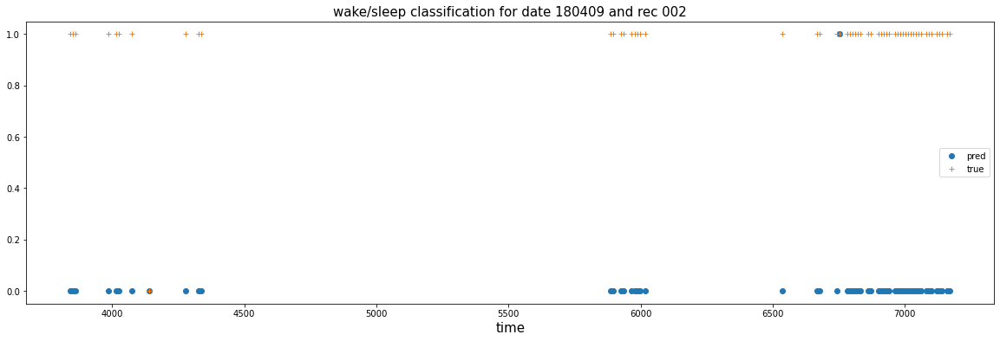

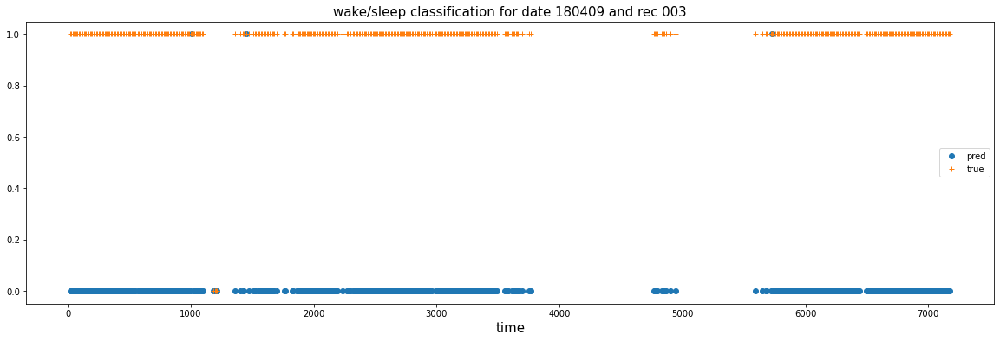

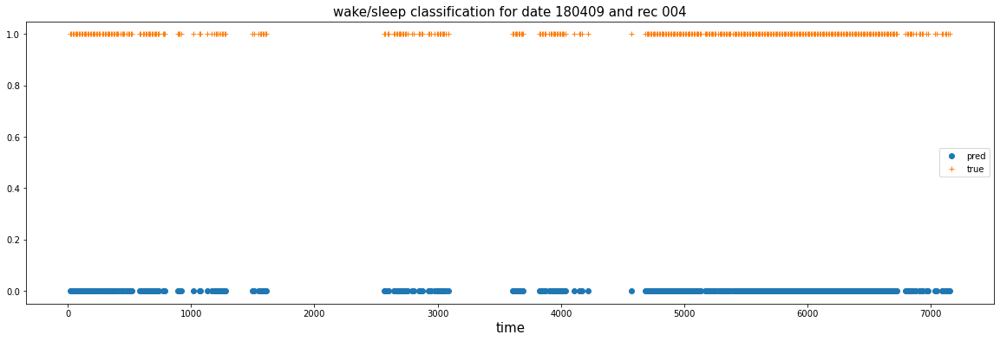

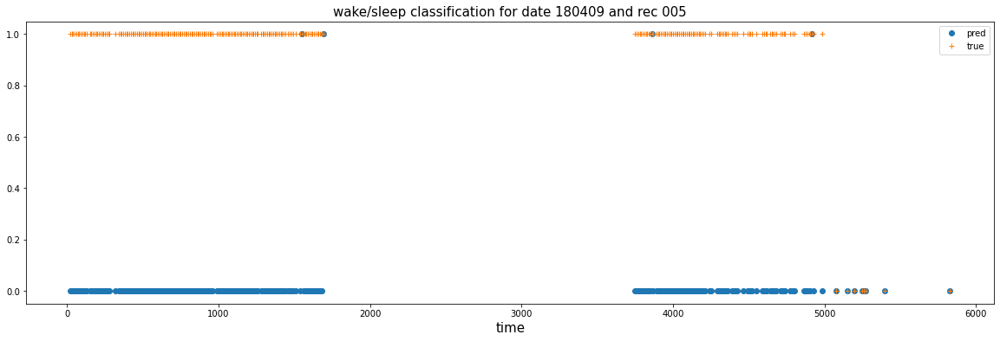

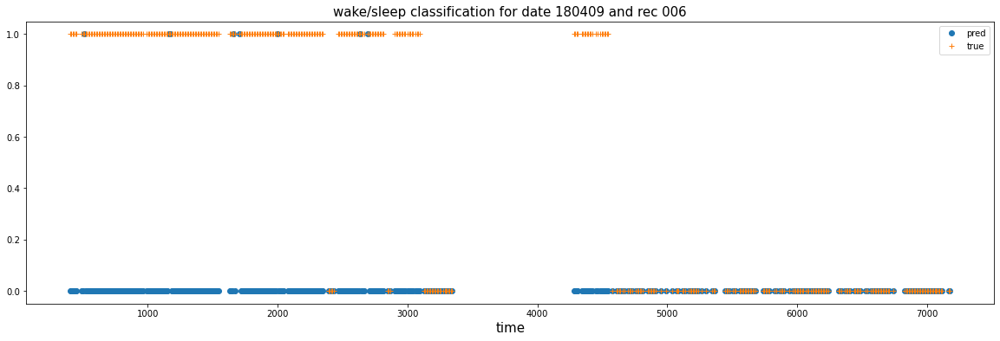

In [17]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    
    # Print Shape
    w1 = model.linear1.weight.view(256,10,100)
    w2 = model.linear2.weight
    print(w1.shape, w2.shape)
    w1 = w1.detach().cpu().numpy()
    w2 = w2.detach().cpu().numpy()
    w1[0].shape
    type(w1)
    
    # Print one feature
    print('One feature')
    plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
    plt.xticks(ticks=[0, 9], labels=[1, 10])
    plt.imshow(w1[1].transpose(),origin='lower')
    # plt.clim(-1.5, 1.5)
    plt.colorbar()
    plt.show()
    
    # All features
    timewindow = 10
    plt.figure(figsize=(20,20))
    ylabels_list = [0,32,64,96,128,160,192,224,256] 
    for i in range(256):
        weights_sub = w1[i]
        plt.subplot(8,32,i+1)
        if i in ylabels_list:
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, timewindow-1], labels=[1, timewindow])
        else:
            plt.axis('off')
    #     plt.imshow(weights_sub)
        plt.imshow(w1[i].transpose(),origin='lower')
        plt.title(str(i+1))
    plt.show()
    
    
    ## Calculate accuracy and validation loss
    val_loss, val_acc, val_preds, val_preds_probs, val_labels,_,_,_, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('validation loss:{} accuracy:{}'.format(val_loss, val_acc))

    ## Calculate test accuracy and test loss
    test_loss, test_acc, test_preds, test_preds_probs, test_labels,_,_,_, cases_wrong_2 = evaluate(model, optimizer, test_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('test loss:{} accuracy:{}'.format(test_loss, test_acc))
    print(np.mean(np.concatenate(test_labels)))
    
    ## Confusion matrix - Validation
    predictions_val = np.concatenate(val_preds)
    labels_val = np.concatenate(val_labels)

    df_val = pd.DataFrame({'predictions': predictions_val, 'labels': labels_val})

    cm_val = confusion_matrix(labels_val, predictions_val)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_val.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_val, annot=labels, fmt='', center = 2000)
    ax.set_title('Validation Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Confusion matrix-test
    predictions_test = np.concatenate(test_preds)
    labels_test = np.concatenate(test_labels)

    df_test = pd.DataFrame({'predictions': predictions_test, 'labels': labels_test})

    cm_test = confusion_matrix(labels_test, predictions_test)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_test.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_test, annot=labels, fmt='', center = 2000)
    ax.set_title('Test Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.1_EPOCH4.pt
val loss:0.2958032488822937, val accuracy:0.9013595166163142, val percentage postive:0.8261329531669617


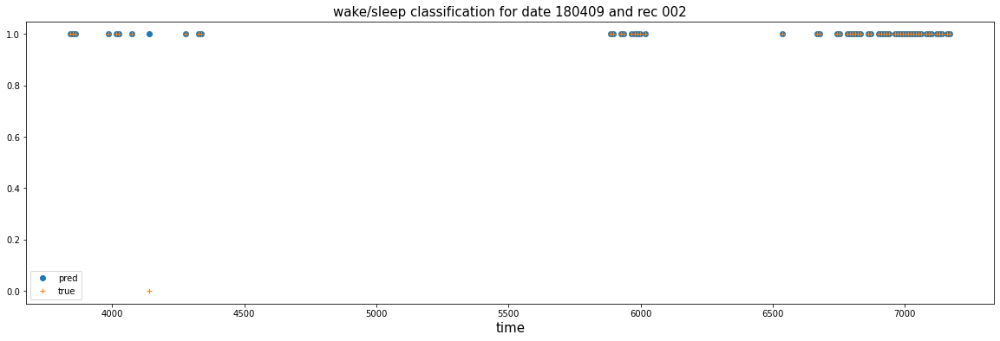

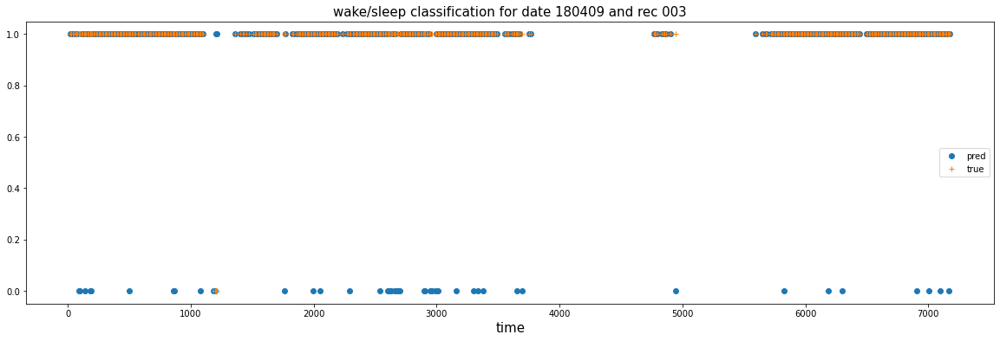

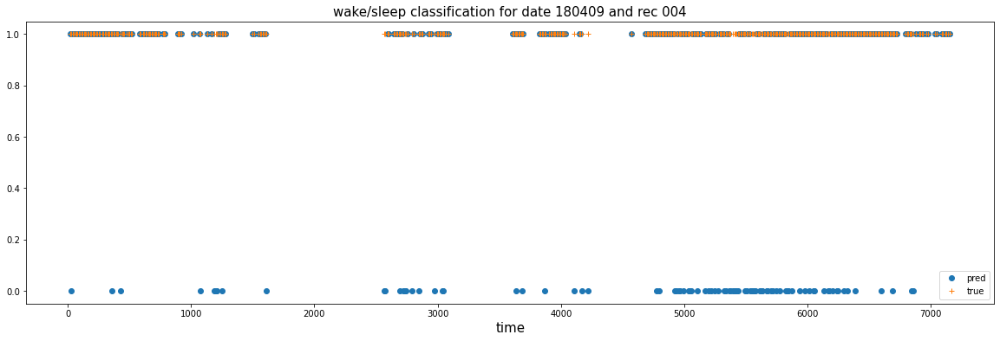

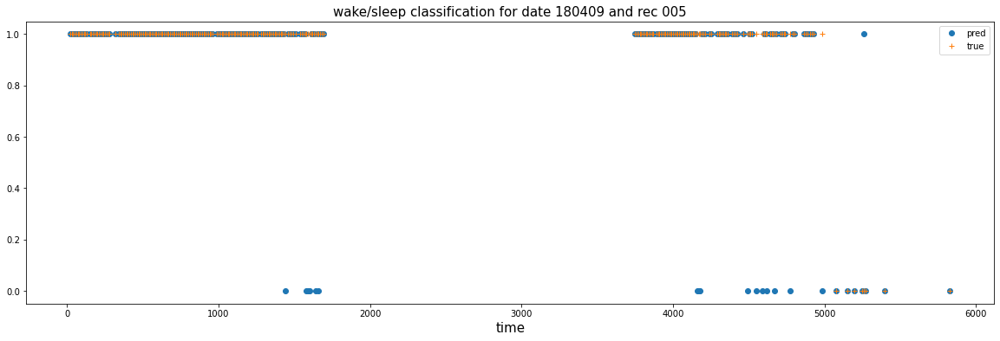

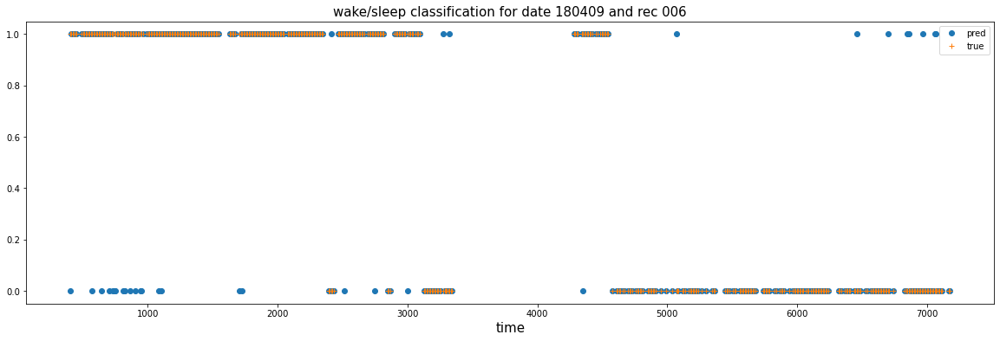

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.3_EPOCH3.pt
val loss:0.28227150440216064, val accuracy:0.8989425981873111, val percentage postive:0.8261329531669617


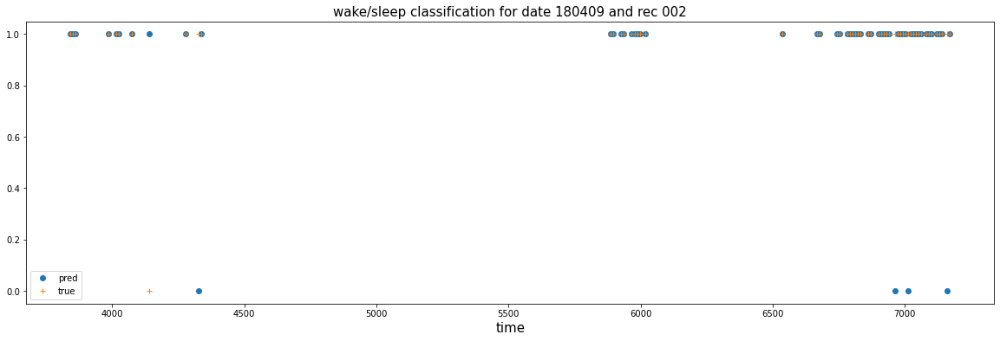

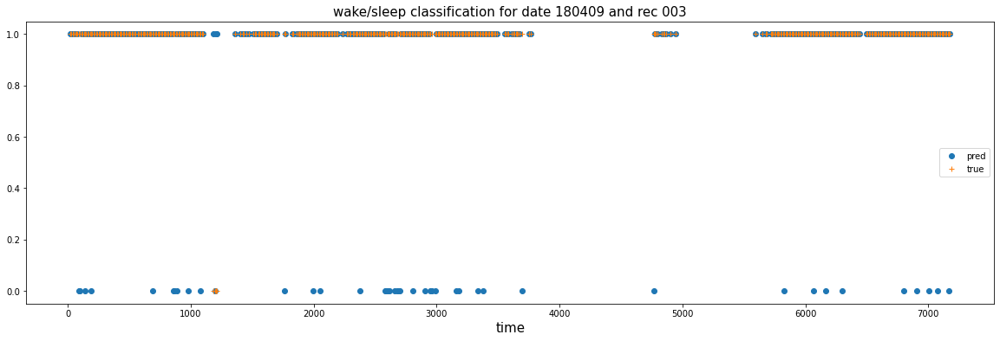

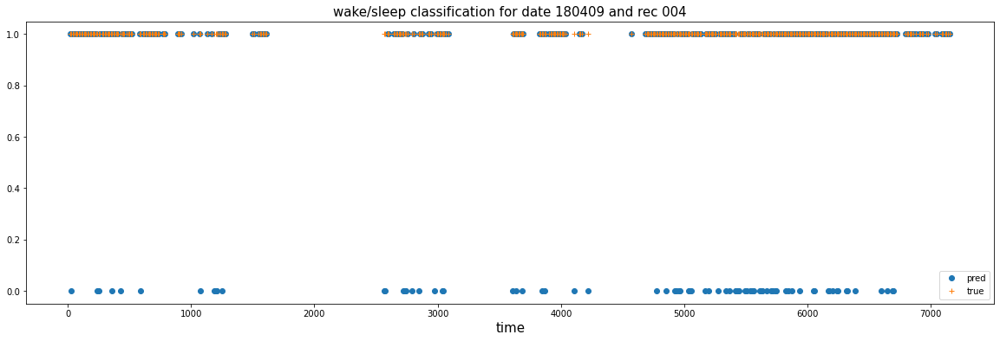

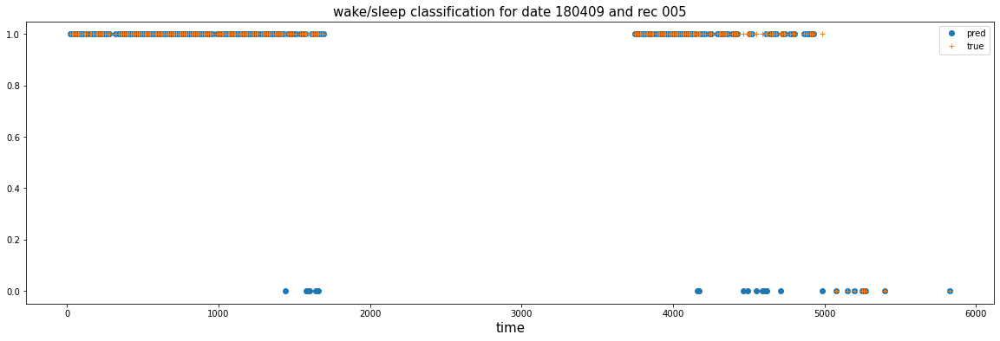

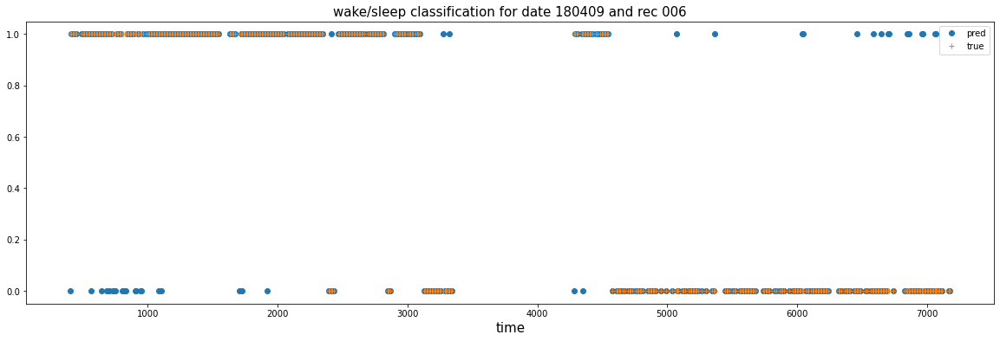

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.5_EPOCH4.pt
val loss:0.2589702010154724, val accuracy:0.9040785498489426, val percentage postive:0.8261329531669617


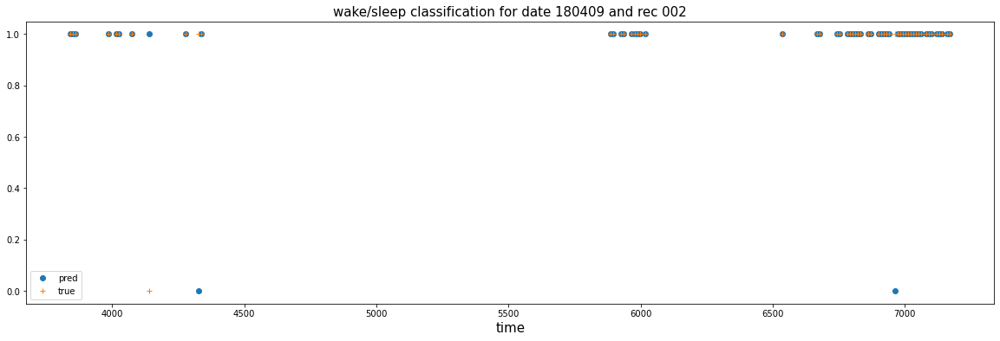

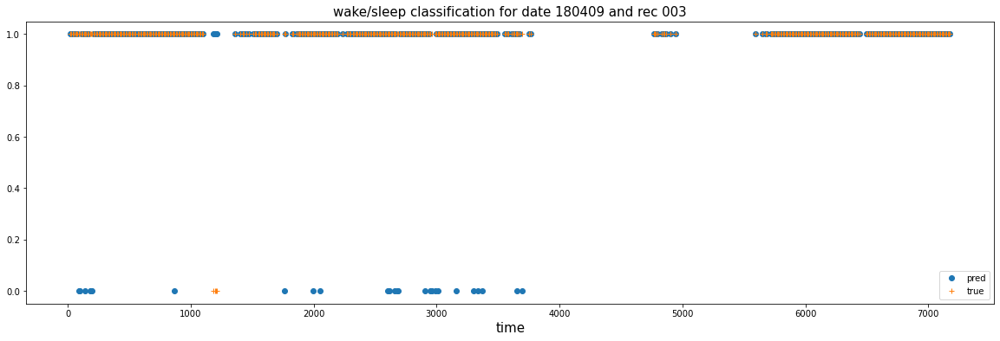

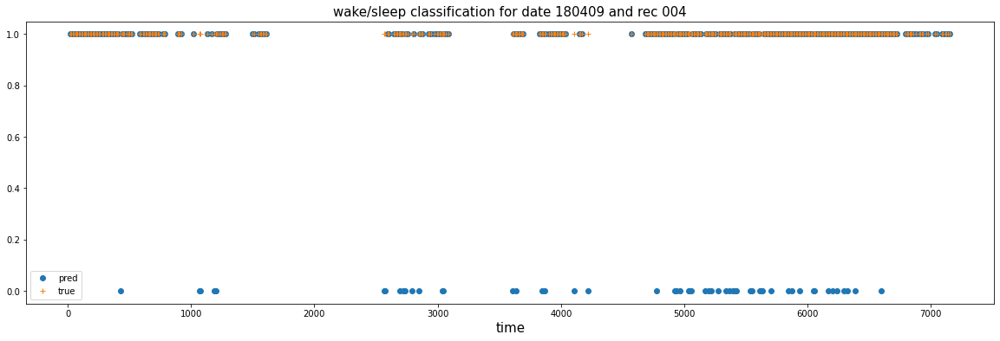

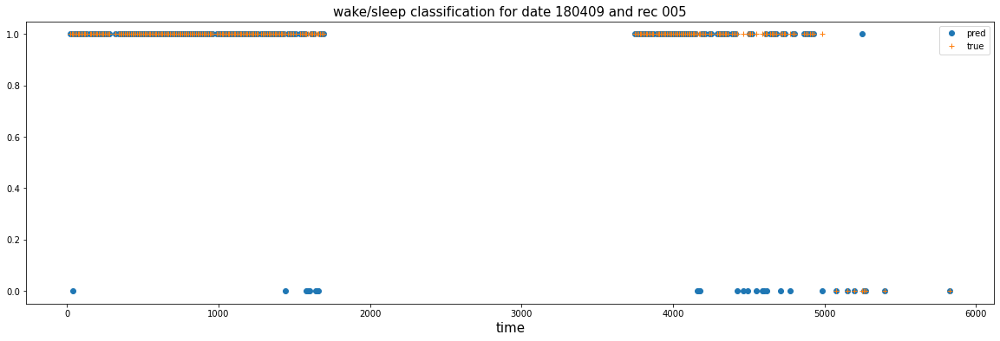

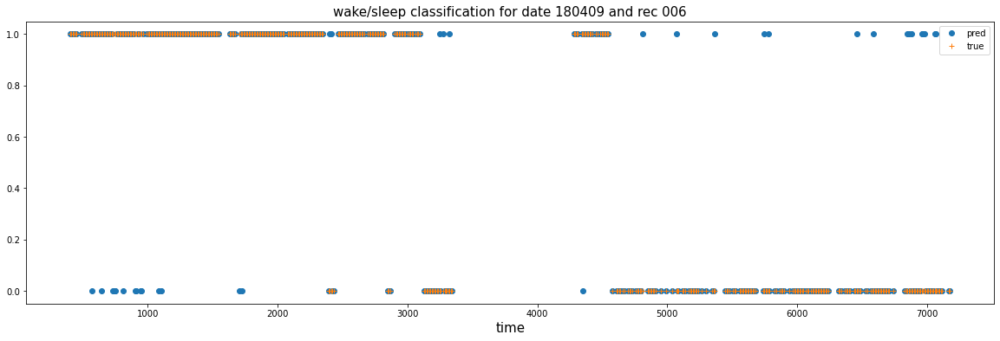

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.7_EPOCH11.pt
val loss:0.24030375480651855, val accuracy:0.9120845921450151, val percentage postive:0.8261329531669617


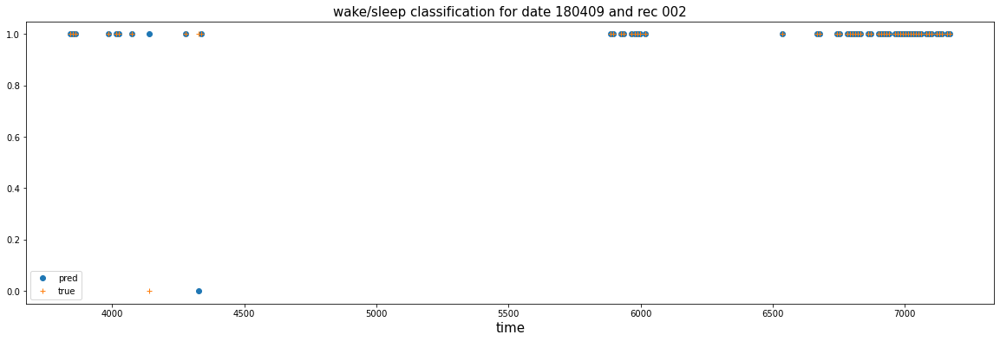

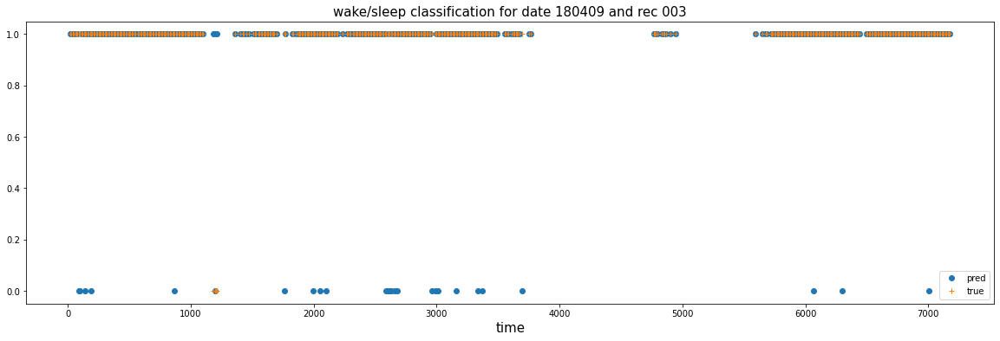

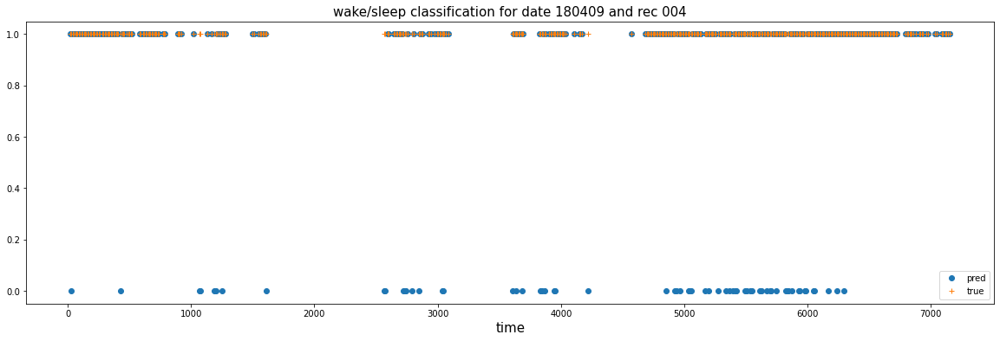

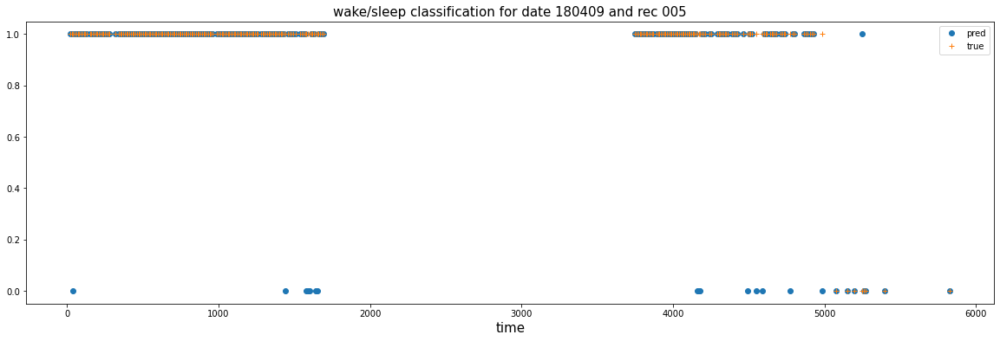

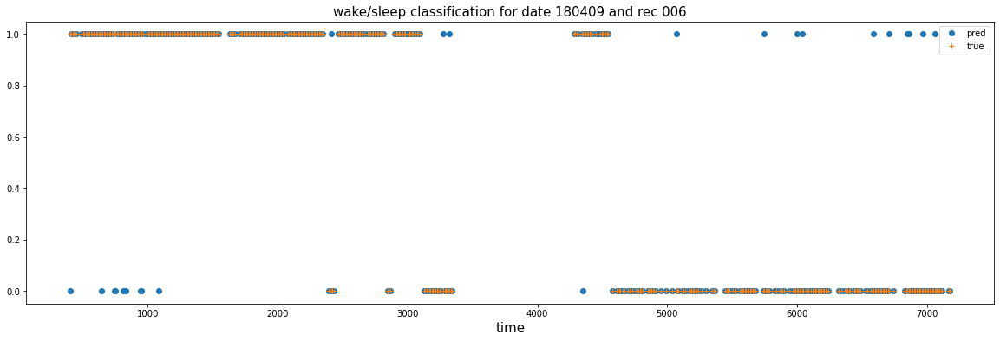

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO0.9_EPOCH45.pt
val loss:0.24148565530776978, val accuracy:0.9049848942598188, val percentage postive:0.8261329531669617


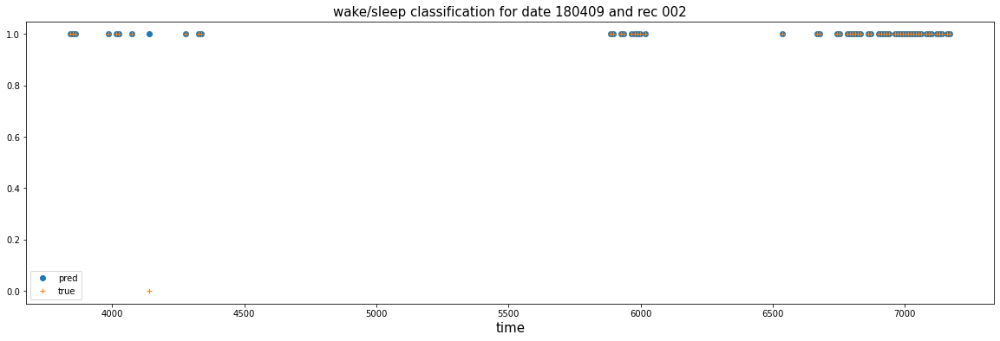

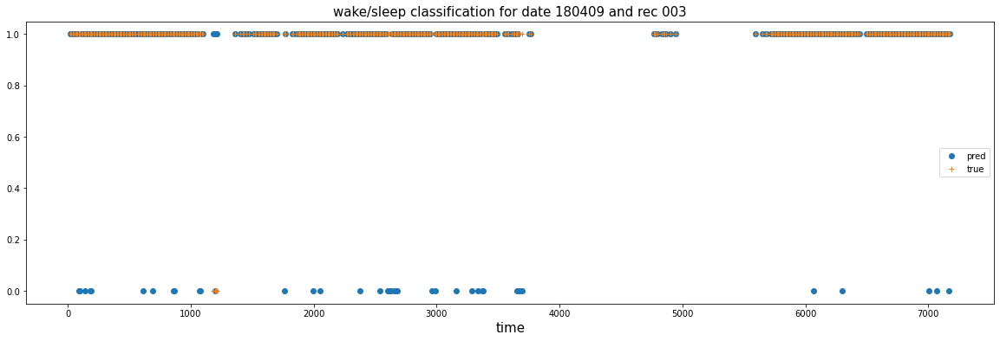

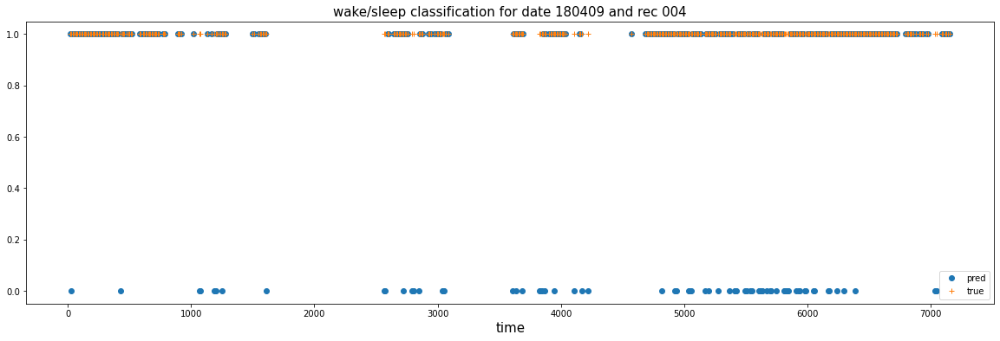

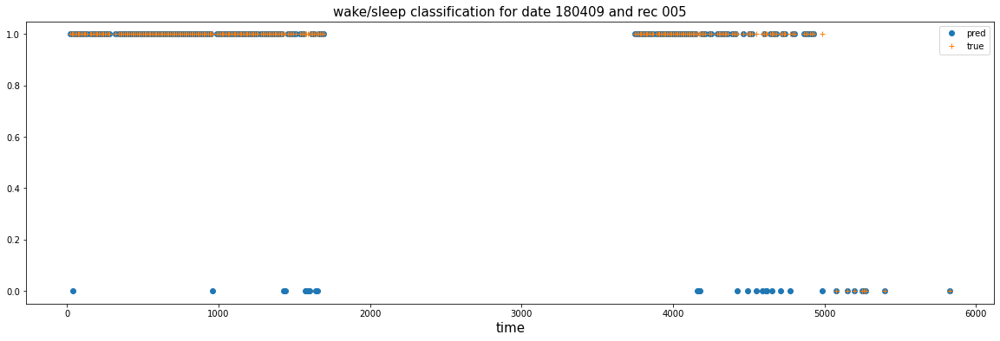

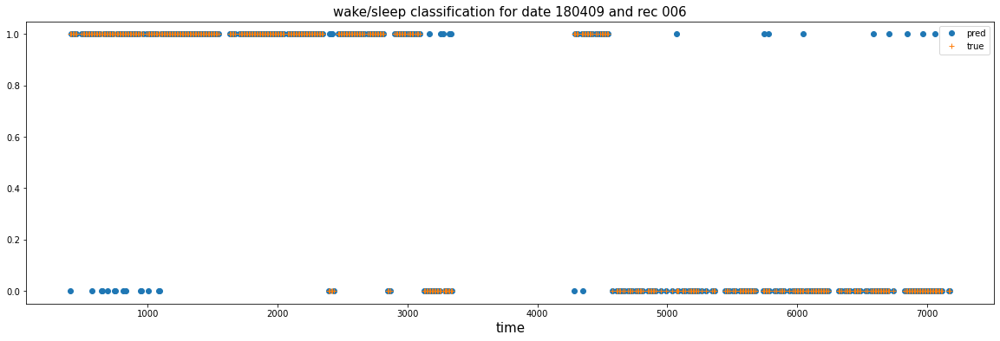

/home/bijanadmin/Desktop/Goose_data/data_Goose_all_2/Goose_ANN_models/MLP_CH23_LOSSbce_REGnone0_DO1_EPOCH0.pt
val loss:0.7940808534622192, val accuracy:0.18610271903323264, val percentage postive:0.8261329531669617


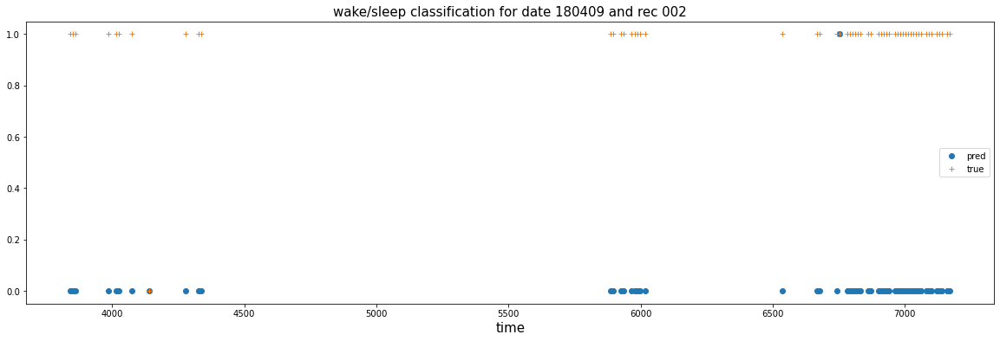

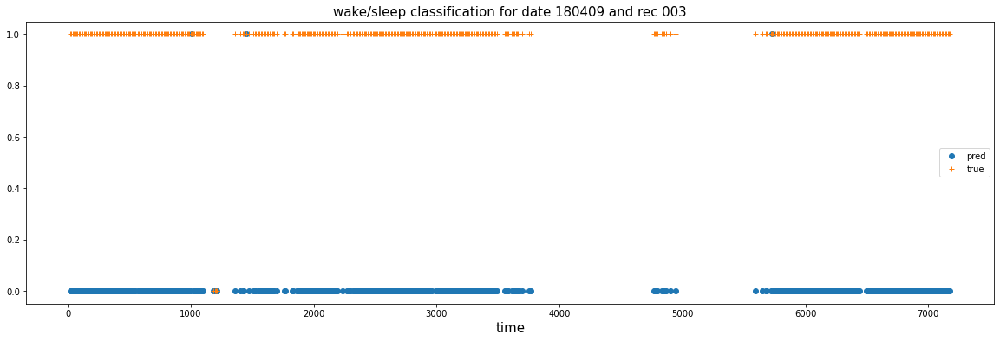

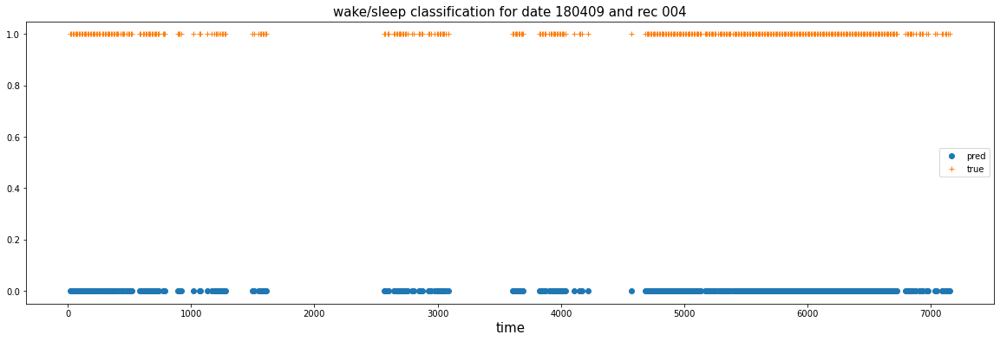

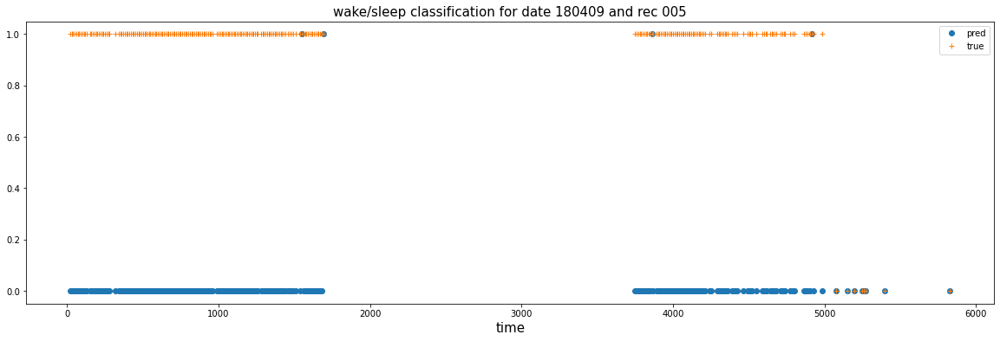

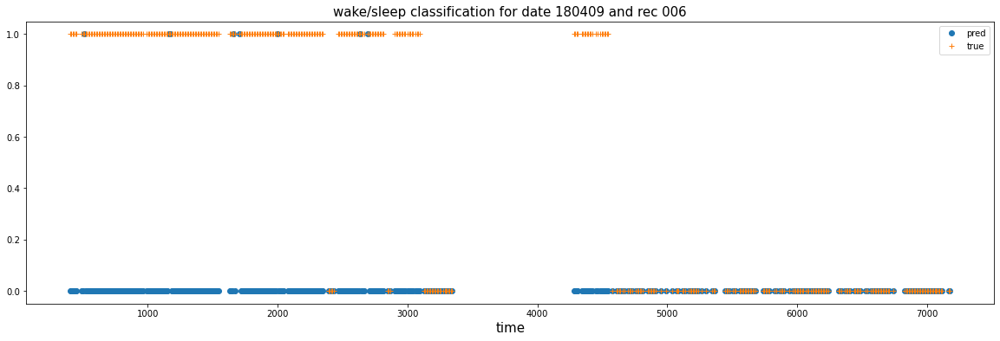

In [14]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

# train on Goose and test on Jesper

In [18]:
CH = 23
device = torch.device('cuda')
val_dates = ['171021','171023','180711','180714']
test_dates = ['171020','171022','180712', '180713']
bad_dates = ['180326', '180328', '171019', '180715', '180716', '180717']
#load_path = '/home/bijanadmin/Desktop/Goose_data/data_Goose_1st_2/'
load_path = '/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/'
# save_path = '/mnt/pesaranlab/People/Capstone_students/Yue/model/model_Goose_1st_2_upsample'
save_path = '/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model'
model_name = 'MLP_all_ch_Drop_03'

train_files, val_files, test_files = create_files(load_path, val_dates, test_dates, bad_dates)
train_loader, val_loader, test_loader = create_dataloaders(train_files, val_files, test_files, load_path, batch_size=256, CH = CH)

In [19]:
len(train_loader), len(val_loader), len(test_loader)

(251, 24, 25)

In [20]:
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader): # check shapes
    print(data.shape)
    print(label.shape)
    print(len(date))
    print(len(rec))
    print(len(time))
    break

torch.Size([256, 1, 100, 10])
torch.Size([256, 1])
256
256
256


date:180325, rec:009, time:2430.0, label:0.0


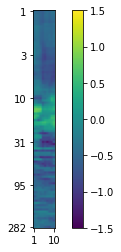

date:180414, rec:001, time:2449.0, label:0.0


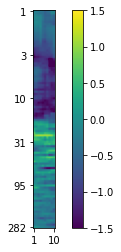

date:180410, rec:003, time:5635.0, label:1.0
date:180330, rec:005, time:1186.0, label:1.0
date:180327, rec:007, time:6571.0, label:0.0


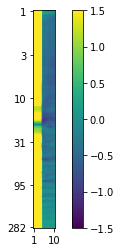

date:180412, rec:002, time:3287.0, label:1.0
date:180410, rec:003, time:781.0, label:1.0
date:180330, rec:001, time:1846.0, label:1.0
date:180327, rec:007, time:3850.0, label:0.0


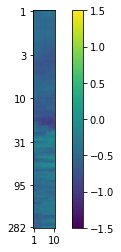

date:180410, rec:005, time:457.0, label:1.0
date:180324, rec:004, time:6943.0, label:1.0
date:180325, rec:009, time:2130.0, label:0.0


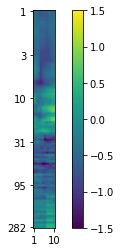

date:180325, rec:007, time:2806.0, label:0.0


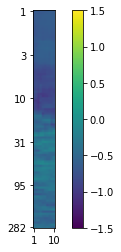

date:180330, rec:003, time:2241.0, label:1.0
date:180325, rec:002, time:1090.0, label:0.0


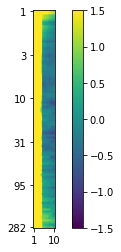

date:180401, rec:001, time:5237.0, label:0.0


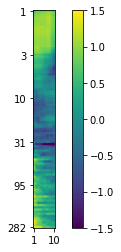

date:180413, rec:001, time:6017.0, label:0.0


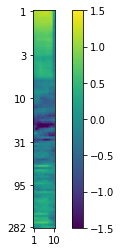

date:180324, rec:008, time:3008.0, label:0.0


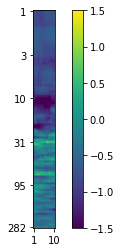

date:180327, rec:007, time:5631.0, label:0.0


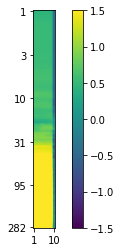

date:180413, rec:002, time:240.0, label:0.0


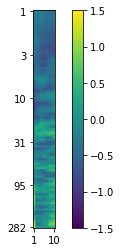

date:180414, rec:007, time:5248.0, label:0.0


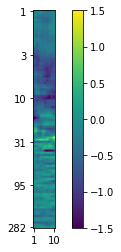

date:180322, rec:003, time:6246.0, label:1.0
date:180413, rec:003, time:1090.0, label:0.0


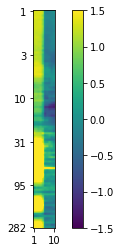

date:180322, rec:002, time:5164.0, label:1.0
date:180330, rec:006, time:3382.0, label:1.0
date:180329, rec:005, time:2941.0, label:1.0
date:180325, rec:009, time:3886.0, label:1.0
date:180413, rec:004, time:2186.0, label:1.0
date:180329, rec:001, time:3331.0, label:1.0
date:180325, rec:005, time:1374.0, label:1.0
date:180324, rec:006, time:792.0, label:1.0
date:180414, rec:007, time:4087.0, label:0.0


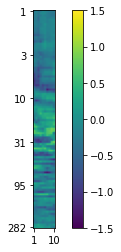

date:180413, rec:002, time:5661.0, label:0.0


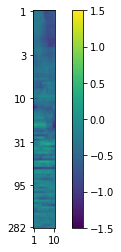

date:180325, rec:002, time:2985.0, label:1.0
date:180331, rec:007, time:5888.0, label:0.0


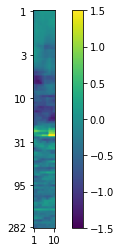

date:180414, rec:001, time:2429.0, label:0.0


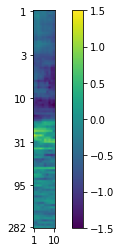

date:180413, rec:002, time:1550.0, label:0.0


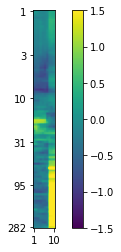

date:180410, rec:002, time:5482.0, label:1.0
date:180327, rec:007, time:6051.0, label:0.0


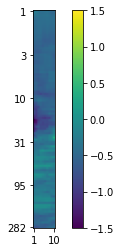

date:180411, rec:002, time:3135.0, label:1.0
date:180331, rec:003, time:5668.0, label:1.0
date:180331, rec:003, time:3618.0, label:1.0
date:180331, rec:007, time:4277.0, label:0.0


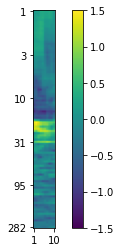

date:180322, rec:005, time:40.0, label:1.0
date:180401, rec:001, time:4717.0, label:1.0
date:180325, rec:009, time:3676.0, label:1.0
date:180413, rec:003, time:4948.0, label:0.0


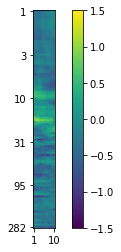

date:180413, rec:002, time:3611.0, label:0.0


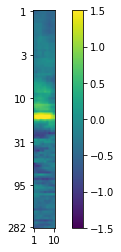

date:180331, rec:005, time:6859.0, label:1.0
date:180331, rec:004, time:4777.0, label:1.0
date:180327, rec:007, time:3700.0, label:0.0


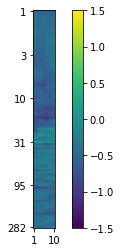

date:180413, rec:003, time:50.0, label:0.0


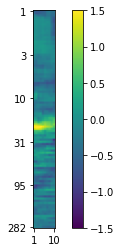

date:180410, rec:006, time:2396.0, label:1.0
date:180322, rec:005, time:7159.0, label:1.0
date:180411, rec:003, time:537.0, label:1.0
date:180414, rec:005, time:4261.0, label:1.0
date:180331, rec:007, time:3857.0, label:0.0


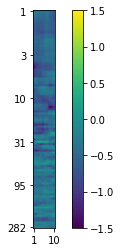

date:180325, rec:007, time:4673.0, label:0.0


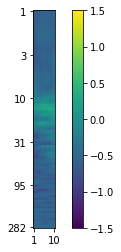

date:180327, rec:001, time:7102.0, label:0.0


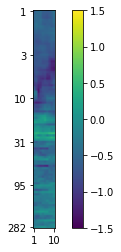

date:180331, rec:007, time:3217.0, label:0.0


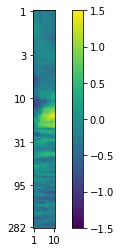

date:180411, rec:007, time:380.0, label:0.0


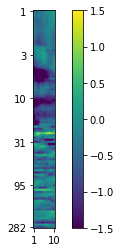

date:180413, rec:001, time:5472.0, label:1.0
date:180330, rec:007, time:1312.0, label:1.0
date:180331, rec:001, time:1720.0, label:0.0


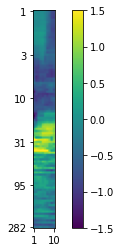

date:180413, rec:001, time:6457.0, label:0.0


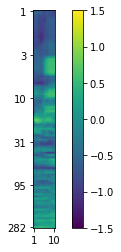

date:180324, rec:008, time:1971.0, label:0.0


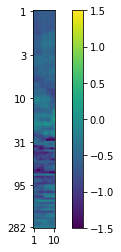

date:180330, rec:001, time:2812.0, label:1.0
date:180324, rec:006, time:1523.0, label:1.0
date:180411, rec:003, time:357.0, label:1.0
date:180329, rec:001, time:2079.0, label:1.0
date:180325, rec:005, time:4903.0, label:1.0
date:180414, rec:007, time:5648.0, label:0.0


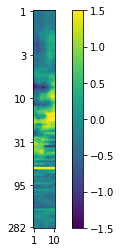

date:180329, rec:001, time:3321.0, label:1.0
date:180330, rec:004, time:5037.0, label:1.0
date:180409, rec:004, time:7125.0, label:1.0
date:180324, rec:004, time:5606.0, label:0.0


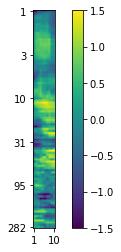

date:180413, rec:001, time:1880.0, label:0.0


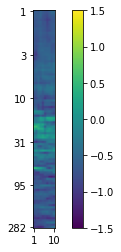

date:180324, rec:008, time:2201.0, label:0.0


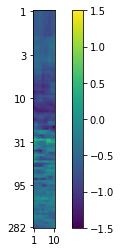

date:180413, rec:004, time:4266.0, label:0.0


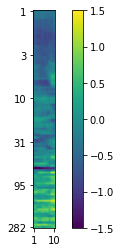

date:180330, rec:009, time:975.0, label:1.0
date:180329, rec:002, time:1066.0, label:1.0
date:180410, rec:002, time:4239.0, label:1.0
date:180411, rec:006, time:591.0, label:1.0
date:180410, rec:002, time:4521.0, label:1.0
date:180410, rec:005, time:4332.0, label:1.0
date:180330, rec:009, time:40.0, label:1.0
date:180414, rec:007, time:2147.0, label:0.0


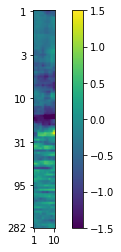

date:180413, rec:001, time:6007.0, label:0.0


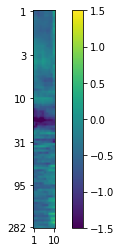

date:180330, rec:006, time:1762.0, label:0.0


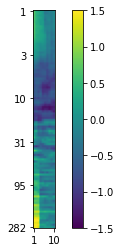

date:180331, rec:004, time:3945.0, label:1.0
date:180413, rec:002, time:6141.0, label:0.0


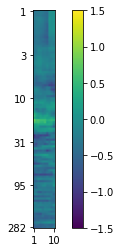

date:180412, rec:006, time:5758.0, label:0.0


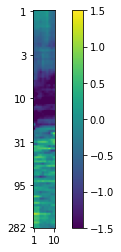

date:180325, rec:001, time:7061.0, label:1.0
date:180324, rec:008, time:2648.0, label:0.0


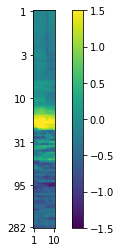

date:180414, rec:004, time:2946.0, label:1.0
date:180327, rec:001, time:2320.0, label:0.0


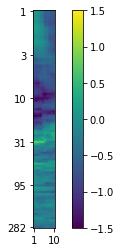

date:180325, rec:002, time:6609.0, label:1.0
date:180401, rec:001, time:4487.0, label:1.0
date:180410, rec:003, time:3410.0, label:1.0
date:180327, rec:006, time:1110.0, label:1.0
date:180323, rec:002, time:5435.0, label:1.0
date:180413, rec:002, time:6321.0, label:0.0


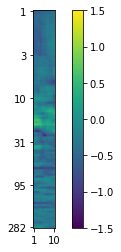

date:180322, rec:007, time:4110.0, label:0.0


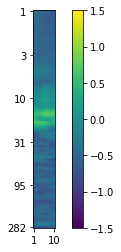

date:180323, rec:007, time:2079.0, label:0.0


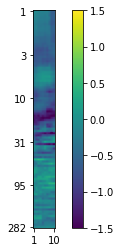

date:180411, rec:002, time:1250.0, label:1.0
date:180401, rec:001, time:6793.0, label:1.0
date:180325, rec:001, time:2210.0, label:0.0


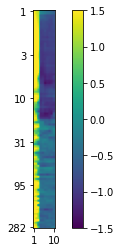

date:180322, rec:003, time:3538.0, label:1.0
date:180330, rec:006, time:1184.0, label:1.0
date:180414, rec:001, time:1610.0, label:0.0


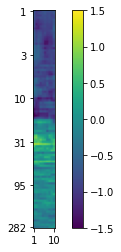

date:180329, rec:006, time:1684.0, label:1.0
date:180401, rec:001, time:7013.0, label:1.0
date:180409, rec:005, time:100.0, label:1.0
date:180330, rec:008, time:561.0, label:0.0


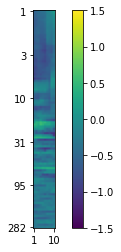

date:180409, rec:003, time:3339.0, label:1.0
date:180330, rec:009, time:6051.0, label:0.0


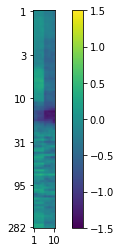

date:180411, rec:006, time:4546.0, label:1.0
date:180329, rec:001, time:6811.0, label:1.0
date:180330, rec:009, time:1894.0, label:0.0


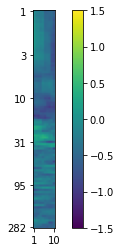

date:180413, rec:002, time:6831.0, label:0.0


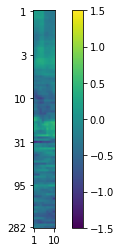

date:180330, rec:009, time:6581.0, label:0.0


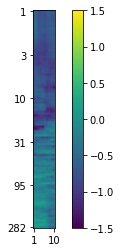

date:180330, rec:006, time:2051.0, label:1.0
date:180330, rec:008, time:6575.0, label:0.0


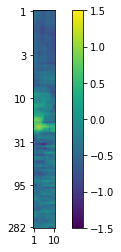

date:180410, rec:004, time:1928.0, label:1.0
date:180325, rec:005, time:183.0, label:0.0


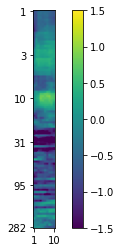

date:180322, rec:007, time:4340.0, label:0.0


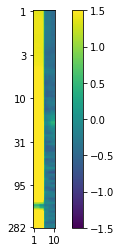

date:180409, rec:003, time:2589.0, label:1.0
date:180329, rec:004, time:2484.0, label:1.0


In [21]:
# movement labelled 0; non-movement labelled 1
for batch_idx, (data, label, date, rec, time) in enumerate(train_loader):
    for i in range(128):
        print('date:{}, rec:{}, time:{}, label:{}'.format(date[i], rec[i], time[i], label[i][0].numpy()))
        if label[i][0].numpy() == 0.0:
            data_sub = data[i][0]
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, 9], labels=[1, 10])
            plt.imshow(data_sub)
            plt.clim(-1.5, 1.5)
            plt.colorbar()
            plt.show()
    break

In [22]:
class MLP(nn.Module): # add dropo
    def __init__(self, input_dim=100*10*62, output_dim=1, embed_dim=256,drop_prob=0.):
        super(MLP, self).__init__()
        self.linear1 = nn.Linear(input_dim, embed_dim)
        self.linear2 = nn.Linear(embed_dim, output_dim)
        self.dropout = nn.Dropout(drop_prob)
        
    def forward(self, x):
        
        x = x.reshape([x.shape[0], 1, -1]).float()
        x = self.dropout(F.relu(self.linear1(x)))
        outputs = self.linear2(x)
        
        return outputs

In [23]:
device = torch.device('cuda')

tol = 0.01
learning_rate = 0.001
num_epochs = 51
alpha = 0
model_type = 'MLP'
loss_type = 'bce'
reg_type = 'none'
input_dim = 1*10*100
embed_dim = 256
dropout_all = [0.1,0.3,0.5,0.7,0.9,1]




dropout:  0.1
Train loss for epoch 0: 0.3620263934135437
Val loss for epoch 0: 0.4477831721305847
Train loss for epoch 1: 0.26937684416770935
Val loss for epoch 1: 0.5756112933158875
Train loss for epoch 2: 0.22882823646068573
Val loss for epoch 2: 0.7119166851043701
Train loss for epoch 3: 0.2072085440158844
Val loss for epoch 3: 0.7447328567504883
Train loss for epoch 4: 0.19172769784927368
Val loss for epoch 4: 0.9464133977890015
Train loss for epoch 5: 0.17685148119926453
Val loss for epoch 5: 1.0179879665374756
Train loss for epoch 6: 0.17065772414207458
Val loss for epoch 6: 1.0474194288253784
Train loss for epoch 7: 0.15459749102592468
Val loss for epoch 7: 1.22199285030365
Train loss for epoch 8: 0.14815391600131989
Val loss for epoch 8: 1.1539254188537598
Train loss for epoch 9: 0.14577332139015198
Val loss for epoch 9: 1.4154449701309204
Train loss for epoch 10: 0.1323995590209961
Val loss for epoch 10: 1.5748344659805298
Train loss for epoch 11: 0.1289016455411911
Val loss f

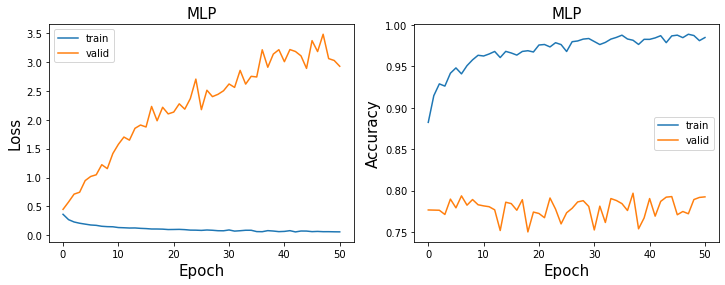

dropout:  0.3
Train loss for epoch 0: 0.3817026615142822
Val loss for epoch 0: 0.5516976714134216
Train loss for epoch 1: 0.3003365993499756
Val loss for epoch 1: 0.6244130730628967
Train loss for epoch 2: 0.26341086626052856
Val loss for epoch 2: 0.6454939246177673
Train loss for epoch 3: 0.24115626513957977
Val loss for epoch 3: 0.6820710897445679
Train loss for epoch 4: 0.2237856537103653
Val loss for epoch 4: 0.7149507403373718
Train loss for epoch 5: 0.21415618062019348
Val loss for epoch 5: 0.7691325545310974
Train loss for epoch 6: 0.20427553355693817
Val loss for epoch 6: 0.9284386038780212
Train loss for epoch 7: 0.19691160321235657
Val loss for epoch 7: 0.8829357624053955
Train loss for epoch 8: 0.18948659300804138
Val loss for epoch 8: 1.042898416519165
Train loss for epoch 9: 0.1824467033147812
Val loss for epoch 9: 1.0471549034118652
Train loss for epoch 10: 0.1777382642030716
Val loss for epoch 10: 1.197551965713501
Train loss for epoch 11: 0.17358170449733734
Val loss fo

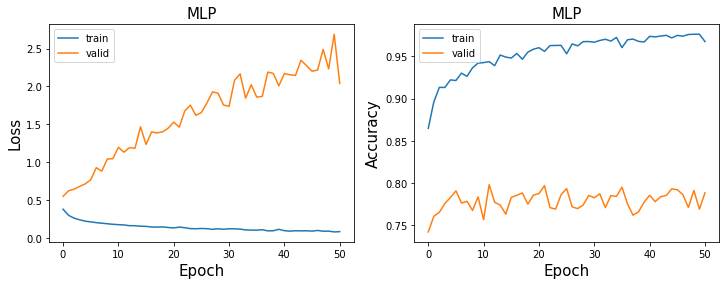

dropout:  0.5
Train loss for epoch 0: 0.40269598364830017
Val loss for epoch 0: 0.43803754448890686
Train loss for epoch 1: 0.3359766900539398
Val loss for epoch 1: 0.5210920572280884
Train loss for epoch 2: 0.304567813873291
Val loss for epoch 2: 0.5625130534172058
Train loss for epoch 3: 0.2831408381462097
Val loss for epoch 3: 0.6031302213668823
Train loss for epoch 4: 0.2668665945529938
Val loss for epoch 4: 0.6262456178665161
Train loss for epoch 5: 0.25948965549468994
Val loss for epoch 5: 0.6798833012580872
Train loss for epoch 6: 0.24462564289569855
Val loss for epoch 6: 0.7332454919815063
Train loss for epoch 7: 0.235089510679245
Val loss for epoch 7: 0.7287201881408691
Train loss for epoch 8: 0.23429200053215027
Val loss for epoch 8: 0.7607634663581848
Train loss for epoch 9: 0.2242327481508255
Val loss for epoch 9: 0.7889188528060913
Train loss for epoch 10: 0.2180330455303192
Val loss for epoch 10: 0.8529760837554932
Train loss for epoch 11: 0.2133367508649826
Val loss for 

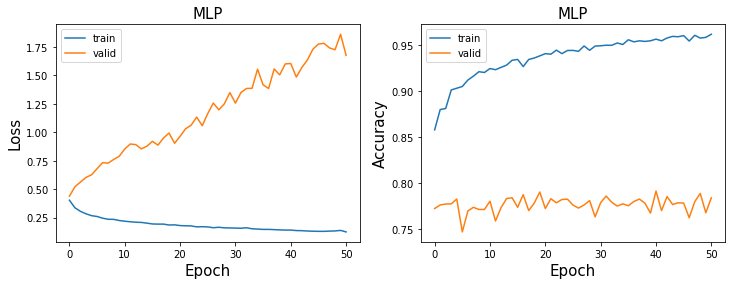

dropout:  0.7
Train loss for epoch 0: 0.4393674433231354
Val loss for epoch 0: 0.4287874102592468
Train loss for epoch 1: 0.38705405592918396
Val loss for epoch 1: 0.4102111756801605
1
Train loss for epoch 2: 0.36089029908180237
Val loss for epoch 2: 0.4693562686443329
Train loss for epoch 3: 0.33841219544410706
Val loss for epoch 3: 0.5527264475822449
Train loss for epoch 4: 0.3259444236755371
Val loss for epoch 4: 0.5322204232215881
Train loss for epoch 5: 0.31376585364341736
Val loss for epoch 5: 0.5501726865768433
Train loss for epoch 6: 0.3022715151309967
Val loss for epoch 6: 0.5857424736022949
Train loss for epoch 7: 0.2947654128074646
Val loss for epoch 7: 0.5916779041290283
Train loss for epoch 8: 0.2882041931152344
Val loss for epoch 8: 0.5886216759681702
Train loss for epoch 9: 0.2792724370956421
Val loss for epoch 9: 0.5908451676368713
Train loss for epoch 10: 0.27878111600875854
Val loss for epoch 10: 0.6287885308265686
Train loss for epoch 11: 0.27226129174232483
Val loss

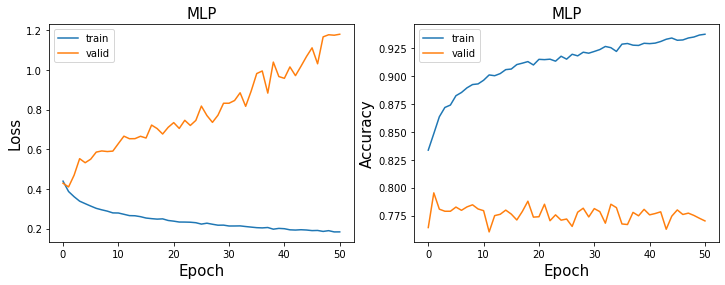

dropout:  0.9
Train loss for epoch 0: 0.5113722681999207
Val loss for epoch 0: 0.43775710463523865
Train loss for epoch 1: 0.48224765062332153
Val loss for epoch 1: 0.451106458902359
Train loss for epoch 2: 0.46898916363716125
Val loss for epoch 2: 0.48037290573120117
Train loss for epoch 3: 0.45942068099975586
Val loss for epoch 3: 0.46468386054039
Train loss for epoch 4: 0.45335379242897034
Val loss for epoch 4: 0.43281182646751404
4
Train loss for epoch 5: 0.44255194067955017
Val loss for epoch 5: 0.4890655279159546
Train loss for epoch 6: 0.4377232491970062
Val loss for epoch 6: 0.4655832052230835
Train loss for epoch 7: 0.4357636272907257
Val loss for epoch 7: 0.4611698091030121
Train loss for epoch 8: 0.42938801646232605
Val loss for epoch 8: 0.46206769347190857
Train loss for epoch 9: 0.42765292525291443
Val loss for epoch 9: 0.47371700406074524
Train loss for epoch 10: 0.419596791267395
Val loss for epoch 10: 0.46042072772979736
Train loss for epoch 11: 0.4121061861515045
Val l

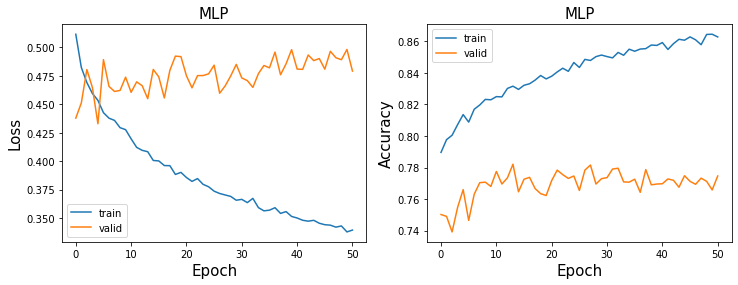

dropout:  1
Train loss for epoch 0: 0.6888052225112915
Val loss for epoch 0: 0.7763742208480835
Train loss for epoch 1: 0.6875770688056946
Val loss for epoch 1: 0.7799588441848755
Train loss for epoch 2: 0.6875749826431274
Val loss for epoch 2: 0.7809475660324097
Train loss for epoch 3: 0.6875689029693604
Val loss for epoch 3: 0.7826194167137146
Train loss for epoch 4: 0.6875717639923096
Val loss for epoch 4: 0.781544029712677
Train loss for epoch 5: 0.6875581741333008
Val loss for epoch 5: 0.7873435616493225
Train loss for epoch 6: 0.6875774264335632
Val loss for epoch 6: 0.7798424959182739
Train loss for epoch 7: 0.6875657439231873
Val loss for epoch 7: 0.7839208245277405
Train loss for epoch 8: 0.6875622868537903
Val loss for epoch 8: 0.7795954942703247
Train loss for epoch 9: 0.687570333480835
Val loss for epoch 9: 0.7870829701423645
Train loss for epoch 10: 0.6875749826431274
Val loss for epoch 10: 0.7841746211051941
Train loss for epoch 11: 0.6875723600387573
Val loss for epoch 1

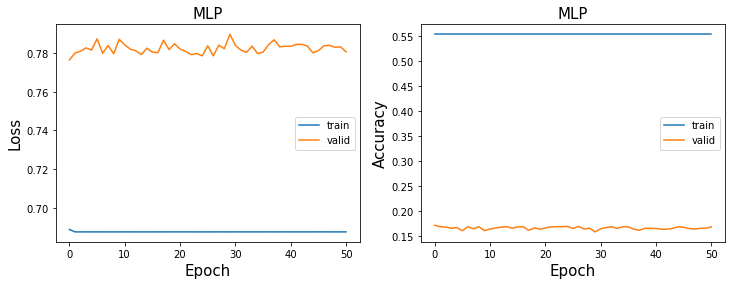

In [72]:

for d in range(0,len(dropout_all)):
    dropout = dropout_all[d]
    model = MLP(input_dim=input_dim, embed_dim=embed_dim,drop_prob = dropout).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    (data, labels, _, _, _) = next(iter(train_loader))
    data = data.to(device)
    output = model(data)
    print('dropout: ', dropout)
    output.shape

    epochs, training_losses, training_acc, val_losses, validation_acc = [], [], [], [], []

    for epoch in range(num_epochs):
        train_loss, train_acc = train(model, optimizer, train_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                      reg_type=reg_type, collect_result=False, device=device)
        print('Train loss for epoch {}: {}'.format(epoch, train_loss))
        val_loss, val_acc = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, 
                                     reg_type=reg_type, collect_result=False, device=device)
        print('Val loss for epoch {}: {}'.format(epoch, val_loss))
        if epoch == 0:
            torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))

        if val_losses:
            
            if val_loss < min(val_losses):
                best_epoch = epoch
                print(epoch)
                torch.save(model.state_dict(), '{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
                    save_path, model_type, CH, loss_type, reg_type, alpha, dropout, embed_dim, epoch,model_name))
        epochs.append(epoch)
        training_losses.append(train_loss)
        training_acc.append(train_acc)
        val_losses.append(val_loss)
        validation_acc.append(val_acc)

        if train_loss < tol:
            break
    plot_loss_acc(training_losses, val_losses, training_acc, validation_acc, model_type) # embed_dim=64

In [24]:
model_MLP = os.listdir(save_path)
results = []
for x in range(0,len(model_MLP)):
    result = model_MLP[x].split('_') 
    channel = [i for i,item in enumerate(np.array(result)) if "CH23" in item]
    if not(channel):
        continue
    else:
        model_dropout = [i for i,item in enumerate(np.array(result)) if "DO" in item]
        if not(model_dropout):
            continue
        else:
            dropout = [int(i) for i in result[model_dropout[0]] if i.isdigit()]
            if len(dropout) ==2:
                dropout = dropout[1]/10
            else:
                dropout = dropout[0]
            epoch_name = [i for i,item in enumerate(np.array(result)) if "EPOCH" in item]
            res = [int(i) for i in result[epoch_name[0]] if i.isdigit()]
            if len(res) > 1:
                epoch_result = res[0]*10+res[1]
            else:
                epoch_result = res[0]
            results.append([dropout, epoch_result])

results = pd.DataFrame(np.array(results), columns=['dropout', 'epoch'])
best_results = results.groupby('dropout').max('epoch')
print(best_results)

         epoch
dropout       
0.1        0.0
0.3        0.0
0.5        0.0
0.7        1.0
0.9        4.0
1.0        0.0


/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.1_EPOCH0.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


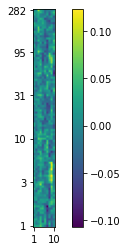

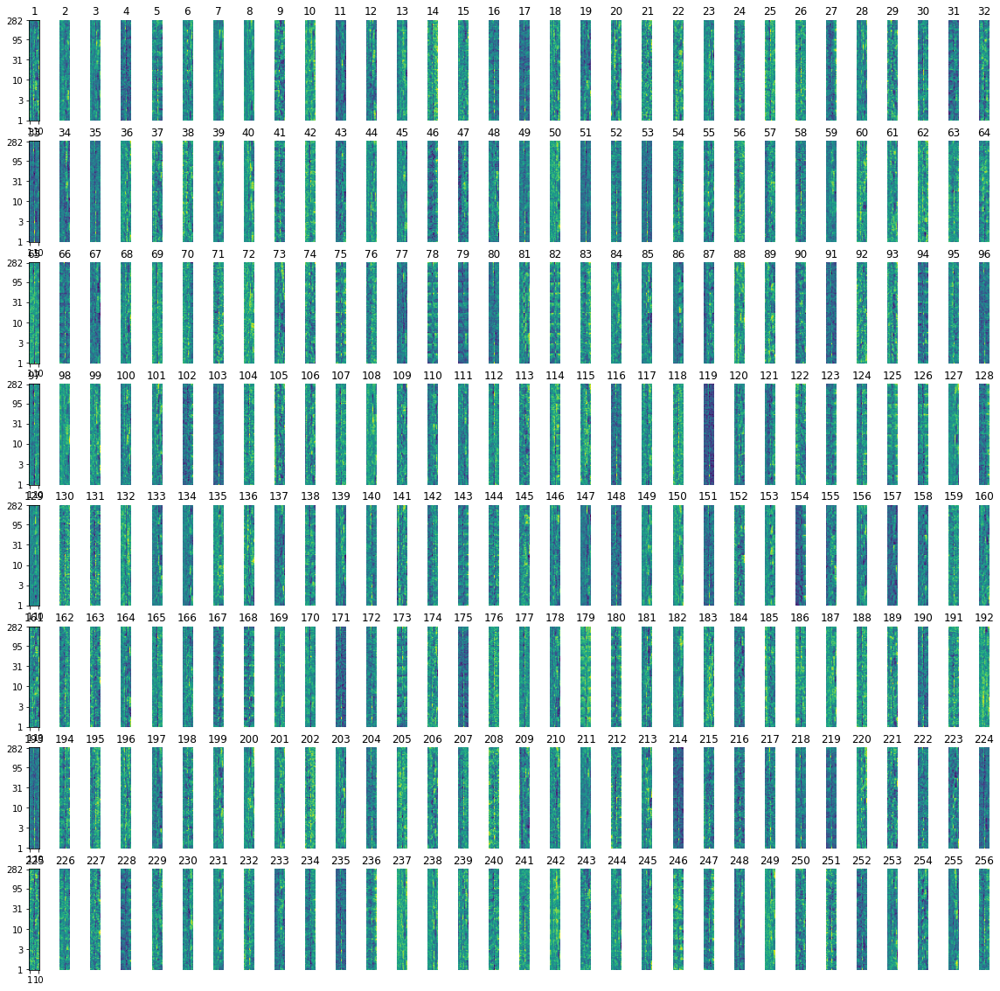

validation loss:0.4477832317352295 accuracy:0.7766463000678887
test loss:0.33345717191696167 accuracy:0.8550174105729661
0.82114595


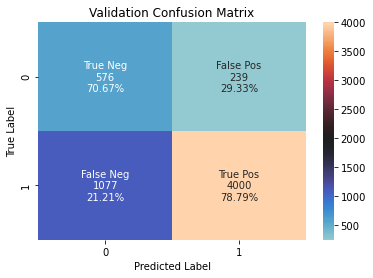

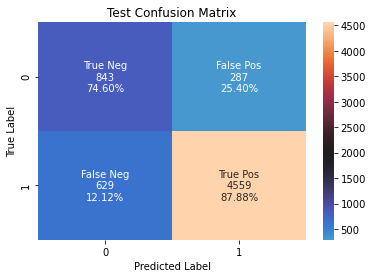

val loss:0.4477832317352295, val accuracy:0.7766463000678887, val percentage postive:0.8616768717765808
/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.3_EPOCH0.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


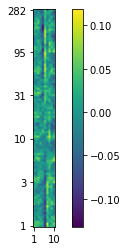

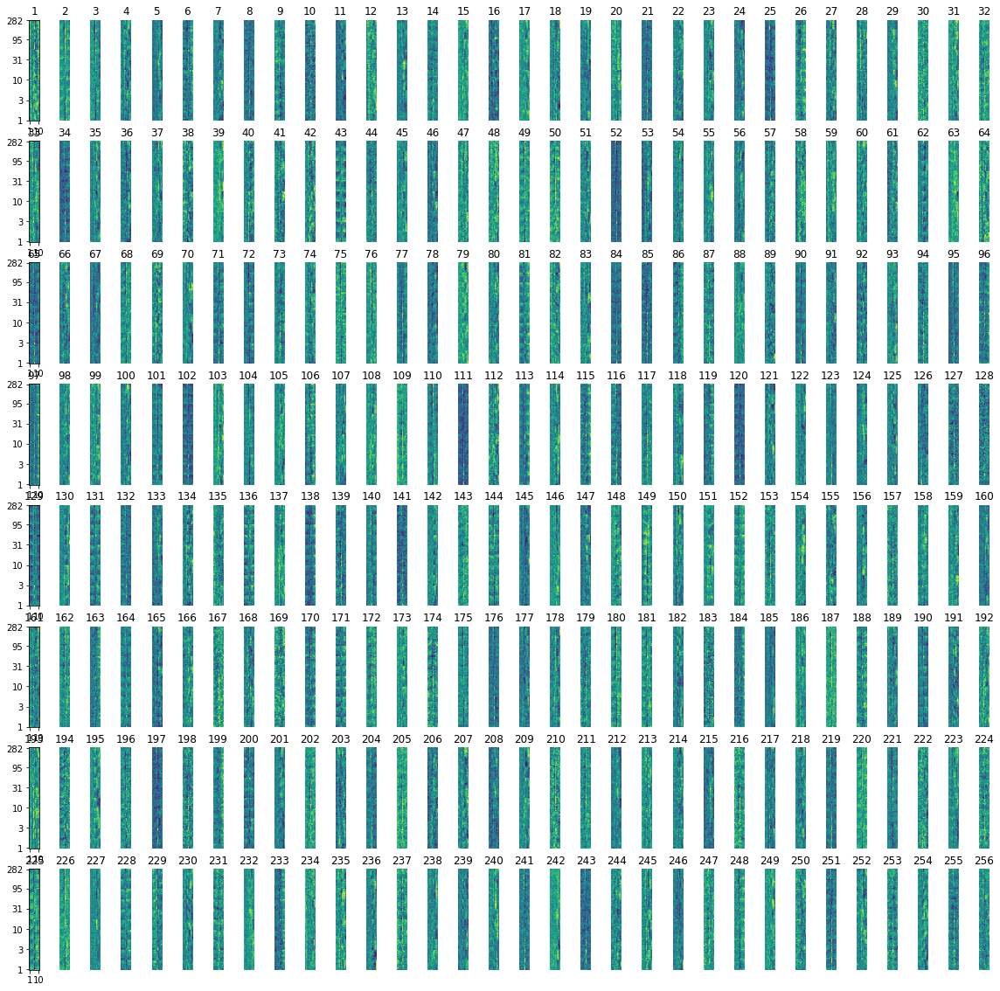

validation loss:0.5516976118087769 accuracy:0.7418533604887984
test loss:0.4065946042537689 accuracy:0.8137068692624249
0.82114595


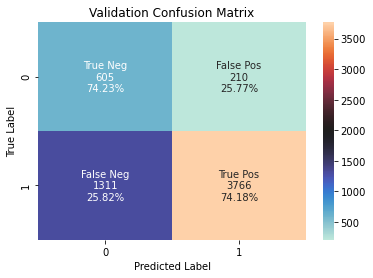

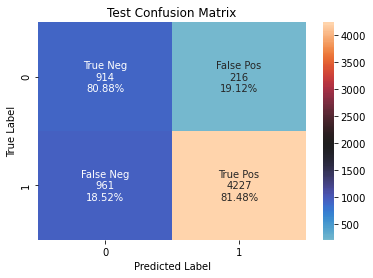

val loss:0.5516976118087769, val accuracy:0.7418533604887984, val percentage postive:0.8616768717765808
/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.5_EPOCH0.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


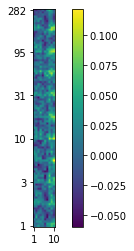

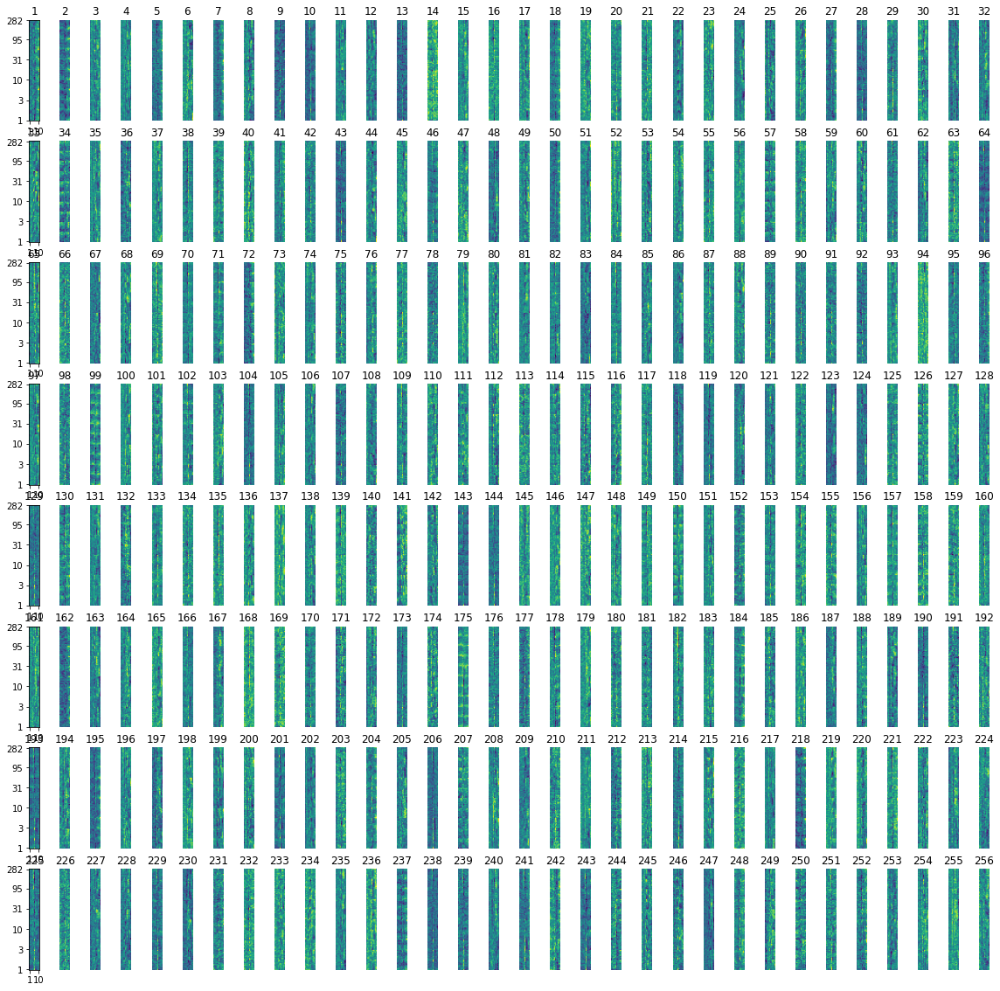

validation loss:0.43803754448890686 accuracy:0.7722335369993211
test loss:0.3616824746131897 accuracy:0.8360240582462805
0.82114595


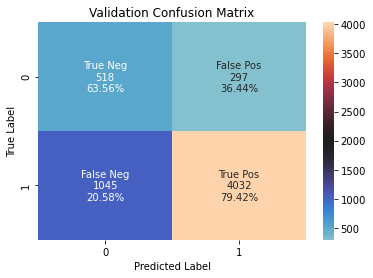

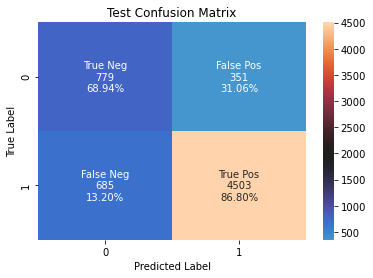

val loss:0.43803754448890686, val accuracy:0.7722335369993211, val percentage postive:0.8616768717765808
/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.7_EPOCH1.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


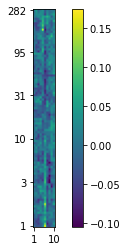

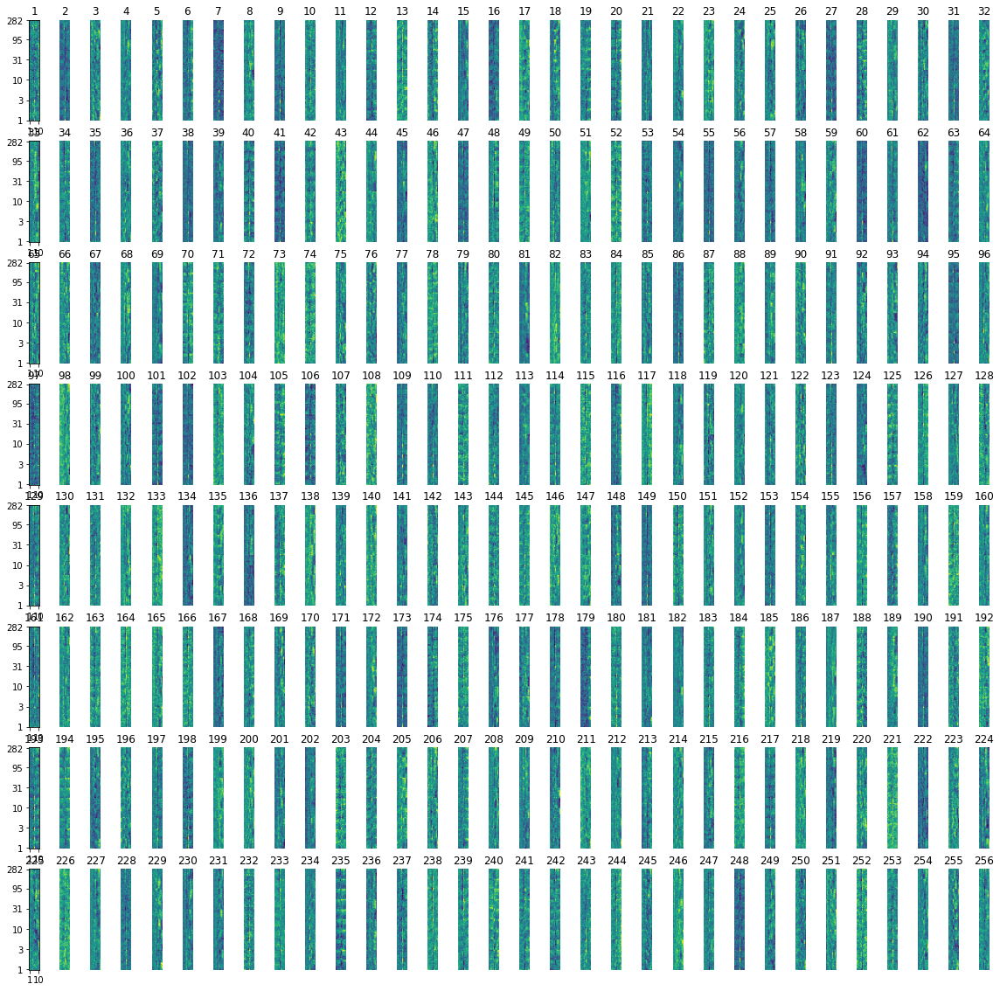

validation loss:0.4102111756801605 accuracy:0.7953156822810591
test loss:0.32137200236320496 accuracy:0.8535929091484648
0.82114595


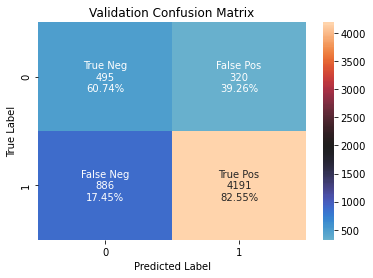

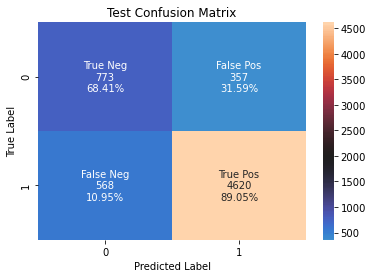

val loss:0.4102111756801605, val accuracy:0.7953156822810591, val percentage postive:0.8616768717765808
/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.9_EPOCH4.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


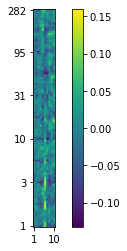

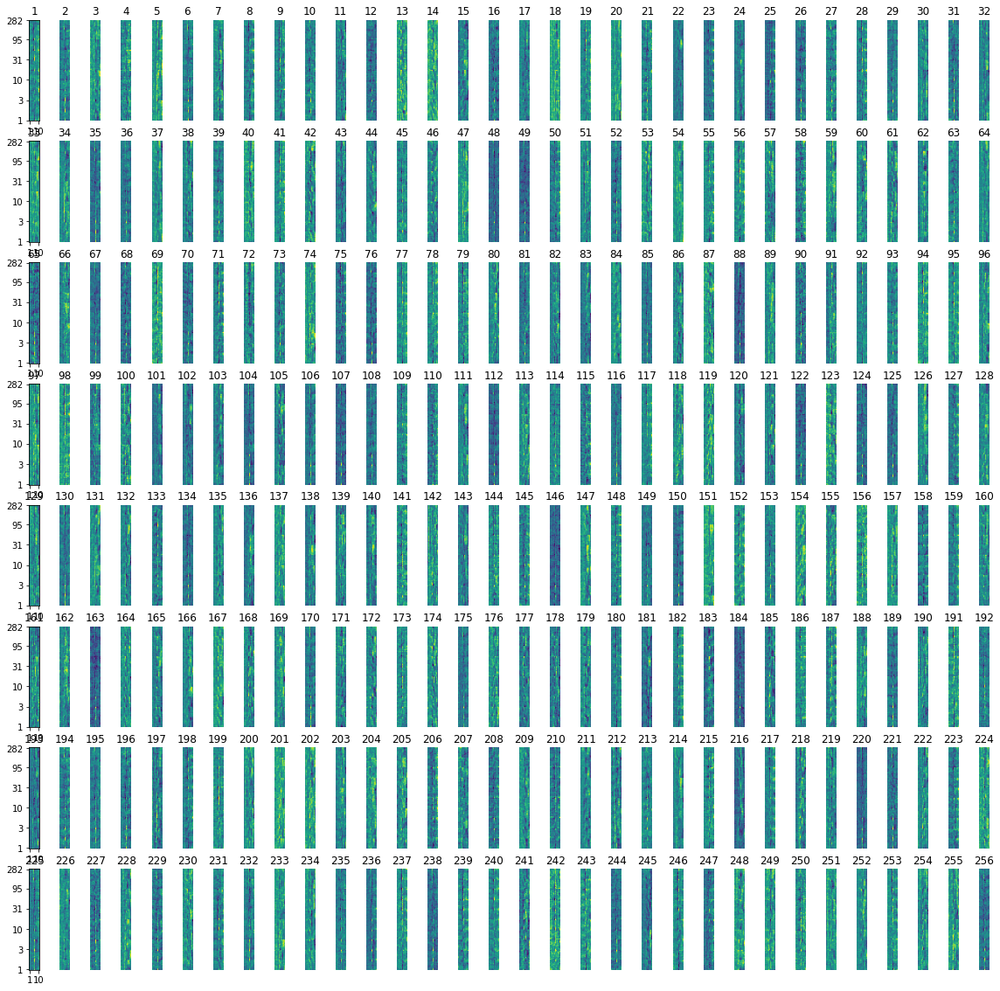

validation loss:0.4328117072582245 accuracy:0.7659538357094365
test loss:0.3942239284515381 accuracy:0.7961380183602406
0.82114595


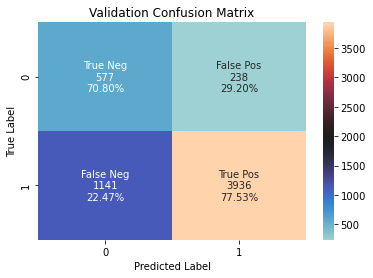

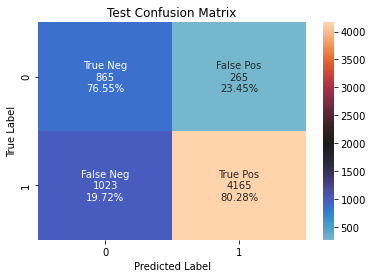

val loss:0.4328117072582245, val accuracy:0.7659538357094365, val percentage postive:0.8616768717765808
/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO1_EPOCH0.pt
torch.Size([256, 10, 100]) torch.Size([1, 256])
One feature


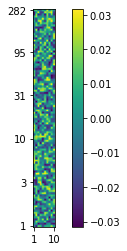

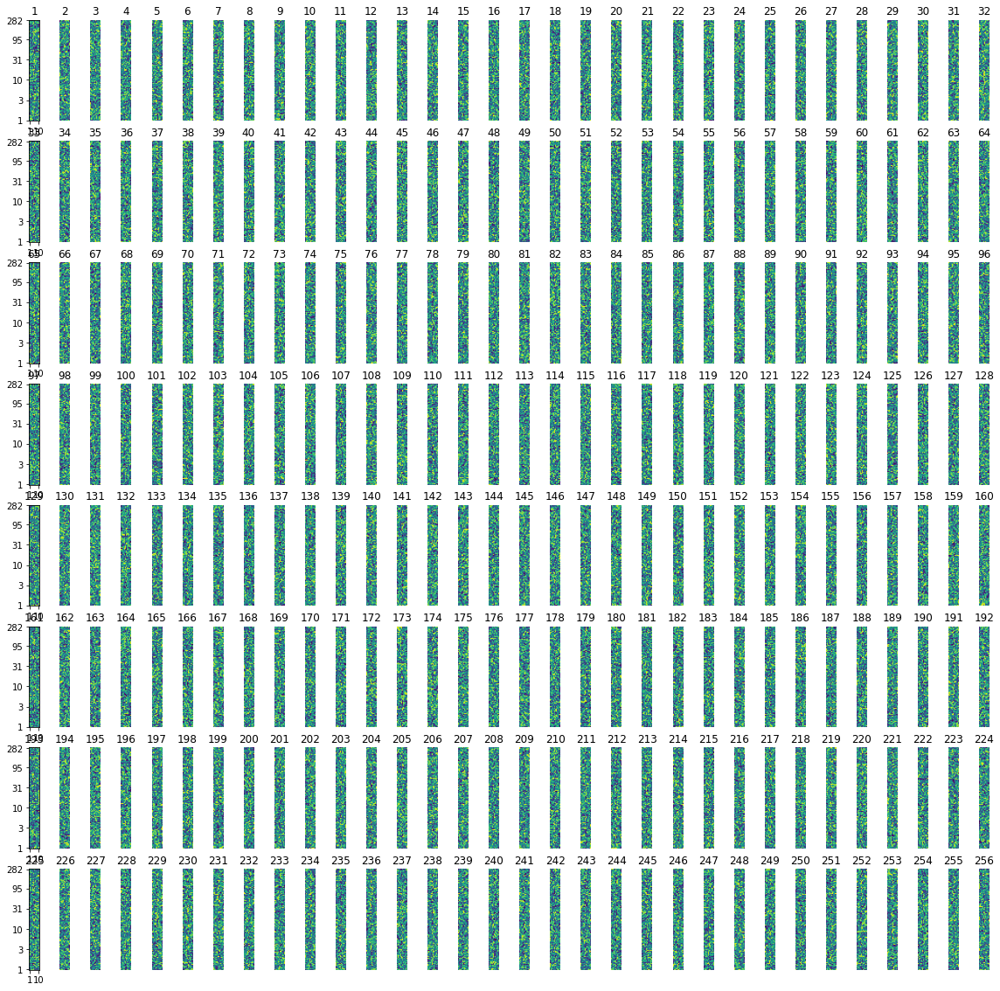

validation loss:0.7763742804527283 accuracy:0.1710794297352342
test loss:0.7799507975578308 accuracy:0.20686926242481798
0.82114595


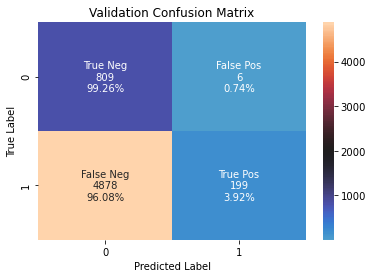

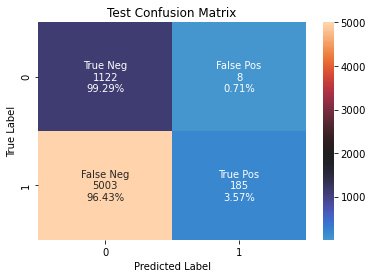

val loss:0.7763742804527283, val accuracy:0.1710794297352342, val percentage postive:0.8616768717765808


In [25]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    
    # Print Shape
    w1 = model.linear1.weight.view(256,10,100)
    w2 = model.linear2.weight
    print(w1.shape, w2.shape)
    w1 = w1.detach().cpu().numpy()
    w2 = w2.detach().cpu().numpy()
    w1[0].shape
    type(w1)
    
    # Print one feature
    print('One feature')
    plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
    plt.xticks(ticks=[0, 9], labels=[1, 10])
    plt.imshow(w1[1].transpose(),origin='lower')
    # plt.clim(-1.5, 1.5)
    plt.colorbar()
    plt.show()
    
    # All features
    timewindow = 10
    plt.figure(figsize=(20,20))
    ylabels_list = [0,32,64,96,128,160,192,224,256] 
    for i in range(256):
        weights_sub = w1[i]
        plt.subplot(8,32,i+1)
        if i in ylabels_list:
            plt.yticks(ticks=[0, 20, 40, 60, 80, 99], labels=[round(np.logspace(0, 2.45, 100)[i]) for i in [0, 20, 40, 60, 80, 99]])
            plt.xticks(ticks=[0, timewindow-1], labels=[1, timewindow])
        else:
            plt.axis('off')
    #     plt.imshow(weights_sub)
        plt.imshow(w1[i].transpose(),origin='lower')
        plt.title(str(i+1))
    plt.show()
    
    
    ## Calculate accuracy and validation loss
    val_loss, val_acc, val_preds, val_preds_probs, val_labels,_,_,_, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('validation loss:{} accuracy:{}'.format(val_loss, val_acc))

    ## Calculate test accuracy and test loss
    test_loss, test_acc, test_preds, test_preds_probs, test_labels,_,_,_, cases_wrong_2 = evaluate(model, optimizer, test_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('test loss:{} accuracy:{}'.format(test_loss, test_acc))
    print(np.mean(np.concatenate(test_labels)))
    
    ## Confusion matrix - Validation
    predictions_val = np.concatenate(val_preds)
    labels_val = np.concatenate(val_labels)

    df_val = pd.DataFrame({'predictions': predictions_val, 'labels': labels_val})

    cm_val = confusion_matrix(labels_val, predictions_val)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_val.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_val, annot=labels, fmt='', center = 2000)
    ax.set_title('Validation Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Confusion matrix-test
    predictions_test = np.concatenate(test_preds)
    labels_test = np.concatenate(test_labels)

    df_test = pd.DataFrame({'predictions': predictions_test, 'labels': labels_test})

    cm_test = confusion_matrix(labels_test, predictions_test)
    ax = plt.axes()
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm_test.flatten()]

    TNR = int(group_counts[0]) / (int(group_counts[0])+int(group_counts[1]))
    FPR = 1 - TNR
    TPR = int(group_counts[3]) / (int(group_counts[3])+int(group_counts[2]))
    FNR = 1-TPR
    group_percentages =[TNR, FPR, FNR, TPR]

    group_percentages = ["{0:.2%}".format(value) for value in
                         group_percentages]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sn.heatmap(cm_test, annot=labels, fmt='', center = 2000)
    ax.set_title('Test Confusion Matrix')
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.show()
    
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='180409')

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.1_EPOCH0.pt
val loss:0.4477831721305847, val accuracy:0.7766463000678887, val percentage postive:0.8616768717765808


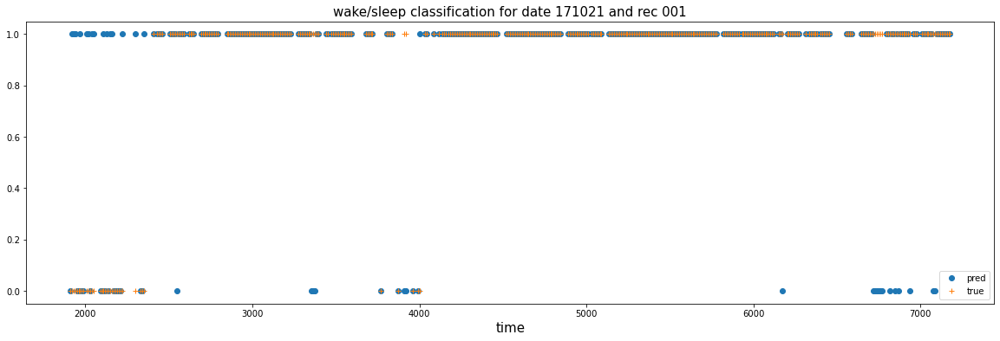

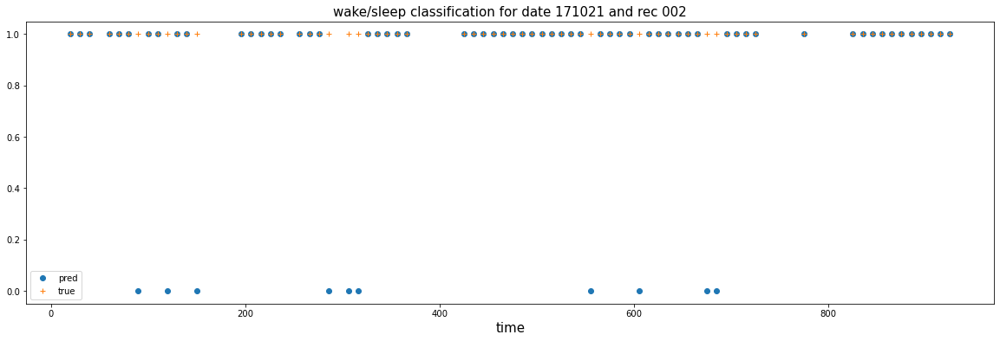

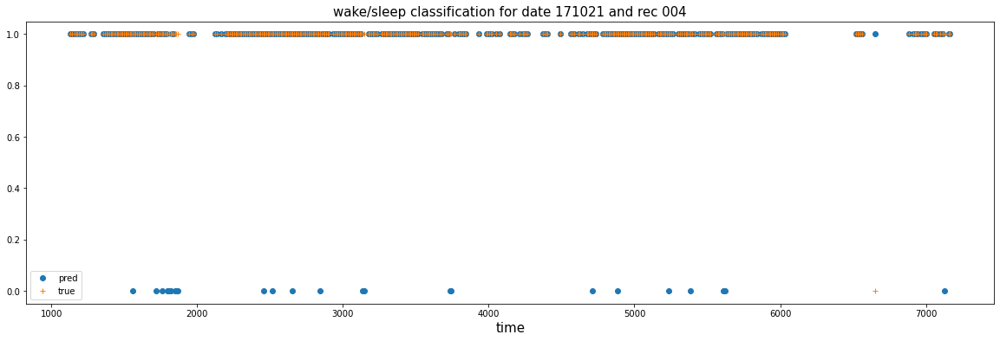

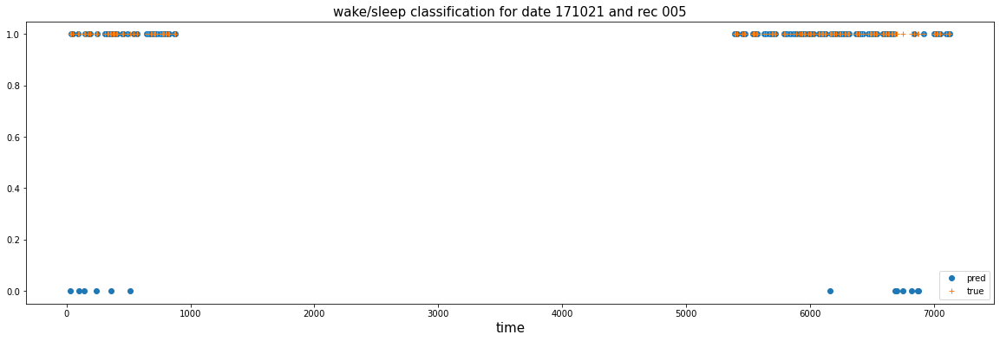

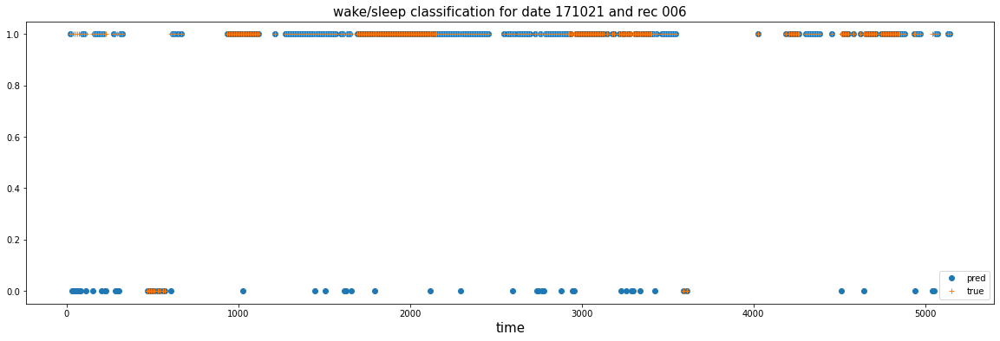

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.3_EPOCH0.pt
val loss:0.5516976714134216, val accuracy:0.7418533604887984, val percentage postive:0.8616768717765808


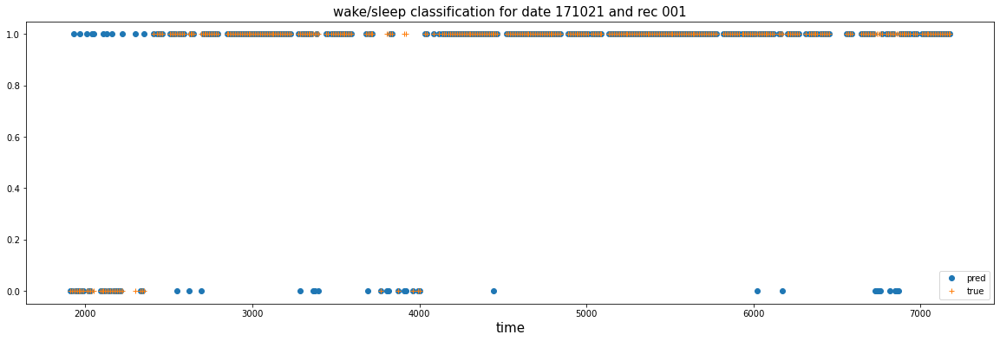

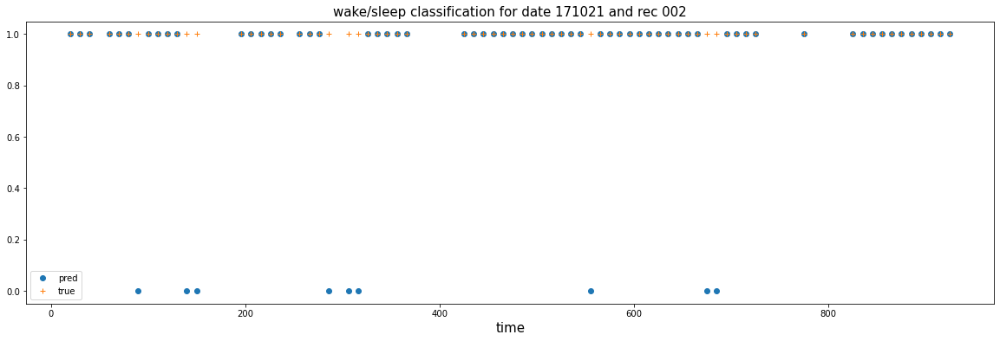

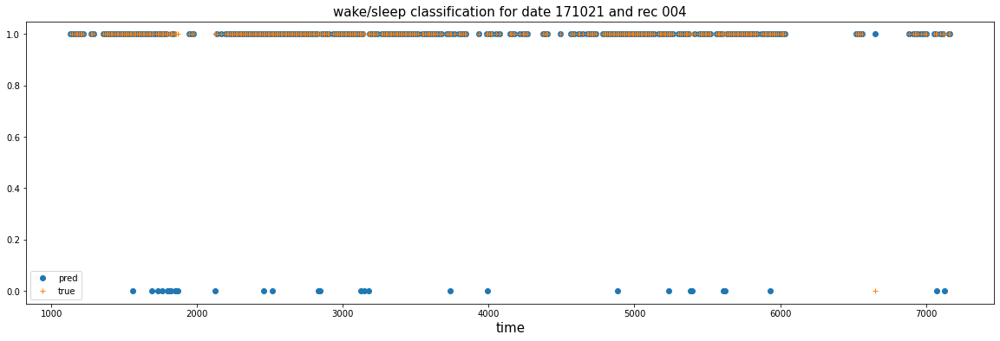

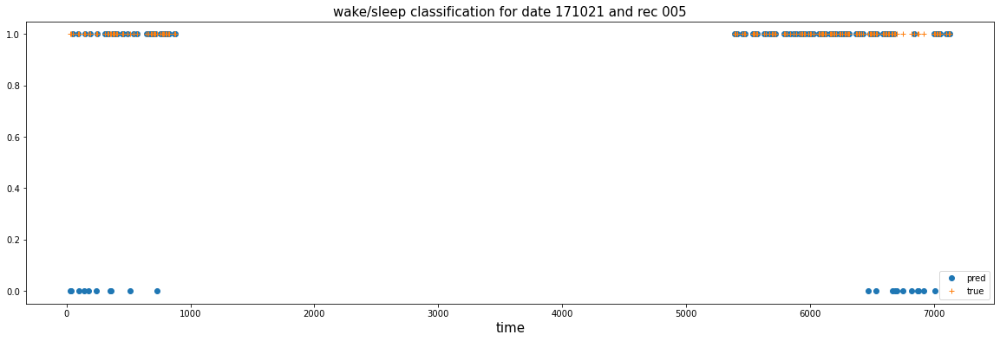

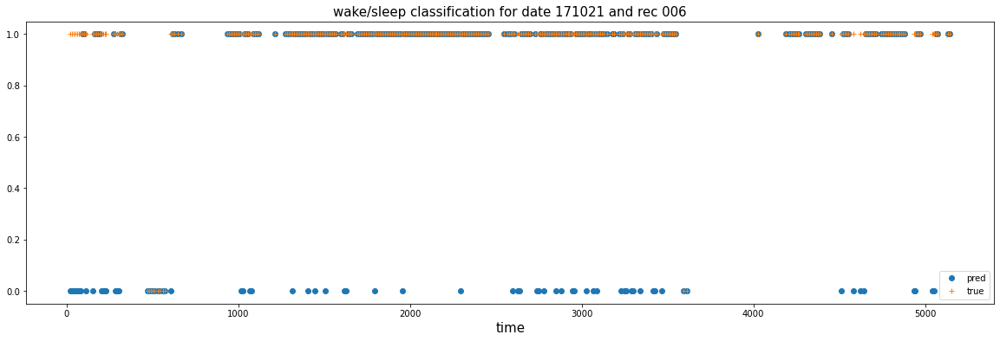

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.5_EPOCH0.pt
val loss:0.43803754448890686, val accuracy:0.7722335369993211, val percentage postive:0.8616768717765808


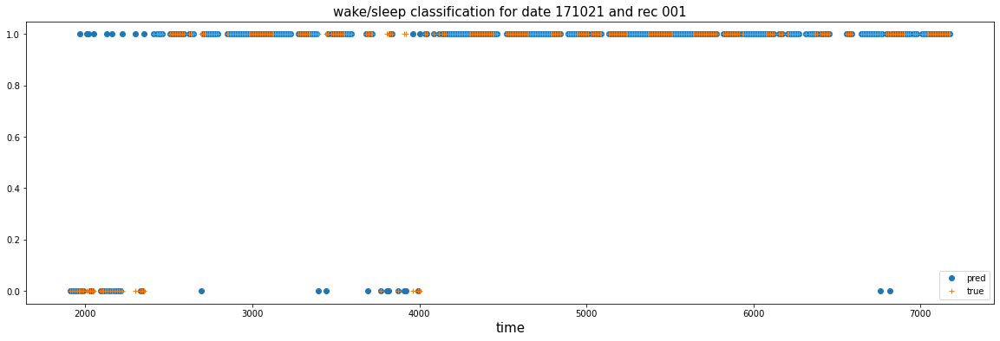

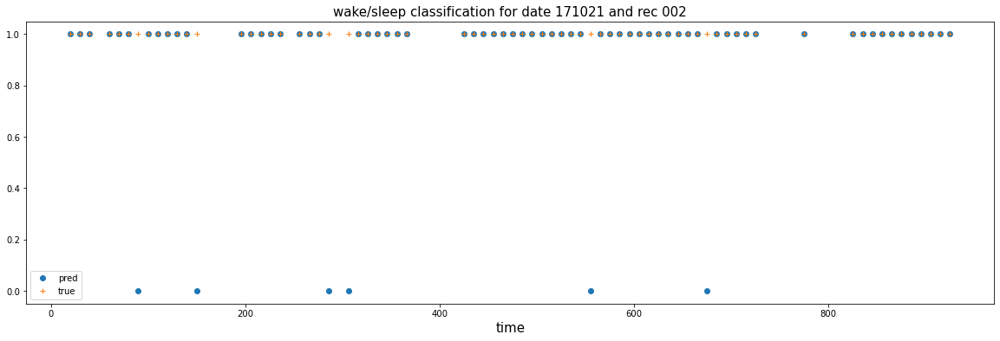

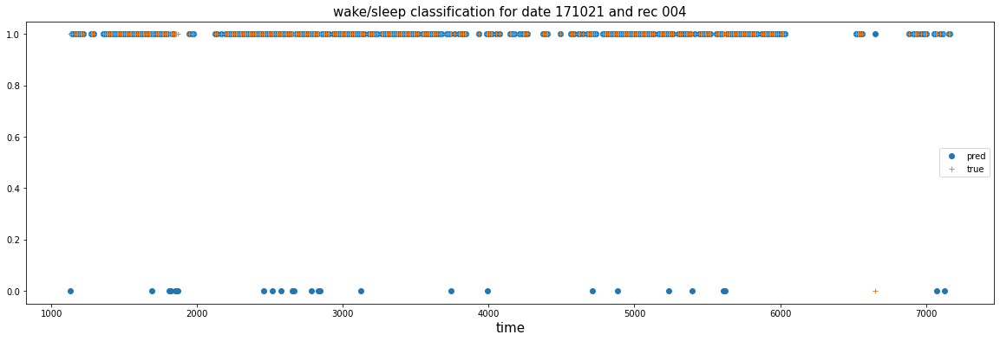

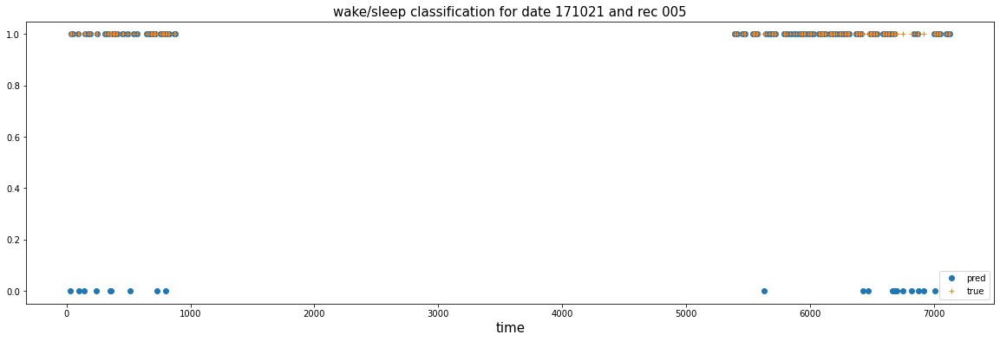

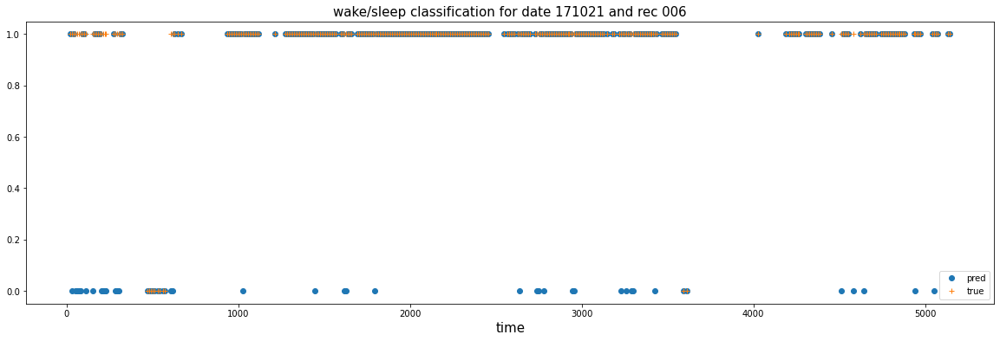

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.7_EPOCH1.pt
val loss:0.4102111756801605, val accuracy:0.7953156822810591, val percentage postive:0.8616768717765808


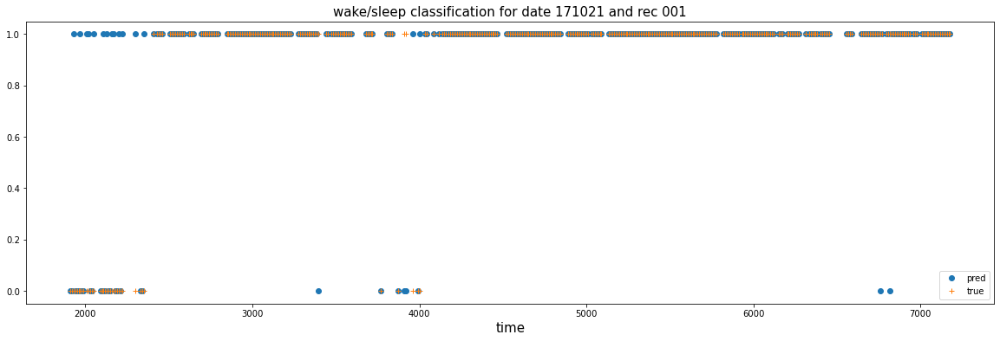

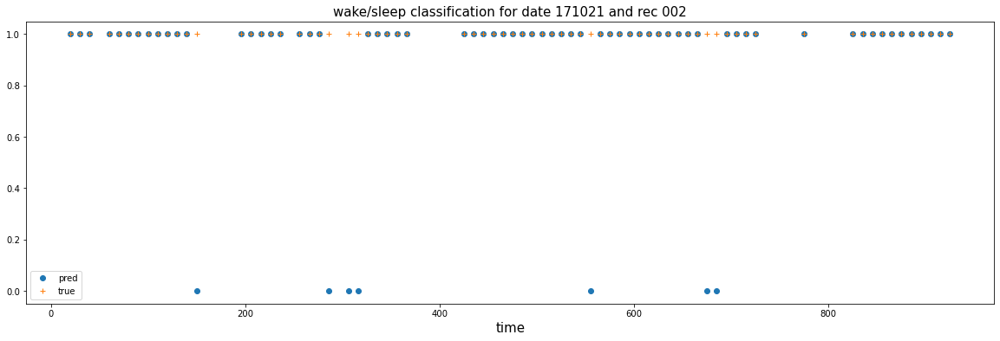

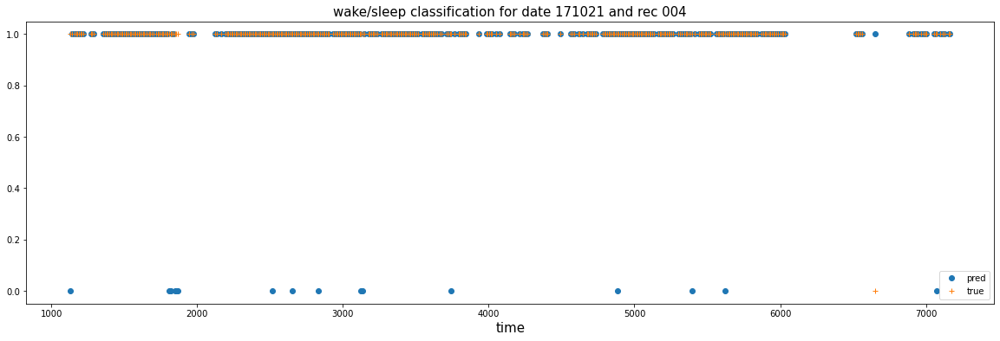

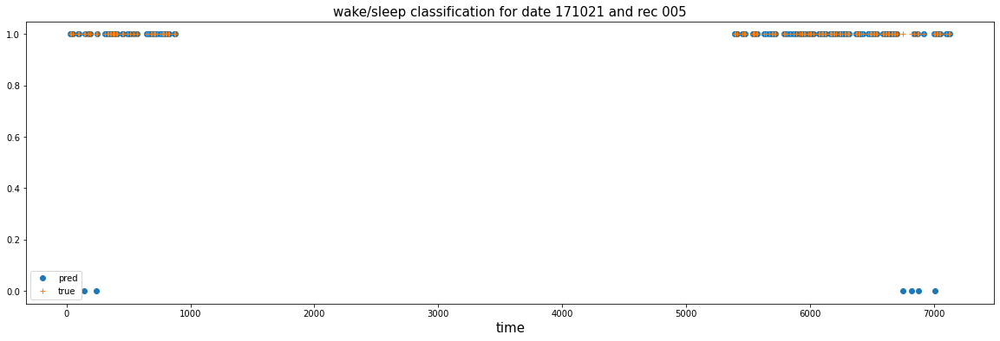

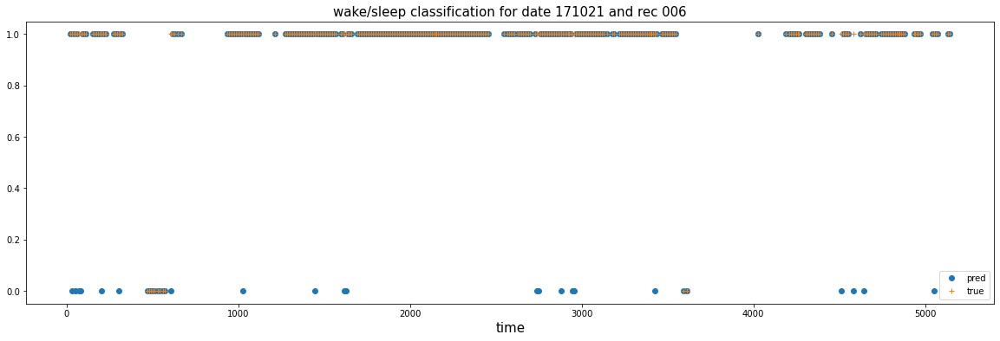

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO0.9_EPOCH4.pt
val loss:0.43281182646751404, val accuracy:0.7659538357094365, val percentage postive:0.8616768717765808


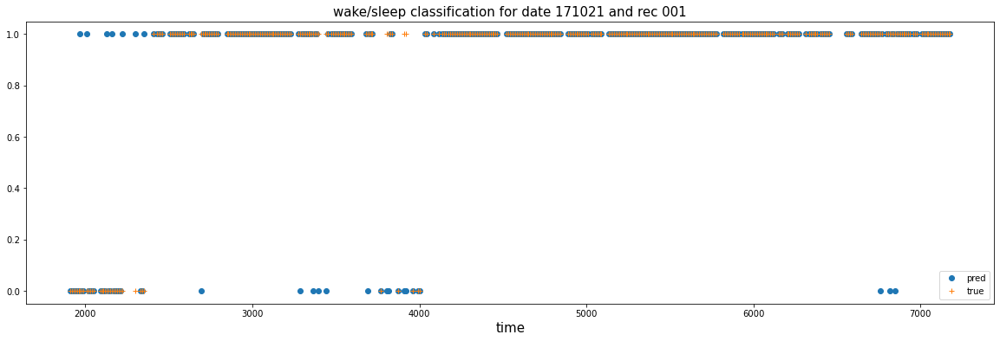

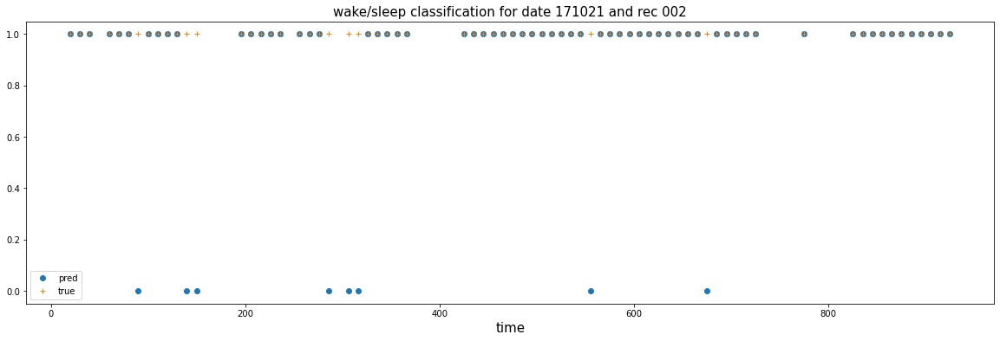

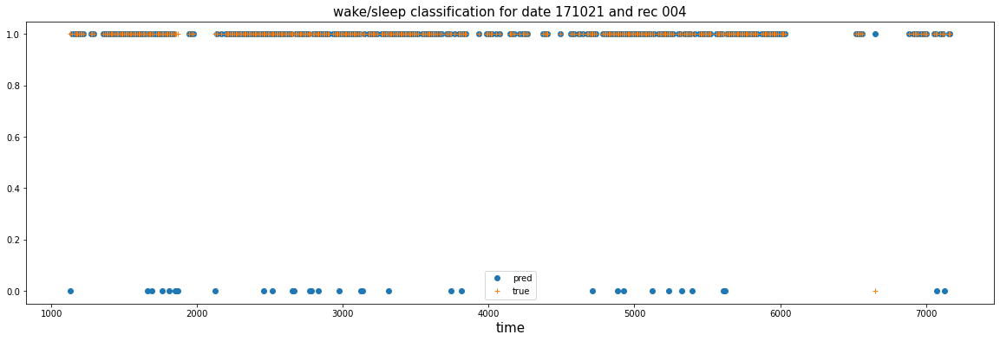

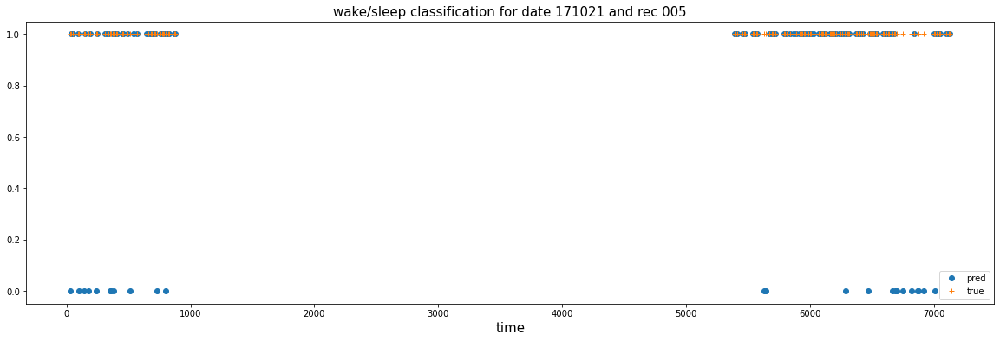

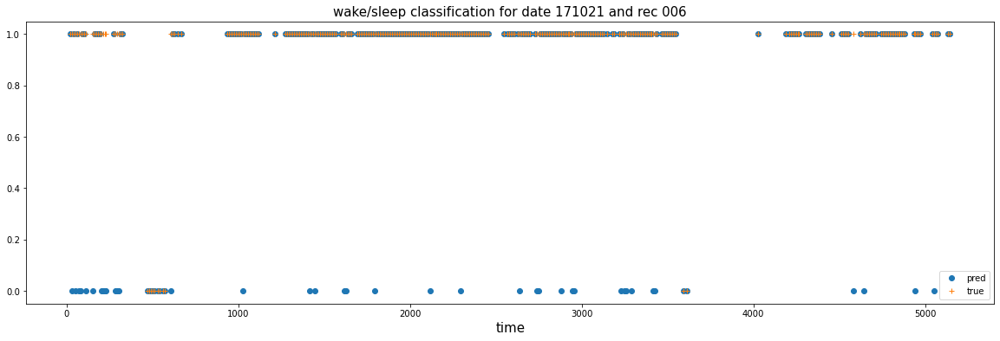

/home/bijanadmin/Desktop/Goose_and_Jester_data/data_Goose_all_Jester_all_2/ANN_model/MLP_CH23_LOSSbce_REGnone0_DO1_EPOCH0.pt
val loss:0.7763742208480835, val accuracy:0.1710794297352342, val percentage postive:0.8616768717765808


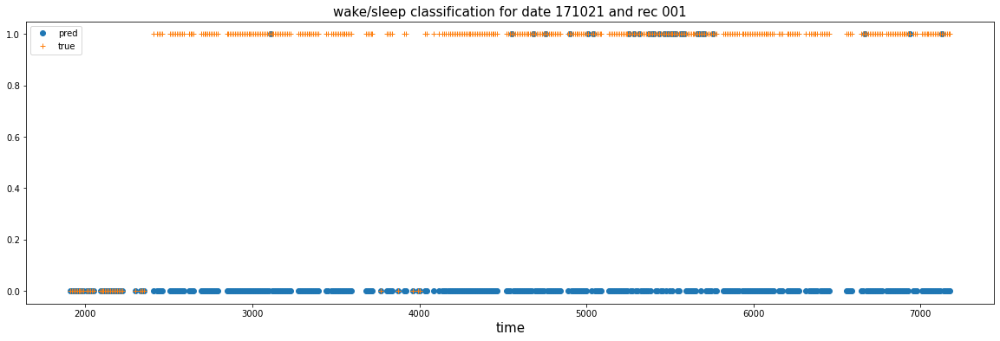

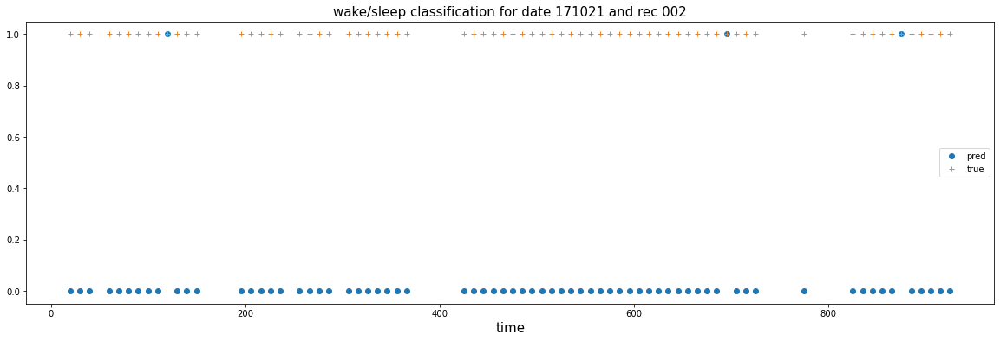

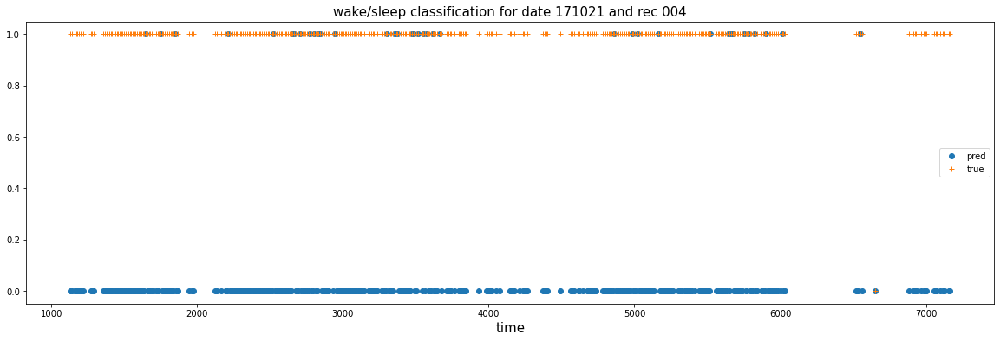

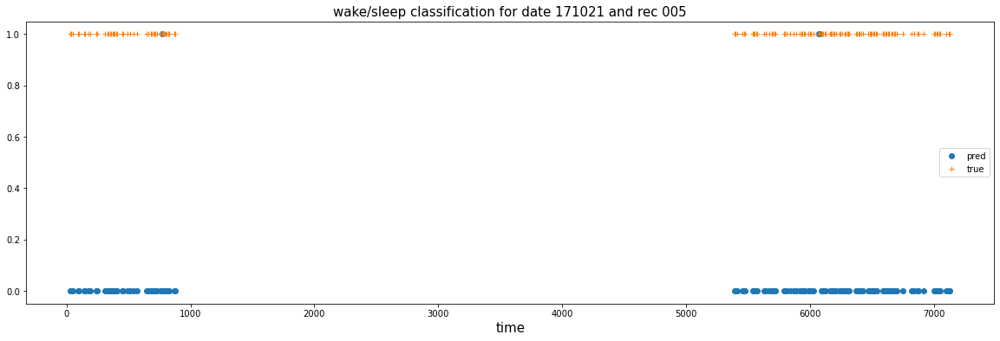

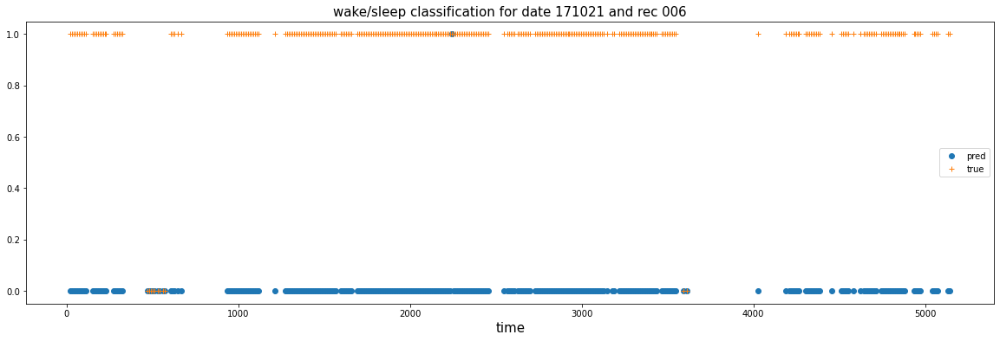

In [24]:
for i,(index,row) in enumerate(best_results.iterrows()):
    model = MLP().to(device)
    path = save_path
    if index == 1.0:
        index = 1
    DO = index
    best_epoch = int(row)
    ## Load best model
    model = MLP(input_dim=input_dim, embed_dim=embed_dim).to(device)
    model.load_state_dict(torch.load('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EMBED{}_EPOCH{}_MODEL_{}.pt'.format(
    save_path, model_type, CH, loss_type, reg_type, alpha, DO, embed_dim, best_epoch,model_name)))
    print('{}/{}_CH{}_LOSS{}_REG{}{}_DO{}_EPOCH{}.pt'.format(path, model_type, CH, loss_type, reg_type, alpha,DO, best_epoch))
    ## Predict vs truth
    val_loss, val_acc, val_preds, val_preds_probs, val_labels, val_dates, val_recs, val_times, cases_wrong_0 = evaluate(model, optimizer, val_loader, alpha=alpha, model_type=model_type, loss_type=loss_type, reg_type=reg_type, collect_result=True, device=device)
    print('val loss:{}, val accuracy:{}, val percentage postive:{}'.format(val_loss, val_acc, np.mean(np.concatenate(val_labels))))
    plot_pred_vs_true(val_preds, val_labels, val_dates, val_recs, val_times, date_1='171021')